In [1]:
from __future__ import print_function
%matplotlib inline
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
from torch.autograd import Variable
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import tensorflow as tf
from IPython.display import HTML

# Взводим руками рандом сид для воспроизводимости обучения
manualSeed = 333
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)

Random Seed:  333


In [2]:
# Директория с датасетом покемонов. Внимание!!! Чтобы даталоадер работал, необходимо положить картинки в 
# папку по типу .../pokemon/1/0.png, .../pokemon/1/1.png и т.д. Без этого даталоадер работать не будет
dataroot = "./pokemon/"

# Количество воркеров для даталоадера
workers = 1

# Размер батча для обучения
batch_size = 64
image_size = 64
ngf = 64
nc = 3
ndf = 64

# Размер скрытого вектора z
nz = 100

# Кол-во эпох обучения
num_epochs = 1000

Current device : cuda:0


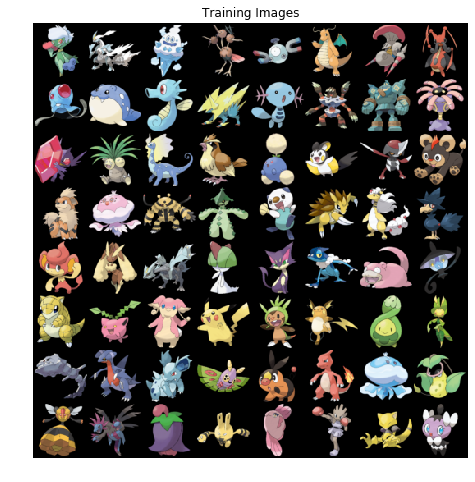

In [3]:
# Создаем даталоадер
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))

dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

# переключаемся на куду
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

print("Current device : {}".format(device))

# Выведем трейнсет, дабы убедиться, что все завелось
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

In [4]:
# функция для инициализации весов из статьи про GAN
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [5]:
# Генератор

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
        )
        pass

    def forward(self, input):
        return self.main(input)

In [6]:
# Создали генератор
netG = Generator().to(device)

# Инициализировали его
netG.apply(weights_init)

# Вывели модель для отладки
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


In [7]:
# Дискриминатор
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.main = nn.Sequential(
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
        )

    def forward(self, input):
        return self.main(input)

In [8]:
# Создали дискриминатор
netD = Discriminator().to(device)

# Ининциализировали весе
netD.apply(weights_init)

# Вывели модель для отладки
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
  )
)


In [9]:
# Фиксированный шум для мониторинга качества генерации
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Коэффициент обучения
lr = 0.00005

# Оптимизаторы для сеток
optimizerD = optim.RMSprop(netD.parameters(), lr=lr)
optimizerG = optim.RMSprop(netG.parameters(), lr=lr)

In [10]:
# код для обучения дискриминатора
def train_D(discriminator, images, fake_images):
    discriminator.zero_grad()

    real_output = discriminator(images)
    fake_output = discriminator(fake_images)
        
    loss = -torch.mean(real_output) + torch.mean(fake_output)
    loss.backward()
    optimizerD.step()
    
    real_score = discriminator(images).view(-1)
    fake_score = discriminator(fake_images.detach()).view(-1)
    
    for p in discriminator.parameters():
            p.data.clamp_(-0.01, 0.01)
            
    return loss , real_score, fake_score

In [11]:
# код для обучения генератора
def train_G(generator, discriminator, fake_images):
    generator.zero_grad()

    fake_output = discriminator(fake_images)
        
    loss = - torch.mean(fake_output)
    loss.backward()
    optimizerG.step()
    
    return loss

In [12]:
def generate_fake(generator):
    noise = torch.randn(batch_size, nz, 1, 1, device=device)
    fake_images = generator(noise)
    return fake_images

In [14]:
# Training Loop
input = torch.FloatTensor(batch_size, nc, image_size, image_size).cuda()
# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

d_episodes = 5

print("Starting Training Loop...")
for epoch in range(num_epochs):
    
    data_iter = iter(dataloader)
    i = 0
    
    while i < len(dataloader):
       
        # обучаем дискриминатор
        # d_loss = wasserstein loss дискриминатора
        # real_score - оценки дискриминатора для настоящих картинок
        # fake_score - оценки дискриминатора для фейковых картинок
        # помните, что на одну итерацию обучения генератора
        # должно приходиться несколько итераций обучения дискриминатора!

        # обучаем генератор
        # g_loss = critic-loss генератора
        data = next(data_iter)
        images = data[0].to(device)
        
        for n in range(d_episodes):
            fake_images = generate_fake(netG)
            d_loss, real_score, fake_score = train_D(netD, images, fake_images)

        fake_images = generate_fake(netG)
        g_loss = train_G(netG, netD, fake_images)    
        
        # Выводим стату
        if i % 1 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     d_loss.item(), g_loss.item(), real_score.mean().item(), fake_score.mean().item()))

        # Save Losses for plotting later
        G_losses.append(g_loss.item())
        D_losses.append(d_loss.item())

        # Сохраняем результат генерации для нашего фиксированного шума( для валидации )
        if (iters % 50 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))
        
        i += 1
        iters += 1

Starting Training Loop...
[0/1000][0/13]	Loss_D: -0.1031	Loss_G: 0.0273	D(x): 0.0858	D(G(z)): -0.0295
[0/1000][1/13]	Loss_D: -0.1105	Loss_G: 0.0350	D(x): 0.0866	D(G(z)): -0.0367
[0/1000][2/13]	Loss_D: -0.1255	Loss_G: 0.0576	D(x): 0.0766	D(G(z)): -0.0626
[0/1000][3/13]	Loss_D: -0.1404	Loss_G: 0.0443	D(x): 0.1077	D(G(z)): -0.0454
[0/1000][4/13]	Loss_D: -0.1494	Loss_G: 0.0843	D(x): 0.0752	D(G(z)): -0.0901
[0/1000][5/13]	Loss_D: -0.1650	Loss_G: 0.0627	D(x): 0.1139	D(G(z)): -0.0636
[0/1000][6/13]	Loss_D: -0.1720	Loss_G: 0.1152	D(x): 0.0698	D(G(z)): -0.1220
[0/1000][7/13]	Loss_D: -0.2034	Loss_G: 0.0781	D(x): 0.1382	D(G(z)): -0.0772
[0/1000][8/13]	Loss_D: -0.2040	Loss_G: 0.1482	D(x): 0.0662	D(G(z)): -0.1568
[0/1000][9/13]	Loss_D: -0.2352	Loss_G: 0.0966	D(x): 0.1527	D(G(z)): -0.0926
[0/1000][10/13]	Loss_D: -0.2393	Loss_G: 0.1804	D(x): 0.0641	D(G(z)): -0.1875
[0/1000][11/13]	Loss_D: -0.2749	Loss_G: 0.1141	D(x): 0.1736	D(G(z)): -0.1162
[0/1000][12/13]	Loss_D: -0.2813	Loss_G: 0.2017	D(x): 0.0927	

[8/1000][4/13]	Loss_D: -1.2874	Loss_G: 0.6331	D(x): 0.6479	D(G(z)): -0.6381
[8/1000][5/13]	Loss_D: -1.2993	Loss_G: 0.6511	D(x): 0.6578	D(G(z)): -0.6576
[8/1000][6/13]	Loss_D: -1.2848	Loss_G: 0.6449	D(x): 0.6418	D(G(z)): -0.6556
[8/1000][7/13]	Loss_D: -1.3213	Loss_G: 0.6588	D(x): 0.6709	D(G(z)): -0.6670
[8/1000][8/13]	Loss_D: -1.3118	Loss_G: 0.6492	D(x): 0.6648	D(G(z)): -0.6545
[8/1000][9/13]	Loss_D: -1.2616	Loss_G: 0.6198	D(x): 0.6575	D(G(z)): -0.6243
[8/1000][10/13]	Loss_D: -1.2977	Loss_G: 0.6570	D(x): 0.6670	D(G(z)): -0.6633
[8/1000][11/13]	Loss_D: -1.3090	Loss_G: 0.6637	D(x): 0.6594	D(G(z)): -0.6685
[8/1000][12/13]	Loss_D: -1.3288	Loss_G: 0.6607	D(x): 0.6747	D(G(z)): -0.6700
[9/1000][0/13]	Loss_D: -1.3315	Loss_G: 0.6619	D(x): 0.6788	D(G(z)): -0.6731
[9/1000][1/13]	Loss_D: -1.2706	Loss_G: 0.6375	D(x): 0.5960	D(G(z)): -0.6411
[9/1000][2/13]	Loss_D: -1.3542	Loss_G: 0.6760	D(x): 0.6880	D(G(z)): -0.6815
[9/1000][3/13]	Loss_D: -1.3108	Loss_G: 0.6412	D(x): 0.6777	D(G(z)): -0.6457
[9/1000][

[16/1000][7/13]	Loss_D: -1.3868	Loss_G: 0.6930	D(x): 0.6980	D(G(z)): -0.7019
[16/1000][8/13]	Loss_D: -1.3438	Loss_G: 0.6772	D(x): 0.6842	D(G(z)): -0.6838
[16/1000][9/13]	Loss_D: -1.3417	Loss_G: 0.6993	D(x): 0.6613	D(G(z)): -0.7028
[16/1000][10/13]	Loss_D: -1.3708	Loss_G: 0.6845	D(x): 0.6941	D(G(z)): -0.6891
[16/1000][11/13]	Loss_D: -1.3593	Loss_G: 0.6901	D(x): 0.6770	D(G(z)): -0.6984
[16/1000][12/13]	Loss_D: -1.3692	Loss_G: 0.6927	D(x): 0.6842	D(G(z)): -0.6989
[17/1000][0/13]	Loss_D: -1.3791	Loss_G: 0.6984	D(x): 0.6934	D(G(z)): -0.6997
[17/1000][1/13]	Loss_D: -1.3939	Loss_G: 0.6960	D(x): 0.7035	D(G(z)): -0.7081
[17/1000][2/13]	Loss_D: -1.3833	Loss_G: 0.6803	D(x): 0.7064	D(G(z)): -0.6925
[17/1000][3/13]	Loss_D: -1.3510	Loss_G: 0.6947	D(x): 0.6538	D(G(z)): -0.6980
[17/1000][4/13]	Loss_D: -1.2464	Loss_G: 0.7057	D(x): 0.3744	D(G(z)): -0.7145
[17/1000][5/13]	Loss_D: -1.3660	Loss_G: 0.6939	D(x): 0.7063	D(G(z)): -0.6973
[17/1000][6/13]	Loss_D: -1.4005	Loss_G: 0.7045	D(x): 0.7055	D(G(z)): -0.7

[24/1000][10/13]	Loss_D: -1.2153	Loss_G: 0.7194	D(x): 0.2776	D(G(z)): -0.7249
[24/1000][11/13]	Loss_D: -1.3950	Loss_G: 0.7065	D(x): 0.7203	D(G(z)): -0.7173
[24/1000][12/13]	Loss_D: -1.4137	Loss_G: 0.7084	D(x): 0.7110	D(G(z)): -0.7164
[25/1000][0/13]	Loss_D: -1.4227	Loss_G: 0.7123	D(x): 0.7218	D(G(z)): -0.7175
[25/1000][1/13]	Loss_D: -1.4204	Loss_G: 0.7122	D(x): 0.7203	D(G(z)): -0.7165
[25/1000][2/13]	Loss_D: -1.4225	Loss_G: 0.7092	D(x): 0.7212	D(G(z)): -0.7181
[25/1000][3/13]	Loss_D: -1.3998	Loss_G: 0.7024	D(x): 0.7136	D(G(z)): -0.7026
[25/1000][4/13]	Loss_D: -1.4195	Loss_G: 0.7078	D(x): 0.7213	D(G(z)): -0.7171
[25/1000][5/13]	Loss_D: -1.3960	Loss_G: 0.6950	D(x): 0.7103	D(G(z)): -0.7060
[25/1000][6/13]	Loss_D: -1.3827	Loss_G: 0.6982	D(x): 0.6904	D(G(z)): -0.7076
[25/1000][7/13]	Loss_D: -1.3972	Loss_G: 0.6951	D(x): 0.7057	D(G(z)): -0.7041
[25/1000][8/13]	Loss_D: -1.1404	Loss_G: 0.6760	D(x): 0.6405	D(G(z)): -0.6876
[25/1000][9/13]	Loss_D: -1.3979	Loss_G: 0.6931	D(x): 0.7164	D(G(z)): -0.7

[33/1000][0/13]	Loss_D: -1.4198	Loss_G: 0.7157	D(x): 0.7178	D(G(z)): -0.7215
[33/1000][1/13]	Loss_D: -1.4412	Loss_G: 0.7168	D(x): 0.7301	D(G(z)): -0.7249
[33/1000][2/13]	Loss_D: -1.4290	Loss_G: 0.7182	D(x): 0.7238	D(G(z)): -0.7244
[33/1000][3/13]	Loss_D: -1.4329	Loss_G: 0.7166	D(x): 0.7231	D(G(z)): -0.7246
[33/1000][4/13]	Loss_D: -1.4477	Loss_G: 0.7220	D(x): 0.7377	D(G(z)): -0.7282
[33/1000][5/13]	Loss_D: -1.4272	Loss_G: 0.7105	D(x): 0.7159	D(G(z)): -0.7166
[33/1000][6/13]	Loss_D: -1.4325	Loss_G: 0.7222	D(x): 0.7258	D(G(z)): -0.7296
[33/1000][7/13]	Loss_D: -1.4268	Loss_G: 0.7105	D(x): 0.7266	D(G(z)): -0.7151
[33/1000][8/13]	Loss_D: -1.3988	Loss_G: 0.7088	D(x): 0.6933	D(G(z)): -0.7139
[33/1000][9/13]	Loss_D: -1.4218	Loss_G: 0.7214	D(x): 0.7101	D(G(z)): -0.7284
[33/1000][10/13]	Loss_D: -1.4336	Loss_G: 0.7213	D(x): 0.7277	D(G(z)): -0.7196
[33/1000][11/13]	Loss_D: -1.4508	Loss_G: 0.7225	D(x): 0.7358	D(G(z)): -0.7320
[33/1000][12/13]	Loss_D: -1.4444	Loss_G: 0.7176	D(x): 0.7330	D(G(z)): -0.7

[41/1000][3/13]	Loss_D: -1.4314	Loss_G: 0.7209	D(x): 0.7177	D(G(z)): -0.7255
[41/1000][4/13]	Loss_D: -1.4406	Loss_G: 0.7200	D(x): 0.7315	D(G(z)): -0.7263
[41/1000][5/13]	Loss_D: -1.4148	Loss_G: 0.7115	D(x): 0.7092	D(G(z)): -0.7216
[41/1000][6/13]	Loss_D: -1.4101	Loss_G: 0.6945	D(x): 0.7368	D(G(z)): -0.7003
[41/1000][7/13]	Loss_D: -0.9939	Loss_G: 0.3127	D(x): 0.7008	D(G(z)): -0.3027
[41/1000][8/13]	Loss_D: -1.2617	Loss_G: 0.6049	D(x): 0.6980	D(G(z)): -0.5856
[41/1000][9/13]	Loss_D: -1.3420	Loss_G: 0.6954	D(x): 0.6753	D(G(z)): -0.7082
[41/1000][10/13]	Loss_D: -1.3727	Loss_G: 0.6918	D(x): 0.7031	D(G(z)): -0.7014
[41/1000][11/13]	Loss_D: -1.4001	Loss_G: 0.7083	D(x): 0.7033	D(G(z)): -0.7141
[41/1000][12/13]	Loss_D: -1.3900	Loss_G: 0.6977	D(x): 0.7093	D(G(z)): -0.7049
[42/1000][0/13]	Loss_D: -1.4169	Loss_G: 0.7111	D(x): 0.7170	D(G(z)): -0.7214
[42/1000][1/13]	Loss_D: -1.3986	Loss_G: 0.7047	D(x): 0.7053	D(G(z)): -0.7092
[42/1000][2/13]	Loss_D: -1.3704	Loss_G: 0.6934	D(x): 0.7007	D(G(z)): -0.6

[49/1000][6/13]	Loss_D: -1.3870	Loss_G: 0.7089	D(x): 0.6849	D(G(z)): -0.7149
[49/1000][7/13]	Loss_D: -1.4067	Loss_G: 0.7042	D(x): 0.7133	D(G(z)): -0.7133
[49/1000][8/13]	Loss_D: -1.4005	Loss_G: 0.7050	D(x): 0.7092	D(G(z)): -0.7111
[49/1000][9/13]	Loss_D: -1.3917	Loss_G: 0.7146	D(x): 0.6831	D(G(z)): -0.7226
[49/1000][10/13]	Loss_D: -1.4160	Loss_G: 0.7102	D(x): 0.7191	D(G(z)): -0.7158
[49/1000][11/13]	Loss_D: -1.4417	Loss_G: 0.7204	D(x): 0.7298	D(G(z)): -0.7297
[49/1000][12/13]	Loss_D: -1.4184	Loss_G: 0.7076	D(x): 0.7195	D(G(z)): -0.7128
[50/1000][0/13]	Loss_D: -1.4241	Loss_G: 0.7179	D(x): 0.7157	D(G(z)): -0.7236
[50/1000][1/13]	Loss_D: -1.4273	Loss_G: 0.7117	D(x): 0.7289	D(G(z)): -0.7209
[50/1000][2/13]	Loss_D: -1.4362	Loss_G: 0.7194	D(x): 0.7269	D(G(z)): -0.7265
[50/1000][3/13]	Loss_D: -1.4331	Loss_G: 0.7094	D(x): 0.7300	D(G(z)): -0.7182
[50/1000][4/13]	Loss_D: -1.4356	Loss_G: 0.7242	D(x): 0.7251	D(G(z)): -0.7276
[50/1000][5/13]	Loss_D: -1.4233	Loss_G: 0.7102	D(x): 0.7266	D(G(z)): -0.7

[57/1000][9/13]	Loss_D: -1.4336	Loss_G: 0.7103	D(x): 0.7352	D(G(z)): -0.7245
[57/1000][10/13]	Loss_D: -1.4421	Loss_G: 0.7202	D(x): 0.7295	D(G(z)): -0.7268
[57/1000][11/13]	Loss_D: -1.4227	Loss_G: 0.7200	D(x): 0.7090	D(G(z)): -0.7253
[57/1000][12/13]	Loss_D: -1.4059	Loss_G: 0.7064	D(x): 0.7162	D(G(z)): -0.7079
[58/1000][0/13]	Loss_D: -1.4302	Loss_G: 0.7202	D(x): 0.7214	D(G(z)): -0.7256
[58/1000][1/13]	Loss_D: -1.4327	Loss_G: 0.7189	D(x): 0.7293	D(G(z)): -0.7244
[58/1000][2/13]	Loss_D: -1.4233	Loss_G: 0.7008	D(x): 0.7397	D(G(z)): -0.7058
[58/1000][3/13]	Loss_D: -1.4212	Loss_G: 0.7117	D(x): 0.7319	D(G(z)): -0.7198
[58/1000][4/13]	Loss_D: -1.4223	Loss_G: 0.7178	D(x): 0.7160	D(G(z)): -0.7258
[58/1000][5/13]	Loss_D: -1.4430	Loss_G: 0.7207	D(x): 0.7357	D(G(z)): -0.7258
[58/1000][6/13]	Loss_D: -1.4072	Loss_G: 0.6983	D(x): 0.7231	D(G(z)): -0.7046
[58/1000][7/13]	Loss_D: -1.4338	Loss_G: 0.7150	D(x): 0.7344	D(G(z)): -0.7236
[58/1000][8/13]	Loss_D: -1.4421	Loss_G: 0.7217	D(x): 0.7307	D(G(z)): -0.7

[65/1000][12/13]	Loss_D: -1.0692	Loss_G: 0.5024	D(x): 0.6903	D(G(z)): -0.5053
[66/1000][0/13]	Loss_D: -1.2601	Loss_G: 0.6996	D(x): 0.6438	D(G(z)): -0.7023
[66/1000][1/13]	Loss_D: -1.3926	Loss_G: 0.6956	D(x): 0.7081	D(G(z)): -0.7083
[66/1000][2/13]	Loss_D: -1.4105	Loss_G: 0.7091	D(x): 0.7152	D(G(z)): -0.7171
[66/1000][3/13]	Loss_D: -1.4103	Loss_G: 0.7034	D(x): 0.7182	D(G(z)): -0.7126
[66/1000][4/13]	Loss_D: -1.4153	Loss_G: 0.7131	D(x): 0.7165	D(G(z)): -0.7192
[66/1000][5/13]	Loss_D: -1.4213	Loss_G: 0.7125	D(x): 0.7270	D(G(z)): -0.7169
[66/1000][6/13]	Loss_D: -1.4176	Loss_G: 0.7169	D(x): 0.7140	D(G(z)): -0.7236
[66/1000][7/13]	Loss_D: -1.4346	Loss_G: 0.7129	D(x): 0.7283	D(G(z)): -0.7228
[66/1000][8/13]	Loss_D: -1.4085	Loss_G: 0.7056	D(x): 0.7141	D(G(z)): -0.7141
[66/1000][9/13]	Loss_D: -1.4242	Loss_G: 0.7184	D(x): 0.7187	D(G(z)): -0.7253
[66/1000][10/13]	Loss_D: -1.4309	Loss_G: 0.7143	D(x): 0.7232	D(G(z)): -0.7219
[66/1000][11/13]	Loss_D: -1.4217	Loss_G: 0.7159	D(x): 0.7223	D(G(z)): -0.7

[74/1000][2/13]	Loss_D: -1.3756	Loss_G: 0.6952	D(x): 0.6898	D(G(z)): -0.7021
[74/1000][3/13]	Loss_D: -1.4047	Loss_G: 0.7021	D(x): 0.7133	D(G(z)): -0.7108
[74/1000][4/13]	Loss_D: -1.3896	Loss_G: 0.6873	D(x): 0.7075	D(G(z)): -0.7021
[74/1000][5/13]	Loss_D: -1.3834	Loss_G: 0.6956	D(x): 0.6958	D(G(z)): -0.7032
[74/1000][6/13]	Loss_D: -1.3863	Loss_G: 0.6962	D(x): 0.7021	D(G(z)): -0.7062
[74/1000][7/13]	Loss_D: -1.3725	Loss_G: 0.6888	D(x): 0.6968	D(G(z)): -0.6981
[74/1000][8/13]	Loss_D: -1.3696	Loss_G: 0.6955	D(x): 0.6848	D(G(z)): -0.7034
[74/1000][9/13]	Loss_D: -1.3864	Loss_G: 0.7027	D(x): 0.6970	D(G(z)): -0.7082
[74/1000][10/13]	Loss_D: -1.3085	Loss_G: 0.6198	D(x): 0.7208	D(G(z)): -0.6284
[74/1000][11/13]	Loss_D: -1.1527	Loss_G: 0.7167	D(x): 0.4272	D(G(z)): -0.7223
[74/1000][12/13]	Loss_D: -1.3670	Loss_G: 0.6870	D(x): 0.6954	D(G(z)): -0.6954
[75/1000][0/13]	Loss_D: -1.3887	Loss_G: 0.6949	D(x): 0.7044	D(G(z)): -0.7036
[75/1000][1/13]	Loss_D: -1.4047	Loss_G: 0.7018	D(x): 0.7118	D(G(z)): -0.7

[82/1000][5/13]	Loss_D: -1.3563	Loss_G: 0.6853	D(x): 0.6841	D(G(z)): -0.6948
[82/1000][6/13]	Loss_D: -1.3487	Loss_G: 0.6834	D(x): 0.6829	D(G(z)): -0.6883
[82/1000][7/13]	Loss_D: -1.3213	Loss_G: 0.6752	D(x): 0.6609	D(G(z)): -0.6805
[82/1000][8/13]	Loss_D: -1.3072	Loss_G: 0.6513	D(x): 0.6740	D(G(z)): -0.6584
[82/1000][9/13]	Loss_D: -1.0611	Loss_G: 0.6993	D(x): 0.3575	D(G(z)): -0.7047
[82/1000][10/13]	Loss_D: -1.3110	Loss_G: 0.6675	D(x): 0.6817	D(G(z)): -0.6687
[82/1000][11/13]	Loss_D: -1.3424	Loss_G: 0.6766	D(x): 0.6801	D(G(z)): -0.6838
[82/1000][12/13]	Loss_D: -1.3384	Loss_G: 0.6767	D(x): 0.6720	D(G(z)): -0.6864
[83/1000][0/13]	Loss_D: -1.3265	Loss_G: 0.6622	D(x): 0.6768	D(G(z)): -0.6736
[83/1000][1/13]	Loss_D: -1.2719	Loss_G: 0.6789	D(x): 0.6186	D(G(z)): -0.6857
[83/1000][2/13]	Loss_D: -1.2984	Loss_G: 0.6687	D(x): 0.6446	D(G(z)): -0.6788
[83/1000][3/13]	Loss_D: -1.2952	Loss_G: 0.6435	D(x): 0.6624	D(G(z)): -0.6570
[83/1000][4/13]	Loss_D: -1.2561	Loss_G: 0.6929	D(x): 0.5921	D(G(z)): -0.6

[90/1000][8/13]	Loss_D: -1.3544	Loss_G: 0.6878	D(x): 0.6816	D(G(z)): -0.6953
[90/1000][9/13]	Loss_D: -1.3195	Loss_G: 0.6427	D(x): 0.6814	D(G(z)): -0.6576
[90/1000][10/13]	Loss_D: -1.1013	Loss_G: 0.7131	D(x): 0.2574	D(G(z)): -0.7205
[90/1000][11/13]	Loss_D: -1.3308	Loss_G: 0.6599	D(x): 0.6875	D(G(z)): -0.6805
[90/1000][12/13]	Loss_D: -1.3697	Loss_G: 0.6861	D(x): 0.6961	D(G(z)): -0.6934
[91/1000][0/13]	Loss_D: -1.3639	Loss_G: 0.6741	D(x): 0.6939	D(G(z)): -0.6910
[91/1000][1/13]	Loss_D: -1.3514	Loss_G: 0.6761	D(x): 0.6839	D(G(z)): -0.6870
[91/1000][2/13]	Loss_D: -1.2928	Loss_G: 0.6250	D(x): 0.6746	D(G(z)): -0.6426
[91/1000][3/13]	Loss_D: -1.2299	Loss_G: 0.6423	D(x): 0.6731	D(G(z)): -0.6384
[91/1000][4/13]	Loss_D: -1.3144	Loss_G: 0.6789	D(x): 0.6551	D(G(z)): -0.6899
[91/1000][5/13]	Loss_D: -1.3245	Loss_G: 0.6709	D(x): 0.6717	D(G(z)): -0.6719
[91/1000][6/13]	Loss_D: -1.2744	Loss_G: 0.6326	D(x): 0.6520	D(G(z)): -0.6531
[91/1000][7/13]	Loss_D: -1.1554	Loss_G: 0.6612	D(x): 0.4224	D(G(z)): -0.6

[98/1000][11/13]	Loss_D: -1.3310	Loss_G: 0.6754	D(x): 0.6691	D(G(z)): -0.6800
[98/1000][12/13]	Loss_D: -1.3201	Loss_G: 0.6646	D(x): 0.6764	D(G(z)): -0.6689
[99/1000][0/13]	Loss_D: -1.3341	Loss_G: 0.6776	D(x): 0.6729	D(G(z)): -0.6865
[99/1000][1/13]	Loss_D: -1.2882	Loss_G: 0.6765	D(x): 0.6298	D(G(z)): -0.6827
[99/1000][2/13]	Loss_D: -1.3081	Loss_G: 0.6341	D(x): 0.6877	D(G(z)): -0.6452
[99/1000][3/13]	Loss_D: -1.2629	Loss_G: 0.6530	D(x): 0.6660	D(G(z)): -0.6617
[99/1000][4/13]	Loss_D: -1.2881	Loss_G: 0.6763	D(x): 0.6126	D(G(z)): -0.6914
[99/1000][5/13]	Loss_D: -1.3204	Loss_G: 0.6622	D(x): 0.6767	D(G(z)): -0.6707
[99/1000][6/13]	Loss_D: -1.3237	Loss_G: 0.6655	D(x): 0.6716	D(G(z)): -0.6747
[99/1000][7/13]	Loss_D: -1.2979	Loss_G: 0.6679	D(x): 0.6486	D(G(z)): -0.6755
[99/1000][8/13]	Loss_D: -1.2847	Loss_G: 0.6457	D(x): 0.6577	D(G(z)): -0.6615
[99/1000][9/13]	Loss_D: -0.4829	Loss_G: 0.6758	D(x): 0.2963	D(G(z)): -0.6698
[99/1000][10/13]	Loss_D: -1.3324	Loss_G: 0.6657	D(x): 0.6781	D(G(z)): -0.6

[106/1000][12/13]	Loss_D: -1.0450	Loss_G: 0.6791	D(x): 0.3773	D(G(z)): -0.6968
[107/1000][0/13]	Loss_D: -1.2556	Loss_G: 0.6281	D(x): 0.6632	D(G(z)): -0.6471
[107/1000][1/13]	Loss_D: -1.3093	Loss_G: 0.6555	D(x): 0.6652	D(G(z)): -0.6684
[107/1000][2/13]	Loss_D: -1.2955	Loss_G: 0.6673	D(x): 0.6513	D(G(z)): -0.6696
[107/1000][3/13]	Loss_D: -1.3047	Loss_G: 0.6497	D(x): 0.6676	D(G(z)): -0.6597
[107/1000][4/13]	Loss_D: -1.2793	Loss_G: 0.6743	D(x): 0.6216	D(G(z)): -0.6775
[107/1000][5/13]	Loss_D: -1.2685	Loss_G: 0.6101	D(x): 0.6840	D(G(z)): -0.6273
[107/1000][6/13]	Loss_D: -1.1987	Loss_G: 0.6651	D(x): 0.6130	D(G(z)): -0.6756
[107/1000][7/13]	Loss_D: -1.3105	Loss_G: 0.6473	D(x): 0.6757	D(G(z)): -0.6578
[107/1000][8/13]	Loss_D: -1.3001	Loss_G: 0.6684	D(x): 0.6501	D(G(z)): -0.6786
[107/1000][9/13]	Loss_D: -1.2997	Loss_G: 0.6490	D(x): 0.6703	D(G(z)): -0.6495
[107/1000][10/13]	Loss_D: -1.2286	Loss_G: 0.6838	D(x): 0.5733	D(G(z)): -0.6872
[107/1000][11/13]	Loss_D: -1.2653	Loss_G: 0.6204	D(x): 0.6790	

[115/1000][0/13]	Loss_D: -1.2234	Loss_G: 0.5271	D(x): 0.7066	D(G(z)): -0.5454
[115/1000][1/13]	Loss_D: -0.8719	Loss_G: 0.3824	D(x): 0.6490	D(G(z)): -0.3831
[115/1000][2/13]	Loss_D: -0.9896	Loss_G: 0.1596	D(x): 0.6909	D(G(z)): -0.1862
[115/1000][3/13]	Loss_D: -0.6692	Loss_G: -0.1806	D(x): 0.6876	D(G(z)): 0.1977
[115/1000][4/13]	Loss_D: -0.3731	Loss_G: 0.6096	D(x): 0.0115	D(G(z)): -0.6143
[115/1000][5/13]	Loss_D: -1.0355	Loss_G: 0.5137	D(x): 0.6804	D(G(z)): -0.5205
[115/1000][6/13]	Loss_D: -1.2406	Loss_G: 0.6244	D(x): 0.6389	D(G(z)): -0.6338
[115/1000][7/13]	Loss_D: -1.2875	Loss_G: 0.6387	D(x): 0.6626	D(G(z)): -0.6529
[115/1000][8/13]	Loss_D: -1.2967	Loss_G: 0.6538	D(x): 0.6639	D(G(z)): -0.6598
[115/1000][9/13]	Loss_D: -1.3230	Loss_G: 0.6558	D(x): 0.6762	D(G(z)): -0.6707
[115/1000][10/13]	Loss_D: -1.3360	Loss_G: 0.6661	D(x): 0.6793	D(G(z)): -0.6788
[115/1000][11/13]	Loss_D: -1.3139	Loss_G: 0.6611	D(x): 0.6673	D(G(z)): -0.6700
[115/1000][12/13]	Loss_D: -1.3495	Loss_G: 0.6770	D(x): 0.6905	

[123/1000][1/13]	Loss_D: -1.3299	Loss_G: 0.6653	D(x): 0.6800	D(G(z)): -0.6722
[123/1000][2/13]	Loss_D: -1.3009	Loss_G: 0.6569	D(x): 0.6470	D(G(z)): -0.6723
[123/1000][3/13]	Loss_D: -1.3216	Loss_G: 0.6580	D(x): 0.6828	D(G(z)): -0.6661
[123/1000][4/13]	Loss_D: -1.2853	Loss_G: 0.6795	D(x): 0.6228	D(G(z)): -0.6861
[123/1000][5/13]	Loss_D: -1.3132	Loss_G: 0.6564	D(x): 0.6798	D(G(z)): -0.6534
[123/1000][6/13]	Loss_D: -1.2802	Loss_G: 0.6581	D(x): 0.6472	D(G(z)): -0.6582
[123/1000][7/13]	Loss_D: -1.2919	Loss_G: 0.6678	D(x): 0.6416	D(G(z)): -0.6715
[123/1000][8/13]	Loss_D: -1.2927	Loss_G: 0.6134	D(x): 0.6895	D(G(z)): -0.6244
[123/1000][9/13]	Loss_D: -1.2516	Loss_G: 0.6495	D(x): 0.6494	D(G(z)): -0.6517
[123/1000][10/13]	Loss_D: -1.3198	Loss_G: 0.6696	D(x): 0.6600	D(G(z)): -0.6823
[123/1000][11/13]	Loss_D: -1.3049	Loss_G: 0.6309	D(x): 0.6912	D(G(z)): -0.6377
[123/1000][12/13]	Loss_D: -1.3004	Loss_G: 0.6764	D(x): 0.6404	D(G(z)): -0.6871
[124/1000][0/13]	Loss_D: -1.3101	Loss_G: 0.6538	D(x): 0.6760	

[131/1000][2/13]	Loss_D: -1.2106	Loss_G: 0.5982	D(x): 0.6710	D(G(z)): -0.6001
[131/1000][3/13]	Loss_D: -1.2360	Loss_G: 0.6496	D(x): 0.6069	D(G(z)): -0.6618
[131/1000][4/13]	Loss_D: -1.2652	Loss_G: 0.6263	D(x): 0.6580	D(G(z)): -0.6312
[131/1000][5/13]	Loss_D: -1.2820	Loss_G: 0.6381	D(x): 0.6580	D(G(z)): -0.6454
[131/1000][6/13]	Loss_D: -1.2612	Loss_G: 0.6540	D(x): 0.6301	D(G(z)): -0.6587
[131/1000][7/13]	Loss_D: -1.2911	Loss_G: 0.6451	D(x): 0.6596	D(G(z)): -0.6563
[131/1000][8/13]	Loss_D: -1.2851	Loss_G: 0.6463	D(x): 0.6523	D(G(z)): -0.6555
[131/1000][9/13]	Loss_D: -1.2560	Loss_G: 0.6163	D(x): 0.6582	D(G(z)): -0.6264
[131/1000][10/13]	Loss_D: -1.2862	Loss_G: 0.6563	D(x): 0.6478	D(G(z)): -0.6659
[131/1000][11/13]	Loss_D: -1.2962	Loss_G: 0.6339	D(x): 0.6755	D(G(z)): -0.6455
[131/1000][12/13]	Loss_D: -1.2884	Loss_G: 0.6612	D(x): 0.6459	D(G(z)): -0.6675
[132/1000][0/13]	Loss_D: -1.2780	Loss_G: 0.6255	D(x): 0.6665	D(G(z)): -0.6331
[132/1000][1/13]	Loss_D: -1.2344	Loss_G: 0.6634	D(x): 0.5870	

[139/1000][3/13]	Loss_D: -1.2722	Loss_G: 0.6450	D(x): 0.6469	D(G(z)): -0.6489
[139/1000][4/13]	Loss_D: -1.2686	Loss_G: 0.6352	D(x): 0.6519	D(G(z)): -0.6468
[139/1000][5/13]	Loss_D: -1.3069	Loss_G: 0.6500	D(x): 0.6704	D(G(z)): -0.6618
[139/1000][6/13]	Loss_D: -1.2818	Loss_G: 0.6530	D(x): 0.6436	D(G(z)): -0.6622
[139/1000][7/13]	Loss_D: -1.2960	Loss_G: 0.6323	D(x): 0.6688	D(G(z)): -0.6511
[139/1000][8/13]	Loss_D: -1.3073	Loss_G: 0.6521	D(x): 0.6703	D(G(z)): -0.6618
[139/1000][9/13]	Loss_D: -1.2790	Loss_G: 0.6525	D(x): 0.6440	D(G(z)): -0.6517
[139/1000][10/13]	Loss_D: -1.2687	Loss_G: 0.6238	D(x): 0.6631	D(G(z)): -0.6379
[139/1000][11/13]	Loss_D: -1.2670	Loss_G: 0.6508	D(x): 0.6361	D(G(z)): -0.6617
[139/1000][12/13]	Loss_D: -1.2524	Loss_G: 0.6223	D(x): 0.6537	D(G(z)): -0.6239
[140/1000][0/13]	Loss_D: -1.2000	Loss_G: 0.6813	D(x): 0.4863	D(G(z)): -0.6912
[140/1000][1/13]	Loss_D: -0.7190	Loss_G: -0.0548	D(x): 0.7121	D(G(z)): 0.1088
[140/1000][2/13]	Loss_D: -0.8630	Loss_G: 0.0274	D(x): 0.6869	

[147/1000][4/13]	Loss_D: -0.9836	Loss_G: 0.4925	D(x): 0.6738	D(G(z)): -0.4681
[147/1000][5/13]	Loss_D: -1.1265	Loss_G: 0.6221	D(x): 0.5567	D(G(z)): -0.6418
[147/1000][6/13]	Loss_D: -1.1886	Loss_G: 0.5843	D(x): 0.6257	D(G(z)): -0.5916
[147/1000][7/13]	Loss_D: -1.1772	Loss_G: 0.6132	D(x): 0.5878	D(G(z)): -0.6313
[147/1000][8/13]	Loss_D: -1.1972	Loss_G: 0.5809	D(x): 0.6333	D(G(z)): -0.5920
[147/1000][9/13]	Loss_D: -1.1833	Loss_G: 0.6251	D(x): 0.5796	D(G(z)): -0.6408
[147/1000][10/13]	Loss_D: -1.2060	Loss_G: 0.5890	D(x): 0.6263	D(G(z)): -0.6087
[147/1000][11/13]	Loss_D: -1.2155	Loss_G: 0.6226	D(x): 0.6152	D(G(z)): -0.6290
[147/1000][12/13]	Loss_D: -1.2234	Loss_G: 0.6052	D(x): 0.6353	D(G(z)): -0.6143
[148/1000][0/13]	Loss_D: -1.0097	Loss_G: 0.6803	D(x): 0.2758	D(G(z)): -0.6867
[148/1000][1/13]	Loss_D: -1.1423	Loss_G: 0.4306	D(x): 0.6961	D(G(z)): -0.4374
[148/1000][2/13]	Loss_D: -0.9015	Loss_G: 0.6659	D(x): 0.3039	D(G(z)): -0.6778
[148/1000][3/13]	Loss_D: -1.2419	Loss_G: 0.6214	D(x): 0.6463	

[155/1000][5/13]	Loss_D: -0.7347	Loss_G: 0.0644	D(x): 0.6812	D(G(z)): -0.0256
[155/1000][6/13]	Loss_D: -0.5702	Loss_G: 0.1590	D(x): 0.6358	D(G(z)): -0.1532
[155/1000][7/13]	Loss_D: -0.5782	Loss_G: 0.6542	D(x): -0.1883	D(G(z)): -0.6589
[155/1000][8/13]	Loss_D: -0.9664	Loss_G: 0.3915	D(x): 0.6893	D(G(z)): -0.3762
[155/1000][9/13]	Loss_D: -1.0810	Loss_G: 0.6560	D(x): 0.4556	D(G(z)): -0.6648
[155/1000][10/13]	Loss_D: -1.1525	Loss_G: 0.5591	D(x): 0.6610	D(G(z)): -0.5669
[155/1000][11/13]	Loss_D: -1.2639	Loss_G: 0.6308	D(x): 0.6497	D(G(z)): -0.6389
[155/1000][12/13]	Loss_D: -1.2558	Loss_G: 0.6170	D(x): 0.6439	D(G(z)): -0.6370
[156/1000][0/13]	Loss_D: -1.2375	Loss_G: 0.6291	D(x): 0.6307	D(G(z)): -0.6293
[156/1000][1/13]	Loss_D: -1.2238	Loss_G: 0.6111	D(x): 0.6234	D(G(z)): -0.6228
[156/1000][2/13]	Loss_D: -1.2332	Loss_G: 0.6141	D(x): 0.6331	D(G(z)): -0.6270
[156/1000][3/13]	Loss_D: -1.2301	Loss_G: 0.6129	D(x): 0.6387	D(G(z)): -0.6152
[156/1000][4/13]	Loss_D: -1.2272	Loss_G: 0.6171	D(x): 0.6245

[163/1000][6/13]	Loss_D: -1.1933	Loss_G: 0.5900	D(x): 0.6225	D(G(z)): -0.5946
[163/1000][7/13]	Loss_D: -1.2058	Loss_G: 0.6055	D(x): 0.6190	D(G(z)): -0.6109
[163/1000][8/13]	Loss_D: -1.1633	Loss_G: 0.5473	D(x): 0.6340	D(G(z)): -0.5688
[163/1000][9/13]	Loss_D: -1.1370	Loss_G: 0.6372	D(x): 0.5356	D(G(z)): -0.6509
[163/1000][10/13]	Loss_D: -1.2170	Loss_G: 0.5835	D(x): 0.6420	D(G(z)): -0.6024
[163/1000][11/13]	Loss_D: -1.2049	Loss_G: 0.6027	D(x): 0.6174	D(G(z)): -0.6100
[163/1000][12/13]	Loss_D: -1.1727	Loss_G: 0.6170	D(x): 0.5727	D(G(z)): -0.6303
[164/1000][0/13]	Loss_D: -1.1992	Loss_G: 0.5683	D(x): 0.6465	D(G(z)): -0.5780
[164/1000][1/13]	Loss_D: -0.9530	Loss_G: 0.6675	D(x): 0.0900	D(G(z)): -0.6820
[164/1000][2/13]	Loss_D: -1.1918	Loss_G: 0.6090	D(x): 0.5993	D(G(z)): -0.6211
[164/1000][3/13]	Loss_D: -1.1216	Loss_G: 0.5204	D(x): 0.6399	D(G(z)): -0.5006
[164/1000][4/13]	Loss_D: -1.0979	Loss_G: 0.6461	D(x): 0.4837	D(G(z)): -0.6592
[164/1000][5/13]	Loss_D: -0.9069	Loss_G: 0.1281	D(x): 0.6754	

[171/1000][7/13]	Loss_D: -1.0505	Loss_G: 0.6216	D(x): 0.3942	D(G(z)): -0.6404
[171/1000][8/13]	Loss_D: -1.1031	Loss_G: 0.5296	D(x): 0.6671	D(G(z)): -0.5152
[171/1000][9/13]	Loss_D: -0.9015	Loss_G: 0.6565	D(x): 0.2162	D(G(z)): -0.6613
[171/1000][10/13]	Loss_D: -1.1617	Loss_G: 0.5654	D(x): 0.6431	D(G(z)): -0.5653
[171/1000][11/13]	Loss_D: -1.1712	Loss_G: 0.5934	D(x): 0.5933	D(G(z)): -0.5998
[171/1000][12/13]	Loss_D: -1.1865	Loss_G: 0.6021	D(x): 0.6110	D(G(z)): -0.6000
[172/1000][0/13]	Loss_D: -1.1298	Loss_G: 0.5285	D(x): 0.6119	D(G(z)): -0.5496
[172/1000][1/13]	Loss_D: -1.0814	Loss_G: 0.6233	D(x): 0.4692	D(G(z)): -0.6361
[172/1000][2/13]	Loss_D: -1.0054	Loss_G: 0.3914	D(x): 0.6714	D(G(z)): -0.3621
[172/1000][3/13]	Loss_D: -0.7772	Loss_G: 0.6719	D(x): 0.0088	D(G(z)): -0.6794
[172/1000][4/13]	Loss_D: -0.9162	Loss_G: 0.2886	D(x): 0.6824	D(G(z)): -0.2910
[172/1000][5/13]	Loss_D: -0.8983	Loss_G: 0.6473	D(x): 0.1724	D(G(z)): -0.6572
[172/1000][6/13]	Loss_D: -0.9909	Loss_G: 0.4218	D(x): 0.6704	

[179/1000][8/13]	Loss_D: -0.7291	Loss_G: 0.0781	D(x): 0.6823	D(G(z)): -0.0748
[179/1000][9/13]	Loss_D: -0.7171	Loss_G: 0.6506	D(x): 0.2311	D(G(z)): -0.6599
[179/1000][10/13]	Loss_D: -0.9607	Loss_G: 0.4086	D(x): 0.6763	D(G(z)): -0.4013
[179/1000][11/13]	Loss_D: -0.7810	Loss_G: 0.6338	D(x): 0.2295	D(G(z)): -0.6444
[179/1000][12/13]	Loss_D: -1.0100	Loss_G: 0.3582	D(x): 0.6621	D(G(z)): -0.4289
[180/1000][0/13]	Loss_D: -1.0531	Loss_G: 0.6400	D(x): 0.4299	D(G(z)): -0.6597
[180/1000][1/13]	Loss_D: -1.1100	Loss_G: 0.5136	D(x): 0.6428	D(G(z)): -0.5134
[180/1000][2/13]	Loss_D: -1.1238	Loss_G: 0.5960	D(x): 0.5542	D(G(z)): -0.6012
[180/1000][3/13]	Loss_D: -1.1400	Loss_G: 0.5567	D(x): 0.5935	D(G(z)): -0.5688
[180/1000][4/13]	Loss_D: -1.0810	Loss_G: 0.5900	D(x): 0.4886	D(G(z)): -0.6056
[180/1000][5/13]	Loss_D: -1.0773	Loss_G: 0.4587	D(x): 0.6550	D(G(z)): -0.4651
[180/1000][6/13]	Loss_D: -0.9416	Loss_G: 0.6718	D(x): 0.2434	D(G(z)): -0.6749
[180/1000][7/13]	Loss_D: -0.8889	Loss_G: 0.2396	D(x): 0.6818	

[187/1000][9/13]	Loss_D: -0.8625	Loss_G: 0.1534	D(x): 0.6695	D(G(z)): -0.1329
[187/1000][10/13]	Loss_D: -0.8882	Loss_G: 0.6352	D(x): 0.2385	D(G(z)): -0.6413
[187/1000][11/13]	Loss_D: -1.0166	Loss_G: 0.4317	D(x): 0.6520	D(G(z)): -0.4642
[187/1000][12/13]	Loss_D: -0.9639	Loss_G: 0.6093	D(x): 0.4167	D(G(z)): -0.6287
[188/1000][0/13]	Loss_D: -1.0310	Loss_G: 0.4652	D(x): 0.6611	D(G(z)): -0.4557
[188/1000][1/13]	Loss_D: -1.0925	Loss_G: 0.6313	D(x): 0.4931	D(G(z)): -0.6374
[188/1000][2/13]	Loss_D: -1.1514	Loss_G: 0.5418	D(x): 0.6186	D(G(z)): -0.5506
[188/1000][3/13]	Loss_D: -1.0962	Loss_G: 0.5710	D(x): 0.5559	D(G(z)): -0.5733
[188/1000][4/13]	Loss_D: -1.1249	Loss_G: 0.5316	D(x): 0.5991	D(G(z)): -0.5473
[188/1000][5/13]	Loss_D: -1.0961	Loss_G: 0.5857	D(x): 0.5284	D(G(z)): -0.6000
[188/1000][6/13]	Loss_D: -1.1278	Loss_G: 0.5399	D(x): 0.5904	D(G(z)): -0.5632
[188/1000][7/13]	Loss_D: -1.1185	Loss_G: 0.5774	D(x): 0.5509	D(G(z)): -0.5831
[188/1000][8/13]	Loss_D: -1.0743	Loss_G: 0.5074	D(x): 0.6128	

[195/1000][10/13]	Loss_D: -0.8274	Loss_G: 0.0201	D(x): 0.6728	D(G(z)): -0.0536
[195/1000][11/13]	Loss_D: -0.7807	Loss_G: 0.6495	D(x): 0.2003	D(G(z)): -0.6586
[195/1000][12/13]	Loss_D: -1.0035	Loss_G: 0.4414	D(x): 0.6625	D(G(z)): -0.4410
[196/1000][0/13]	Loss_D: -0.9444	Loss_G: 0.6327	D(x): 0.3248	D(G(z)): -0.6488
[196/1000][1/13]	Loss_D: -1.1525	Loss_G: 0.5534	D(x): 0.6429	D(G(z)): -0.5612
[196/1000][2/13]	Loss_D: -1.1508	Loss_G: 0.5936	D(x): 0.5737	D(G(z)): -0.5999
[196/1000][3/13]	Loss_D: -1.1607	Loss_G: 0.5545	D(x): 0.6138	D(G(z)): -0.5672
[196/1000][4/13]	Loss_D: -1.1365	Loss_G: 0.5739	D(x): 0.5763	D(G(z)): -0.5860
[196/1000][5/13]	Loss_D: -1.1184	Loss_G: 0.5325	D(x): 0.5956	D(G(z)): -0.5586
[196/1000][6/13]	Loss_D: -1.0607	Loss_G: 0.5585	D(x): 0.5235	D(G(z)): -0.5556
[196/1000][7/13]	Loss_D: -1.1055	Loss_G: 0.5457	D(x): 0.5743	D(G(z)): -0.5590
[196/1000][8/13]	Loss_D: -1.0657	Loss_G: 0.4853	D(x): 0.6051	D(G(z)): -0.4849
[196/1000][9/13]	Loss_D: -0.7730	Loss_G: 0.6500	D(x): -0.0750

[203/1000][11/13]	Loss_D: -0.9777	Loss_G: 0.6339	D(x): 0.3790	D(G(z)): -0.6479
[203/1000][12/13]	Loss_D: -1.1813	Loss_G: 0.5814	D(x): 0.6244	D(G(z)): -0.5925
[204/1000][0/13]	Loss_D: -1.1591	Loss_G: 0.5823	D(x): 0.5895	D(G(z)): -0.5894
[204/1000][1/13]	Loss_D: -1.1310	Loss_G: 0.5741	D(x): 0.5689	D(G(z)): -0.5839
[204/1000][2/13]	Loss_D: -1.0914	Loss_G: 0.5325	D(x): 0.5764	D(G(z)): -0.5371
[204/1000][3/13]	Loss_D: -1.0576	Loss_G: 0.6083	D(x): 0.4440	D(G(z)): -0.6195
[204/1000][4/13]	Loss_D: -1.0840	Loss_G: 0.4575	D(x): 0.6625	D(G(z)): -0.4623
[204/1000][5/13]	Loss_D: -0.6360	Loss_G: 0.6609	D(x): 0.0896	D(G(z)): -0.6709
[204/1000][6/13]	Loss_D: -0.7988	Loss_G: 0.2917	D(x): 0.6569	D(G(z)): -0.2580
[204/1000][7/13]	Loss_D: -0.9359	Loss_G: 0.6466	D(x): 0.2919	D(G(z)): -0.6641
[204/1000][8/13]	Loss_D: -1.1090	Loss_G: 0.5324	D(x): 0.6371	D(G(z)): -0.5201
[204/1000][9/13]	Loss_D: -1.0960	Loss_G: 0.6082	D(x): 0.4990	D(G(z)): -0.6257
[204/1000][10/13]	Loss_D: -0.9424	Loss_G: 0.3103	D(x): 0.6723	

[211/1000][12/13]	Loss_D: -0.7157	Loss_G: 0.0995	D(x): 0.6667	D(G(z)): -0.1396
[212/1000][0/13]	Loss_D: -1.0600	Loss_G: 0.6280	D(x): 0.4686	D(G(z)): -0.6494
[212/1000][1/13]	Loss_D: -1.0651	Loss_G: 0.4896	D(x): 0.6588	D(G(z)): -0.4836
[212/1000][2/13]	Loss_D: -1.0100	Loss_G: 0.6443	D(x): 0.4036	D(G(z)): -0.6518
[212/1000][3/13]	Loss_D: -1.1762	Loss_G: 0.5707	D(x): 0.6172	D(G(z)): -0.5840
[212/1000][4/13]	Loss_D: -1.1581	Loss_G: 0.5915	D(x): 0.5811	D(G(z)): -0.6022
[212/1000][5/13]	Loss_D: -1.1575	Loss_G: 0.5695	D(x): 0.5999	D(G(z)): -0.5819
[212/1000][6/13]	Loss_D: -1.1384	Loss_G: 0.5553	D(x): 0.5875	D(G(z)): -0.5777
[212/1000][7/13]	Loss_D: -1.0952	Loss_G: 0.5708	D(x): 0.5565	D(G(z)): -0.5628
[212/1000][8/13]	Loss_D: -1.1146	Loss_G: 0.5157	D(x): 0.6104	D(G(z)): -0.5258
[212/1000][9/13]	Loss_D: -0.8419	Loss_G: 0.6630	D(x): 0.0625	D(G(z)): -0.6750
[212/1000][10/13]	Loss_D: -1.0840	Loss_G: 0.4978	D(x): 0.6140	D(G(z)): -0.5052
[212/1000][11/13]	Loss_D: -0.9039	Loss_G: 0.6552	D(x): 0.2576	

[220/1000][0/13]	Loss_D: -0.8046	Loss_G: 0.6651	D(x): 0.0342	D(G(z)): -0.6705
[220/1000][1/13]	Loss_D: -0.8643	Loss_G: -0.1666	D(x): 0.6920	D(G(z)): 0.1644
[220/1000][2/13]	Loss_D: -1.0302	Loss_G: 0.6427	D(x): 0.4033	D(G(z)): -0.6563
[220/1000][3/13]	Loss_D: -1.1501	Loss_G: 0.5555	D(x): 0.6339	D(G(z)): -0.5645
[220/1000][4/13]	Loss_D: -1.1600	Loss_G: 0.6089	D(x): 0.5691	D(G(z)): -0.6201
[220/1000][5/13]	Loss_D: -1.0890	Loss_G: 0.4409	D(x): 0.6365	D(G(z)): -0.4801
[220/1000][6/13]	Loss_D: -0.8479	Loss_G: 0.6489	D(x): 0.1413	D(G(z)): -0.6593
[220/1000][7/13]	Loss_D: -0.8721	Loss_G: 0.3400	D(x): 0.6705	D(G(z)): -0.3772
[220/1000][8/13]	Loss_D: -0.9444	Loss_G: 0.6450	D(x): 0.3188	D(G(z)): -0.6657
[220/1000][9/13]	Loss_D: -0.9510	Loss_G: -0.0525	D(x): 0.6833	D(G(z)): 0.0361
[220/1000][10/13]	Loss_D: -0.9266	Loss_G: 0.6425	D(x): 0.2774	D(G(z)): -0.6505
[220/1000][11/13]	Loss_D: -0.8177	Loss_G: 0.1870	D(x): 0.6681	D(G(z)): -0.2555
[220/1000][12/13]	Loss_D: -0.6932	Loss_G: 0.6456	D(x): 0.1904	

[228/1000][1/13]	Loss_D: -1.1395	Loss_G: 0.5416	D(x): 0.6376	D(G(z)): -0.5494
[228/1000][2/13]	Loss_D: -1.1474	Loss_G: 0.5878	D(x): 0.5700	D(G(z)): -0.6005
[228/1000][3/13]	Loss_D: -1.0695	Loss_G: 0.4275	D(x): 0.6176	D(G(z)): -0.4366
[228/1000][4/13]	Loss_D: -0.9699	Loss_G: 0.6405	D(x): 0.2879	D(G(z)): -0.6521
[228/1000][5/13]	Loss_D: -1.1681	Loss_G: 0.5739	D(x): 0.6252	D(G(z)): -0.5754
[228/1000][6/13]	Loss_D: -1.1617	Loss_G: 0.5765	D(x): 0.6031	D(G(z)): -0.5817
[228/1000][7/13]	Loss_D: -1.0790	Loss_G: 0.5177	D(x): 0.6110	D(G(z)): -0.4973
[228/1000][8/13]	Loss_D: -0.8829	Loss_G: 0.6461	D(x): 0.1607	D(G(z)): -0.6577
[228/1000][9/13]	Loss_D: -0.9460	Loss_G: 0.3778	D(x): 0.6683	D(G(z)): -0.3794
[228/1000][10/13]	Loss_D: -0.8760	Loss_G: 0.6657	D(x): 0.2119	D(G(z)): -0.6732
[228/1000][11/13]	Loss_D: -0.7952	Loss_G: -0.1349	D(x): 0.6879	D(G(z)): 0.1677
[228/1000][12/13]	Loss_D: -1.1165	Loss_G: 0.6194	D(x): 0.5262	D(G(z)): -0.6372
[229/1000][0/13]	Loss_D: -1.1370	Loss_G: 0.5118	D(x): 0.6375	

[236/1000][2/13]	Loss_D: -1.1436	Loss_G: 0.5812	D(x): 0.5753	D(G(z)): -0.5856
[236/1000][3/13]	Loss_D: -1.1193	Loss_G: 0.4967	D(x): 0.6322	D(G(z)): -0.5226
[236/1000][4/13]	Loss_D: -0.8657	Loss_G: 0.6671	D(x): 0.1174	D(G(z)): -0.6734
[236/1000][5/13]	Loss_D: -0.8419	Loss_G: -0.1312	D(x): 0.6769	D(G(z)): 0.1421
[236/1000][6/13]	Loss_D: -0.9772	Loss_G: 0.6496	D(x): 0.2865	D(G(z)): -0.6629
[236/1000][7/13]	Loss_D: -0.8574	Loss_G: 0.2159	D(x): 0.6778	D(G(z)): -0.1997
[236/1000][8/13]	Loss_D: -1.0036	Loss_G: 0.6369	D(x): 0.3531	D(G(z)): -0.6472
[236/1000][9/13]	Loss_D: -0.8460	Loss_G: 0.3062	D(x): 0.6621	D(G(z)): -0.3097
[236/1000][10/13]	Loss_D: -1.0676	Loss_G: 0.6427	D(x): 0.4863	D(G(z)): -0.6509
[236/1000][11/13]	Loss_D: -1.1031	Loss_G: 0.5191	D(x): 0.6484	D(G(z)): -0.5171
[236/1000][12/13]	Loss_D: -1.1254	Loss_G: 0.6215	D(x): 0.5258	D(G(z)): -0.6306
[237/1000][0/13]	Loss_D: -1.1700	Loss_G: 0.5561	D(x): 0.6216	D(G(z)): -0.5740
[237/1000][1/13]	Loss_D: -1.1714	Loss_G: 0.5638	D(x): 0.6096	

[244/1000][3/13]	Loss_D: -1.1376	Loss_G: 0.5760	D(x): 0.5550	D(G(z)): -0.6027
[244/1000][4/13]	Loss_D: -1.1560	Loss_G: 0.5445	D(x): 0.6138	D(G(z)): -0.5661
[244/1000][5/13]	Loss_D: -1.1165	Loss_G: 0.5322	D(x): 0.6124	D(G(z)): -0.5250
[244/1000][6/13]	Loss_D: -1.0904	Loss_G: 0.6101	D(x): 0.5004	D(G(z)): -0.6125
[244/1000][7/13]	Loss_D: -1.0872	Loss_G: 0.4550	D(x): 0.6425	D(G(z)): -0.4766
[244/1000][8/13]	Loss_D: -1.0479	Loss_G: 0.6346	D(x): 0.3952	D(G(z)): -0.6500
[244/1000][9/13]	Loss_D: -1.1068	Loss_G: 0.4666	D(x): 0.6642	D(G(z)): -0.4743
[244/1000][10/13]	Loss_D: -0.9914	Loss_G: 0.6394	D(x): 0.2891	D(G(z)): -0.6552
[244/1000][11/13]	Loss_D: -0.8929	Loss_G: 0.1990	D(x): 0.6767	D(G(z)): -0.1594
[244/1000][12/13]	Loss_D: -0.2334	Loss_G: 0.5228	D(x): 0.5847	D(G(z)): -0.5316
[245/1000][0/13]	Loss_D: -1.1152	Loss_G: 0.5979	D(x): 0.5295	D(G(z)): -0.6100
[245/1000][1/13]	Loss_D: -1.1297	Loss_G: 0.5014	D(x): 0.6440	D(G(z)): -0.5148
[245/1000][2/13]	Loss_D: -1.1565	Loss_G: 0.6022	D(x): 0.5792	

[252/1000][4/13]	Loss_D: -1.1219	Loss_G: 0.5874	D(x): 0.5577	D(G(z)): -0.5947
[252/1000][5/13]	Loss_D: -1.1383	Loss_G: 0.5381	D(x): 0.6168	D(G(z)): -0.5466
[252/1000][6/13]	Loss_D: -1.0733	Loss_G: 0.5434	D(x): 0.5475	D(G(z)): -0.5543
[252/1000][7/13]	Loss_D: -1.1587	Loss_G: 0.5856	D(x): 0.5764	D(G(z)): -0.6061
[252/1000][8/13]	Loss_D: -0.9047	Loss_G: 0.1958	D(x): 0.6756	D(G(z)): -0.1586
[252/1000][9/13]	Loss_D: -0.7638	Loss_G: 0.6651	D(x): 0.1372	D(G(z)): -0.6721
[252/1000][10/13]	Loss_D: -0.8908	Loss_G: 0.3678	D(x): 0.6743	D(G(z)): -0.3715
[252/1000][11/13]	Loss_D: -0.7995	Loss_G: 0.6628	D(x): 0.1272	D(G(z)): -0.6592
[252/1000][12/13]	Loss_D: -1.0990	Loss_G: 0.5132	D(x): 0.6569	D(G(z)): -0.5222
[253/1000][0/13]	Loss_D: -1.1590	Loss_G: 0.6067	D(x): 0.5715	D(G(z)): -0.6133
[253/1000][1/13]	Loss_D: -1.1491	Loss_G: 0.5491	D(x): 0.6044	D(G(z)): -0.5662
[253/1000][2/13]	Loss_D: -1.1032	Loss_G: 0.5575	D(x): 0.5731	D(G(z)): -0.5576
[253/1000][3/13]	Loss_D: -1.1479	Loss_G: 0.5680	D(x): 0.5915	

[260/1000][5/13]	Loss_D: -0.7185	Loss_G: 0.6407	D(x): 0.3206	D(G(z)): -0.6572
[260/1000][6/13]	Loss_D: -1.1127	Loss_G: 0.4571	D(x): 0.6625	D(G(z)): -0.4656
[260/1000][7/13]	Loss_D: -0.8013	Loss_G: 0.6427	D(x): 0.2358	D(G(z)): -0.6602
[260/1000][8/13]	Loss_D: -1.0213	Loss_G: 0.4287	D(x): 0.6687	D(G(z)): -0.4239
[260/1000][9/13]	Loss_D: -0.9378	Loss_G: 0.6503	D(x): 0.3181	D(G(z)): -0.6667
[260/1000][10/13]	Loss_D: -0.9949	Loss_G: 0.1302	D(x): 0.6744	D(G(z)): -0.0633
[260/1000][11/13]	Loss_D: -0.9662	Loss_G: 0.6325	D(x): 0.3780	D(G(z)): -0.6441
[260/1000][12/13]	Loss_D: -1.1795	Loss_G: 0.5887	D(x): 0.6219	D(G(z)): -0.5886
[261/1000][0/13]	Loss_D: -1.1865	Loss_G: 0.5789	D(x): 0.6165	D(G(z)): -0.5943
[261/1000][1/13]	Loss_D: -1.1782	Loss_G: 0.5491	D(x): 0.6211	D(G(z)): -0.5752
[261/1000][2/13]	Loss_D: -1.1187	Loss_G: 0.6231	D(x): 0.5159	D(G(z)): -0.6310
[261/1000][3/13]	Loss_D: -1.1179	Loss_G: 0.4800	D(x): 0.6432	D(G(z)): -0.4990
[261/1000][4/13]	Loss_D: -1.1340	Loss_G: 0.6134	D(x): 0.5451	

[268/1000][6/13]	Loss_D: -0.9678	Loss_G: 0.6443	D(x): 0.2877	D(G(z)): -0.6599
[268/1000][7/13]	Loss_D: -0.9117	Loss_G: 0.1799	D(x): 0.6883	D(G(z)): -0.2247
[268/1000][8/13]	Loss_D: -0.5398	Loss_G: 0.6444	D(x): 0.3326	D(G(z)): -0.6526
[268/1000][9/13]	Loss_D: -0.8569	Loss_G: 0.3259	D(x): 0.6660	D(G(z)): -0.3462
[268/1000][10/13]	Loss_D: -1.0150	Loss_G: 0.6319	D(x): 0.4654	D(G(z)): -0.6543
[268/1000][11/13]	Loss_D: -1.1597	Loss_G: 0.5816	D(x): 0.6120	D(G(z)): -0.5767
[268/1000][12/13]	Loss_D: -1.1716	Loss_G: 0.5697	D(x): 0.6141	D(G(z)): -0.5848
[269/1000][0/13]	Loss_D: -1.1110	Loss_G: 0.5498	D(x): 0.5731	D(G(z)): -0.5520
[269/1000][1/13]	Loss_D: -1.1262	Loss_G: 0.5728	D(x): 0.5686	D(G(z)): -0.5859
[269/1000][2/13]	Loss_D: -1.0796	Loss_G: 0.4585	D(x): 0.6234	D(G(z)): -0.4929
[269/1000][3/13]	Loss_D: -1.1060	Loss_G: 0.6219	D(x): 0.5120	D(G(z)): -0.6284
[269/1000][4/13]	Loss_D: -1.1919	Loss_G: 0.5813	D(x): 0.6252	D(G(z)): -0.5919
[269/1000][5/13]	Loss_D: -1.1080	Loss_G: 0.5072	D(x): 0.6281	

[276/1000][7/13]	Loss_D: -0.9896	Loss_G: 0.6528	D(x): 0.3947	D(G(z)): -0.6635
[276/1000][8/13]	Loss_D: -1.1698	Loss_G: 0.5682	D(x): 0.6430	D(G(z)): -0.5733
[276/1000][9/13]	Loss_D: -1.1632	Loss_G: 0.5958	D(x): 0.5763	D(G(z)): -0.6104
[276/1000][10/13]	Loss_D: -1.1877	Loss_G: 0.5837	D(x): 0.6128	D(G(z)): -0.6000
[276/1000][11/13]	Loss_D: -1.1392	Loss_G: 0.5705	D(x): 0.5915	D(G(z)): -0.5751
[276/1000][12/13]	Loss_D: -1.1756	Loss_G: 0.5857	D(x): 0.5996	D(G(z)): -0.6032
[277/1000][0/13]	Loss_D: -1.1374	Loss_G: 0.5286	D(x): 0.6133	D(G(z)): -0.5468
[277/1000][1/13]	Loss_D: -1.1136	Loss_G: 0.6251	D(x): 0.4908	D(G(z)): -0.6363
[277/1000][2/13]	Loss_D: -1.1019	Loss_G: 0.4879	D(x): 0.6656	D(G(z)): -0.4598
[277/1000][3/13]	Loss_D: -0.7626	Loss_G: 0.6570	D(x): 0.0939	D(G(z)): -0.6739
[277/1000][4/13]	Loss_D: -1.0359	Loss_G: 0.6278	D(x): 0.3678	D(G(z)): -0.6428
[277/1000][5/13]	Loss_D: -0.8117	Loss_G: -0.0017	D(x): 0.6832	D(G(z)): -0.0246
[277/1000][6/13]	Loss_D: -0.3374	Loss_G: 0.6481	D(x): 0.2358

[284/1000][8/13]	Loss_D: -0.8648	Loss_G: 0.6576	D(x): 0.0925	D(G(z)): -0.6730
[284/1000][9/13]	Loss_D: -0.8952	Loss_G: 0.1589	D(x): 0.6738	D(G(z)): -0.1838
[284/1000][10/13]	Loss_D: -0.6885	Loss_G: 0.6457	D(x): 0.1482	D(G(z)): -0.6526
[284/1000][11/13]	Loss_D: -1.1691	Loss_G: 0.5444	D(x): 0.6243	D(G(z)): -0.5787
[284/1000][12/13]	Loss_D: -1.1714	Loss_G: 0.5964	D(x): 0.5822	D(G(z)): -0.6146
[285/1000][0/13]	Loss_D: -1.1422	Loss_G: 0.5106	D(x): 0.6343	D(G(z)): -0.5305
[285/1000][1/13]	Loss_D: -1.1002	Loss_G: 0.6013	D(x): 0.4959	D(G(z)): -0.6184
[285/1000][2/13]	Loss_D: -0.7838	Loss_G: 0.0840	D(x): 0.6915	D(G(z)): -0.1170
[285/1000][3/13]	Loss_D: -0.9148	Loss_G: 0.6455	D(x): 0.3132	D(G(z)): -0.6597
[285/1000][4/13]	Loss_D: -1.1513	Loss_G: 0.5389	D(x): 0.6324	D(G(z)): -0.5610
[285/1000][5/13]	Loss_D: -1.1477	Loss_G: 0.5987	D(x): 0.5442	D(G(z)): -0.6285
[285/1000][6/13]	Loss_D: -1.0430	Loss_G: 0.4018	D(x): 0.6675	D(G(z)): -0.3791
[285/1000][7/13]	Loss_D: -0.7599	Loss_G: 0.6699	D(x): 0.2038	

[292/1000][9/13]	Loss_D: -1.1361	Loss_G: 0.5464	D(x): 0.6217	D(G(z)): -0.5533
[292/1000][10/13]	Loss_D: -1.1646	Loss_G: 0.5896	D(x): 0.5883	D(G(z)): -0.6067
[292/1000][11/13]	Loss_D: -1.1733	Loss_G: 0.5794	D(x): 0.6066	D(G(z)): -0.5917
[292/1000][12/13]	Loss_D: -1.2006	Loss_G: 0.5942	D(x): 0.6179	D(G(z)): -0.6084
[293/1000][0/13]	Loss_D: -1.1324	Loss_G: 0.5049	D(x): 0.6321	D(G(z)): -0.5170
[293/1000][1/13]	Loss_D: -1.0542	Loss_G: 0.6012	D(x): 0.4656	D(G(z)): -0.6084
[293/1000][2/13]	Loss_D: -0.8675	Loss_G: 0.1694	D(x): 0.6821	D(G(z)): -0.1748
[293/1000][3/13]	Loss_D: -0.7086	Loss_G: 0.6437	D(x): 0.1949	D(G(z)): -0.6535
[293/1000][4/13]	Loss_D: -0.9437	Loss_G: 0.3719	D(x): 0.6609	D(G(z)): -0.3876
[293/1000][5/13]	Loss_D: -0.9981	Loss_G: 0.6449	D(x): 0.4178	D(G(z)): -0.6559
[293/1000][6/13]	Loss_D: -1.1857	Loss_G: 0.5685	D(x): 0.6291	D(G(z)): -0.5871
[293/1000][7/13]	Loss_D: -1.1743	Loss_G: 0.5775	D(x): 0.6069	D(G(z)): -0.5935
[293/1000][8/13]	Loss_D: -1.1594	Loss_G: 0.5324	D(x): 0.6240	

[300/1000][10/13]	Loss_D: -1.0215	Loss_G: 0.3864	D(x): 0.6631	D(G(z)): -0.3618
[300/1000][11/13]	Loss_D: -0.5245	Loss_G: 0.6279	D(x): 0.2632	D(G(z)): -0.6294
[300/1000][12/13]	Loss_D: -0.8667	Loss_G: 0.0875	D(x): 0.6801	D(G(z)): -0.0703
[301/1000][0/13]	Loss_D: -1.0794	Loss_G: 0.6365	D(x): 0.4833	D(G(z)): -0.6558
[301/1000][1/13]	Loss_D: -1.1677	Loss_G: 0.5753	D(x): 0.6278	D(G(z)): -0.5726
[301/1000][2/13]	Loss_D: -1.1673	Loss_G: 0.5837	D(x): 0.5982	D(G(z)): -0.5962
[301/1000][3/13]	Loss_D: -1.1445	Loss_G: 0.5630	D(x): 0.6040	D(G(z)): -0.5665
[301/1000][4/13]	Loss_D: -1.1072	Loss_G: 0.5653	D(x): 0.5455	D(G(z)): -0.5740
[301/1000][5/13]	Loss_D: -1.1623	Loss_G: 0.5739	D(x): 0.5881	D(G(z)): -0.6007
[301/1000][6/13]	Loss_D: -1.0768	Loss_G: 0.5181	D(x): 0.6155	D(G(z)): -0.4808
[301/1000][7/13]	Loss_D: -0.8392	Loss_G: 0.6571	D(x): 0.0295	D(G(z)): -0.6696
[301/1000][8/13]	Loss_D: -0.8581	Loss_G: 0.0501	D(x): 0.6776	D(G(z)): 0.0033
[301/1000][9/13]	Loss_D: -0.3710	Loss_G: 0.6279	D(x): 0.3990	D

[308/1000][11/13]	Loss_D: -1.1344	Loss_G: 0.5490	D(x): 0.6052	D(G(z)): -0.5528
[308/1000][12/13]	Loss_D: -1.0986	Loss_G: 0.5986	D(x): 0.5197	D(G(z)): -0.5995
[309/1000][0/13]	Loss_D: -1.1035	Loss_G: 0.4464	D(x): 0.6563	D(G(z)): -0.4650
[309/1000][1/13]	Loss_D: -1.0790	Loss_G: 0.6395	D(x): 0.4784	D(G(z)): -0.6541
[309/1000][2/13]	Loss_D: -0.9895	Loss_G: 0.3074	D(x): 0.6753	D(G(z)): -0.3244
[309/1000][3/13]	Loss_D: -0.6841	Loss_G: 0.6523	D(x): 0.1712	D(G(z)): -0.6621
[309/1000][4/13]	Loss_D: -0.8493	Loss_G: 0.2298	D(x): 0.6538	D(G(z)): -0.2482
[309/1000][5/13]	Loss_D: -1.0038	Loss_G: 0.6293	D(x): 0.4645	D(G(z)): -0.6430
[309/1000][6/13]	Loss_D: -1.2070	Loss_G: 0.5841	D(x): 0.6263	D(G(z)): -0.6078
[309/1000][7/13]	Loss_D: -1.1664	Loss_G: 0.5582	D(x): 0.6121	D(G(z)): -0.5807
[309/1000][8/13]	Loss_D: -1.1328	Loss_G: 0.5961	D(x): 0.5261	D(G(z)): -0.6134
[309/1000][9/13]	Loss_D: -1.0684	Loss_G: 0.4380	D(x): 0.6333	D(G(z)): -0.4628
[309/1000][10/13]	Loss_D: -1.0207	Loss_G: 0.6417	D(x): 0.3467	

[316/1000][12/13]	Loss_D: -1.0069	Loss_G: 0.6412	D(x): 0.3615	D(G(z)): -0.6588
[317/1000][0/13]	Loss_D: -1.1564	Loss_G: 0.5322	D(x): 0.6314	D(G(z)): -0.5604
[317/1000][1/13]	Loss_D: -1.1505	Loss_G: 0.5756	D(x): 0.5870	D(G(z)): -0.5870
[317/1000][2/13]	Loss_D: -1.0634	Loss_G: 0.4459	D(x): 0.6149	D(G(z)): -0.4621
[317/1000][3/13]	Loss_D: -1.1167	Loss_G: 0.6085	D(x): 0.5361	D(G(z)): -0.6095
[317/1000][4/13]	Loss_D: -1.1293	Loss_G: 0.5071	D(x): 0.6156	D(G(z)): -0.5408
[317/1000][5/13]	Loss_D: -1.0439	Loss_G: 0.5886	D(x): 0.4359	D(G(z)): -0.6120
[317/1000][6/13]	Loss_D: -0.8480	Loss_G: 0.0874	D(x): 0.6850	D(G(z)): -0.0831
[317/1000][7/13]	Loss_D: -0.4787	Loss_G: 0.6412	D(x): 0.2093	D(G(z)): -0.6462
[317/1000][8/13]	Loss_D: -1.0721	Loss_G: 0.4903	D(x): 0.6419	D(G(z)): -0.5045
[317/1000][9/13]	Loss_D: -1.0746	Loss_G: 0.6296	D(x): 0.4814	D(G(z)): -0.6344
[317/1000][10/13]	Loss_D: -1.0821	Loss_G: 0.4994	D(x): 0.6411	D(G(z)): -0.4741
[317/1000][11/13]	Loss_D: -1.0321	Loss_G: 0.6422	D(x): 0.4220	

[325/1000][0/13]	Loss_D: -0.9923	Loss_G: 0.3210	D(x): 0.6619	D(G(z)): -0.3500
[325/1000][1/13]	Loss_D: -1.0576	Loss_G: 0.6180	D(x): 0.4712	D(G(z)): -0.6399
[325/1000][2/13]	Loss_D: -1.0909	Loss_G: 0.4580	D(x): 0.6514	D(G(z)): -0.4907
[325/1000][3/13]	Loss_D: -1.0628	Loss_G: 0.6093	D(x): 0.4440	D(G(z)): -0.6318
[325/1000][4/13]	Loss_D: -1.1234	Loss_G: 0.5144	D(x): 0.6415	D(G(z)): -0.5280
[325/1000][5/13]	Loss_D: -1.1019	Loss_G: 0.6044	D(x): 0.5183	D(G(z)): -0.6090
[325/1000][6/13]	Loss_D: -1.0059	Loss_G: 0.3045	D(x): 0.6749	D(G(z)): -0.2883
[325/1000][7/13]	Loss_D: -0.4919	Loss_G: 0.5778	D(x): 0.4402	D(G(z)): -0.5917
[325/1000][8/13]	Loss_D: -0.8525	Loss_G: 0.3398	D(x): 0.6483	D(G(z)): -0.3226
[325/1000][9/13]	Loss_D: -0.9997	Loss_G: 0.6353	D(x): 0.4103	D(G(z)): -0.6466
[325/1000][10/13]	Loss_D: -1.0706	Loss_G: 0.4896	D(x): 0.6358	D(G(z)): -0.4771
[325/1000][11/13]	Loss_D: -1.0469	Loss_G: 0.6227	D(x): 0.4409	D(G(z)): -0.6425
[325/1000][12/13]	Loss_D: -1.1166	Loss_G: 0.4993	D(x): 0.6536	

[333/1000][1/13]	Loss_D: -1.0925	Loss_G: 0.5999	D(x): 0.5188	D(G(z)): -0.6095
[333/1000][2/13]	Loss_D: -1.1038	Loss_G: 0.5257	D(x): 0.6015	D(G(z)): -0.5298
[333/1000][3/13]	Loss_D: -1.1255	Loss_G: 0.5720	D(x): 0.5640	D(G(z)): -0.5926
[333/1000][4/13]	Loss_D: -1.0899	Loss_G: 0.4532	D(x): 0.6299	D(G(z)): -0.4946
[333/1000][5/13]	Loss_D: -1.0537	Loss_G: 0.6032	D(x): 0.4612	D(G(z)): -0.6282
[333/1000][6/13]	Loss_D: -0.9495	Loss_G: 0.2522	D(x): 0.6787	D(G(z)): -0.2793
[333/1000][7/13]	Loss_D: -0.7091	Loss_G: 0.6462	D(x): 0.1518	D(G(z)): -0.6548
[333/1000][8/13]	Loss_D: -0.9670	Loss_G: 0.3989	D(x): 0.6586	D(G(z)): -0.3593
[333/1000][9/13]	Loss_D: -1.0669	Loss_G: 0.6309	D(x): 0.4690	D(G(z)): -0.6465
[333/1000][10/13]	Loss_D: -1.0811	Loss_G: 0.4815	D(x): 0.6412	D(G(z)): -0.4833
[333/1000][11/13]	Loss_D: -1.1002	Loss_G: 0.6068	D(x): 0.5031	D(G(z)): -0.6266
[333/1000][12/13]	Loss_D: -0.9097	Loss_G: 0.2449	D(x): 0.6751	D(G(z)): -0.2473
[334/1000][0/13]	Loss_D: -0.6705	Loss_G: 0.6498	D(x): 0.0685	

[341/1000][2/13]	Loss_D: -1.1296	Loss_G: 0.4959	D(x): 0.6318	D(G(z)): -0.5290
[341/1000][3/13]	Loss_D: -1.0847	Loss_G: 0.5780	D(x): 0.5104	D(G(z)): -0.5955
[341/1000][4/13]	Loss_D: -1.0079	Loss_G: 0.2816	D(x): 0.6817	D(G(z)): -0.2846
[341/1000][5/13]	Loss_D: -0.6110	Loss_G: 0.5966	D(x): 0.4088	D(G(z)): -0.5881
[341/1000][6/13]	Loss_D: -0.6604	Loss_G: 0.6689	D(x): -0.2536	D(G(z)): -0.6715
[341/1000][7/13]	Loss_D: -1.0909	Loss_G: 0.6217	D(x): 0.4793	D(G(z)): -0.6271
[341/1000][8/13]	Loss_D: -0.9098	Loss_G: 0.2628	D(x): 0.6640	D(G(z)): -0.2520
[341/1000][9/13]	Loss_D: -0.5362	Loss_G: 0.6415	D(x): 0.1457	D(G(z)): -0.6442
[341/1000][10/13]	Loss_D: -1.0101	Loss_G: 0.4075	D(x): 0.6426	D(G(z)): -0.4333
[341/1000][11/13]	Loss_D: -1.0156	Loss_G: 0.6245	D(x): 0.4408	D(G(z)): -0.6376
[341/1000][12/13]	Loss_D: -0.9480	Loss_G: 0.3210	D(x): 0.6564	D(G(z)): -0.3121
[342/1000][0/13]	Loss_D: -1.0388	Loss_G: 0.6222	D(x): 0.4341	D(G(z)): -0.6313
[342/1000][1/13]	Loss_D: -1.1340	Loss_G: 0.4955	D(x): 0.6292

[349/1000][3/13]	Loss_D: -0.8700	Loss_G: 0.6485	D(x): 0.2571	D(G(z)): -0.6586
[349/1000][4/13]	Loss_D: -0.9123	Loss_G: 0.3548	D(x): 0.6605	D(G(z)): -0.3769
[349/1000][5/13]	Loss_D: -1.0493	Loss_G: 0.6226	D(x): 0.4772	D(G(z)): -0.6307
[349/1000][6/13]	Loss_D: -1.1621	Loss_G: 0.5677	D(x): 0.6139	D(G(z)): -0.5772
[349/1000][7/13]	Loss_D: -1.1111	Loss_G: 0.5475	D(x): 0.5681	D(G(z)): -0.5697
[349/1000][8/13]	Loss_D: -1.1095	Loss_G: 0.4926	D(x): 0.6178	D(G(z)): -0.5167
[349/1000][9/13]	Loss_D: -1.0628	Loss_G: 0.6001	D(x): 0.4677	D(G(z)): -0.6102
[349/1000][10/13]	Loss_D: -0.8995	Loss_G: 0.0904	D(x): 0.6594	D(G(z)): -0.1075
[349/1000][11/13]	Loss_D: -0.6826	Loss_G: 0.6438	D(x): 0.2072	D(G(z)): -0.6412
[349/1000][12/13]	Loss_D: -1.1504	Loss_G: 0.5698	D(x): 0.6233	D(G(z)): -0.5702
[350/1000][0/13]	Loss_D: -1.1375	Loss_G: 0.5775	D(x): 0.5723	D(G(z)): -0.5890
[350/1000][1/13]	Loss_D: -0.9935	Loss_G: 0.3707	D(x): 0.6421	D(G(z)): -0.3639
[350/1000][2/13]	Loss_D: -1.0480	Loss_G: 0.6409	D(x): 0.4332	

[357/1000][4/13]	Loss_D: -1.0762	Loss_G: 0.4557	D(x): 0.6090	D(G(z)): -0.4824
[357/1000][5/13]	Loss_D: -1.0416	Loss_G: 0.6260	D(x): 0.4353	D(G(z)): -0.6305
[357/1000][6/13]	Loss_D: -1.1421	Loss_G: 0.5461	D(x): 0.6240	D(G(z)): -0.5437
[357/1000][7/13]	Loss_D: -1.0599	Loss_G: 0.4739	D(x): 0.5859	D(G(z)): -0.5003
[357/1000][8/13]	Loss_D: -1.0554	Loss_G: 0.5898	D(x): 0.4646	D(G(z)): -0.6085
[357/1000][9/13]	Loss_D: -0.9472	Loss_G: 0.2536	D(x): 0.6626	D(G(z)): -0.2410
[357/1000][10/13]	Loss_D: -0.5128	Loss_G: 0.6215	D(x): 0.1332	D(G(z)): -0.6344
[357/1000][11/13]	Loss_D: -0.9489	Loss_G: 0.2859	D(x): 0.6651	D(G(z)): -0.2938
[357/1000][12/13]	Loss_D: -0.9186	Loss_G: 0.6415	D(x): 0.1577	D(G(z)): -0.6551
[358/1000][0/13]	Loss_D: -1.1213	Loss_G: 0.5342	D(x): 0.6385	D(G(z)): -0.5457
[358/1000][1/13]	Loss_D: -1.1092	Loss_G: 0.5928	D(x): 0.5174	D(G(z)): -0.6194
[358/1000][2/13]	Loss_D: -0.9973	Loss_G: 0.3669	D(x): 0.6662	D(G(z)): -0.3483
[358/1000][3/13]	Loss_D: -1.0154	Loss_G: 0.6299	D(x): 0.4394	

[365/1000][5/13]	Loss_D: -0.9873	Loss_G: 0.6133	D(x): 0.3755	D(G(z)): -0.6289
[365/1000][6/13]	Loss_D: -1.0792	Loss_G: 0.4712	D(x): 0.6421	D(G(z)): -0.4805
[365/1000][7/13]	Loss_D: -0.9901	Loss_G: 0.6103	D(x): 0.3829	D(G(z)): -0.6211
[365/1000][8/13]	Loss_D: -0.9496	Loss_G: 0.2711	D(x): 0.6582	D(G(z)): -0.3092
[365/1000][9/13]	Loss_D: -0.3332	Loss_G: 0.5866	D(x): 0.4888	D(G(z)): -0.5918
[365/1000][10/13]	Loss_D: -0.9012	Loss_G: 0.3055	D(x): 0.6642	D(G(z)): -0.2838
[365/1000][11/13]	Loss_D: -0.9557	Loss_G: 0.6154	D(x): 0.3643	D(G(z)): -0.6297
[365/1000][12/13]	Loss_D: -1.0666	Loss_G: 0.4904	D(x): 0.6298	D(G(z)): -0.4904
[366/1000][0/13]	Loss_D: -1.0674	Loss_G: 0.6059	D(x): 0.4862	D(G(z)): -0.6166
[366/1000][1/13]	Loss_D: -0.9423	Loss_G: 0.3066	D(x): 0.6671	D(G(z)): -0.2788
[366/1000][2/13]	Loss_D: -0.9126	Loss_G: 0.6152	D(x): 0.3438	D(G(z)): -0.6336
[366/1000][3/13]	Loss_D: -0.8960	Loss_G: 0.2623	D(x): 0.6649	D(G(z)): -0.2262
[366/1000][4/13]	Loss_D: -1.0728	Loss_G: 0.6085	D(x): 0.5158	

[373/1000][6/13]	Loss_D: -1.0577	Loss_G: 0.4152	D(x): 0.6340	D(G(z)): -0.4415
[373/1000][7/13]	Loss_D: -0.8611	Loss_G: 0.6334	D(x): 0.2394	D(G(z)): -0.6451
[373/1000][8/13]	Loss_D: -0.8316	Loss_G: 0.1975	D(x): 0.6521	D(G(z)): -0.1712
[373/1000][9/13]	Loss_D: -0.7438	Loss_G: 0.2636	D(x): 0.6631	D(G(z)): -0.2597
[373/1000][10/13]	Loss_D: -0.6265	Loss_G: 0.6316	D(x): 0.2184	D(G(z)): -0.6421
[373/1000][11/13]	Loss_D: -1.0345	Loss_G: 0.4392	D(x): 0.6371	D(G(z)): -0.4639
[373/1000][12/13]	Loss_D: -0.9734	Loss_G: 0.6159	D(x): 0.4015	D(G(z)): -0.6313
[374/1000][0/13]	Loss_D: -1.0378	Loss_G: 0.3895	D(x): 0.6531	D(G(z)): -0.4263
[374/1000][1/13]	Loss_D: -0.9240	Loss_G: 0.5993	D(x): 0.3387	D(G(z)): -0.6190
[374/1000][2/13]	Loss_D: -0.9398	Loss_G: 0.3128	D(x): 0.6601	D(G(z)): -0.3221
[374/1000][3/13]	Loss_D: -1.0522	Loss_G: 0.6015	D(x): 0.4655	D(G(z)): -0.6200
[374/1000][4/13]	Loss_D: -1.0839	Loss_G: 0.4643	D(x): 0.6361	D(G(z)): -0.4968
[374/1000][5/13]	Loss_D: -1.0490	Loss_G: 0.6066	D(x): 0.4524	

[381/1000][7/13]	Loss_D: -1.0167	Loss_G: 0.3592	D(x): 0.6529	D(G(z)): -0.3329
[381/1000][8/13]	Loss_D: -0.6745	Loss_G: 0.6372	D(x): 0.1252	D(G(z)): -0.6512
[381/1000][9/13]	Loss_D: -1.0547	Loss_G: 0.4405	D(x): 0.6358	D(G(z)): -0.4784
[381/1000][10/13]	Loss_D: -1.0716	Loss_G: 0.5914	D(x): 0.4904	D(G(z)): -0.6208
[381/1000][11/13]	Loss_D: -1.0989	Loss_G: 0.4636	D(x): 0.6363	D(G(z)): -0.4979
[381/1000][12/13]	Loss_D: -1.0890	Loss_G: 0.5524	D(x): 0.5408	D(G(z)): -0.5760
[382/1000][0/13]	Loss_D: -1.0847	Loss_G: 0.5217	D(x): 0.5867	D(G(z)): -0.5255
[382/1000][1/13]	Loss_D: -1.1260	Loss_G: 0.5618	D(x): 0.5665	D(G(z)): -0.5817
[382/1000][2/13]	Loss_D: -0.9315	Loss_G: 0.3177	D(x): 0.6567	D(G(z)): -0.2752
[382/1000][3/13]	Loss_D: -0.8801	Loss_G: 0.6368	D(x): 0.3228	D(G(z)): -0.6380
[382/1000][4/13]	Loss_D: -0.9255	Loss_G: 0.3329	D(x): 0.6622	D(G(z)): -0.3100
[382/1000][5/13]	Loss_D: -0.9191	Loss_G: 0.6030	D(x): 0.2818	D(G(z)): -0.6319
[382/1000][6/13]	Loss_D: -0.9974	Loss_G: 0.4310	D(x): 0.6441	

[389/1000][8/13]	Loss_D: -1.0688	Loss_G: 0.5756	D(x): 0.4955	D(G(z)): -0.6010
[389/1000][9/13]	Loss_D: -0.9643	Loss_G: 0.3106	D(x): 0.6597	D(G(z)): -0.3321
[389/1000][10/13]	Loss_D: -0.8673	Loss_G: 0.5900	D(x): 0.3123	D(G(z)): -0.6156
[389/1000][11/13]	Loss_D: -0.9226	Loss_G: 0.3316	D(x): 0.6377	D(G(z)): -0.3378
[389/1000][12/13]	Loss_D: -1.0948	Loss_G: 0.5974	D(x): 0.5345	D(G(z)): -0.6104
[390/1000][0/13]	Loss_D: -1.0924	Loss_G: 0.4662	D(x): 0.6282	D(G(z)): -0.4972
[390/1000][1/13]	Loss_D: -0.9591	Loss_G: 0.6059	D(x): 0.3969	D(G(z)): -0.6250
[390/1000][2/13]	Loss_D: -1.0161	Loss_G: 0.3711	D(x): 0.6611	D(G(z)): -0.3920
[390/1000][3/13]	Loss_D: -1.0716	Loss_G: 0.6002	D(x): 0.4942	D(G(z)): -0.6214
[390/1000][4/13]	Loss_D: -1.1153	Loss_G: 0.4936	D(x): 0.6330	D(G(z)): -0.5157
[390/1000][5/13]	Loss_D: -1.0320	Loss_G: 0.6049	D(x): 0.4294	D(G(z)): -0.6195
[390/1000][6/13]	Loss_D: -0.9601	Loss_G: -0.1537	D(x): 0.6854	D(G(z)): 0.1433
[390/1000][7/13]	Loss_D: -0.7827	Loss_G: 0.5900	D(x): 0.3112	

[397/1000][9/13]	Loss_D: -0.8245	Loss_G: 0.1298	D(x): 0.6610	D(G(z)): -0.1851
[397/1000][10/13]	Loss_D: -0.8591	Loss_G: 0.6224	D(x): 0.2079	D(G(z)): -0.6366
[397/1000][11/13]	Loss_D: -0.9716	Loss_G: 0.3736	D(x): 0.6428	D(G(z)): -0.3750
[397/1000][12/13]	Loss_D: -1.0535	Loss_G: 0.6000	D(x): 0.5000	D(G(z)): -0.6131
[398/1000][0/13]	Loss_D: -1.0315	Loss_G: 0.4310	D(x): 0.6350	D(G(z)): -0.4356
[398/1000][1/13]	Loss_D: -1.0191	Loss_G: 0.5952	D(x): 0.4612	D(G(z)): -0.6201
[398/1000][2/13]	Loss_D: -1.0580	Loss_G: 0.4555	D(x): 0.6351	D(G(z)): -0.4633
[398/1000][3/13]	Loss_D: -1.1031	Loss_G: 0.5513	D(x): 0.5486	D(G(z)): -0.5865
[398/1000][4/13]	Loss_D: -1.0207	Loss_G: 0.4314	D(x): 0.6360	D(G(z)): -0.4323
[398/1000][5/13]	Loss_D: -0.9420	Loss_G: 0.6267	D(x): 0.2974	D(G(z)): -0.6442
[398/1000][6/13]	Loss_D: -1.0249	Loss_G: 0.3983	D(x): 0.6513	D(G(z)): -0.4272
[398/1000][7/13]	Loss_D: -0.9618	Loss_G: 0.6188	D(x): 0.3508	D(G(z)): -0.6322
[398/1000][8/13]	Loss_D: -1.0195	Loss_G: 0.4221	D(x): 0.6458	

[405/1000][10/13]	Loss_D: -1.0585	Loss_G: 0.6015	D(x): 0.4710	D(G(z)): -0.6168
[405/1000][11/13]	Loss_D: -1.1318	Loss_G: 0.5365	D(x): 0.6230	D(G(z)): -0.5455
[405/1000][12/13]	Loss_D: -1.0806	Loss_G: 0.5246	D(x): 0.5569	D(G(z)): -0.5478
[406/1000][0/13]	Loss_D: -1.0383	Loss_G: 0.4225	D(x): 0.6157	D(G(z)): -0.4420
[406/1000][1/13]	Loss_D: -0.9043	Loss_G: 0.6331	D(x): 0.2597	D(G(z)): -0.6380
[406/1000][2/13]	Loss_D: -0.9166	Loss_G: 0.1618	D(x): 0.6350	D(G(z)): -0.1568
[406/1000][3/13]	Loss_D: -1.0477	Loss_G: 0.5636	D(x): 0.4973	D(G(z)): -0.5811
[406/1000][4/13]	Loss_D: -1.0978	Loss_G: 0.4785	D(x): 0.6342	D(G(z)): -0.4975
[406/1000][5/13]	Loss_D: -1.0067	Loss_G: 0.6205	D(x): 0.3505	D(G(z)): -0.6304
[406/1000][6/13]	Loss_D: -1.0169	Loss_G: 0.3701	D(x): 0.6549	D(G(z)): -0.3906
[406/1000][7/13]	Loss_D: -0.8654	Loss_G: 0.6296	D(x): 0.3076	D(G(z)): -0.6354
[406/1000][8/13]	Loss_D: -1.0140	Loss_G: 0.3976	D(x): 0.6561	D(G(z)): -0.4372
[406/1000][9/13]	Loss_D: -1.0469	Loss_G: 0.6159	D(x): 0.4671	

[413/1000][11/13]	Loss_D: -1.0376	Loss_G: 0.4440	D(x): 0.6293	D(G(z)): -0.4478
[413/1000][12/13]	Loss_D: -0.9315	Loss_G: 0.6165	D(x): 0.4176	D(G(z)): -0.6300
[414/1000][0/13]	Loss_D: -0.8080	Loss_G: -0.3132	D(x): 0.6780	D(G(z)): 0.3563
[414/1000][1/13]	Loss_D: -0.9703	Loss_G: 0.6035	D(x): 0.4027	D(G(z)): -0.6206
[414/1000][2/13]	Loss_D: -1.0333	Loss_G: 0.4292	D(x): 0.6393	D(G(z)): -0.4579
[414/1000][3/13]	Loss_D: -1.0460	Loss_G: 0.5951	D(x): 0.4859	D(G(z)): -0.6068
[414/1000][4/13]	Loss_D: -1.1345	Loss_G: 0.5455	D(x): 0.6063	D(G(z)): -0.5573
[414/1000][5/13]	Loss_D: -1.0833	Loss_G: 0.4766	D(x): 0.6175	D(G(z)): -0.4860
[414/1000][6/13]	Loss_D: -1.0520	Loss_G: 0.5747	D(x): 0.5010	D(G(z)): -0.5787
[414/1000][7/13]	Loss_D: -0.9854	Loss_G: 0.3522	D(x): 0.6635	D(G(z)): -0.3480
[414/1000][8/13]	Loss_D: -0.7073	Loss_G: 0.6201	D(x): 0.2425	D(G(z)): -0.6234
[414/1000][9/13]	Loss_D: -1.0819	Loss_G: 0.4483	D(x): 0.6295	D(G(z)): -0.4768
[414/1000][10/13]	Loss_D: -1.0126	Loss_G: 0.6090	D(x): 0.4271	

[421/1000][12/13]	Loss_D: -0.9401	Loss_G: 0.6236	D(x): 0.3355	D(G(z)): -0.6361
[422/1000][0/13]	Loss_D: -0.9523	Loss_G: 0.2144	D(x): 0.6585	D(G(z)): -0.1849
[422/1000][1/13]	Loss_D: -0.8308	Loss_G: 0.6187	D(x): 0.3034	D(G(z)): -0.6317
[422/1000][2/13]	Loss_D: -0.8299	Loss_G: -0.0651	D(x): 0.6587	D(G(z)): 0.0801
[422/1000][3/13]	Loss_D: -0.9459	Loss_G: 0.6224	D(x): 0.3642	D(G(z)): -0.6363
[422/1000][4/13]	Loss_D: -0.9565	Loss_G: 0.3514	D(x): 0.6511	D(G(z)): -0.3635
[422/1000][5/13]	Loss_D: -0.8876	Loss_G: 0.6101	D(x): 0.3308	D(G(z)): -0.6261
[422/1000][6/13]	Loss_D: -1.1420	Loss_G: 0.5617	D(x): 0.6061	D(G(z)): -0.5694
[422/1000][7/13]	Loss_D: -1.0907	Loss_G: 0.4998	D(x): 0.6042	D(G(z)): -0.5161
[422/1000][8/13]	Loss_D: -1.1152	Loss_G: 0.5580	D(x): 0.5579	D(G(z)): -0.5880
[422/1000][9/13]	Loss_D: -1.0412	Loss_G: 0.4314	D(x): 0.6414	D(G(z)): -0.4352
[422/1000][10/13]	Loss_D: -1.0155	Loss_G: 0.6263	D(x): 0.4028	D(G(z)): -0.6394
[422/1000][11/13]	Loss_D: -1.0910	Loss_G: 0.4779	D(x): 0.6302	

[430/1000][0/13]	Loss_D: -0.9941	Loss_G: 0.6002	D(x): 0.4349	D(G(z)): -0.6138
[430/1000][1/13]	Loss_D: -1.0062	Loss_G: 0.3986	D(x): 0.6444	D(G(z)): -0.4060
[430/1000][2/13]	Loss_D: -1.0965	Loss_G: 0.5984	D(x): 0.5322	D(G(z)): -0.6166
[430/1000][3/13]	Loss_D: -1.0467	Loss_G: 0.4523	D(x): 0.6398	D(G(z)): -0.4432
[430/1000][4/13]	Loss_D: -1.0738	Loss_G: 0.5909	D(x): 0.4801	D(G(z)): -0.6197
[430/1000][5/13]	Loss_D: -0.9611	Loss_G: 0.3473	D(x): 0.6440	D(G(z)): -0.3722
[430/1000][6/13]	Loss_D: -0.7620	Loss_G: 0.5202	D(x): 0.4596	D(G(z)): -0.5397
[430/1000][7/13]	Loss_D: -0.9364	Loss_G: 0.3754	D(x): 0.6341	D(G(z)): -0.3809
[430/1000][8/13]	Loss_D: -0.8546	Loss_G: 0.6179	D(x): 0.2880	D(G(z)): -0.6355
[430/1000][9/13]	Loss_D: -0.7040	Loss_G: 0.1866	D(x): 0.6575	D(G(z)): -0.1890
[430/1000][10/13]	Loss_D: -0.8882	Loss_G: 0.6334	D(x): 0.3098	D(G(z)): -0.6400
[430/1000][11/13]	Loss_D: -1.1195	Loss_G: 0.5220	D(x): 0.6097	D(G(z)): -0.5462
[430/1000][12/13]	Loss_D: -1.0959	Loss_G: 0.5650	D(x): 0.5580	

[438/1000][1/13]	Loss_D: -0.9957	Loss_G: 0.6052	D(x): 0.4449	D(G(z)): -0.6218
[438/1000][2/13]	Loss_D: -1.0515	Loss_G: 0.4684	D(x): 0.6337	D(G(z)): -0.4658
[438/1000][3/13]	Loss_D: -1.0398	Loss_G: 0.6043	D(x): 0.4462	D(G(z)): -0.6219
[438/1000][4/13]	Loss_D: -1.0105	Loss_G: 0.3553	D(x): 0.6507	D(G(z)): -0.3925
[438/1000][5/13]	Loss_D: -0.8199	Loss_G: 0.6105	D(x): 0.2155	D(G(z)): -0.6278
[438/1000][6/13]	Loss_D: -1.0088	Loss_G: 0.4498	D(x): 0.6363	D(G(z)): -0.4414
[438/1000][7/13]	Loss_D: -0.8893	Loss_G: 0.6144	D(x): 0.3169	D(G(z)): -0.6338
[438/1000][8/13]	Loss_D: -1.0112	Loss_G: 0.4500	D(x): 0.6425	D(G(z)): -0.4307
[438/1000][9/13]	Loss_D: -1.0469	Loss_G: 0.5782	D(x): 0.4978	D(G(z)): -0.5920
[438/1000][10/13]	Loss_D: -1.0620	Loss_G: 0.4445	D(x): 0.6323	D(G(z)): -0.4697
[438/1000][11/13]	Loss_D: -0.9516	Loss_G: 0.6037	D(x): 0.3708	D(G(z)): -0.6296
[438/1000][12/13]	Loss_D: -1.0224	Loss_G: 0.4282	D(x): 0.6494	D(G(z)): -0.4407
[439/1000][0/13]	Loss_D: -1.0076	Loss_G: 0.6042	D(x): 0.4234	

[446/1000][2/13]	Loss_D: -1.0316	Loss_G: 0.3992	D(x): 0.6498	D(G(z)): -0.4192
[446/1000][3/13]	Loss_D: -0.9853	Loss_G: 0.6090	D(x): 0.3999	D(G(z)): -0.6306
[446/1000][4/13]	Loss_D: -1.0005	Loss_G: 0.3478	D(x): 0.6503	D(G(z)): -0.3597
[446/1000][5/13]	Loss_D: -0.7337	Loss_G: 0.6106	D(x): 0.1869	D(G(z)): -0.6285
[446/1000][6/13]	Loss_D: -0.9222	Loss_G: 0.2558	D(x): 0.6468	D(G(z)): -0.2988
[446/1000][7/13]	Loss_D: -1.0440	Loss_G: 0.6020	D(x): 0.5199	D(G(z)): -0.6180
[446/1000][8/13]	Loss_D: -1.0255	Loss_G: 0.4132	D(x): 0.6336	D(G(z)): -0.4469
[446/1000][9/13]	Loss_D: -1.0782	Loss_G: 0.5808	D(x): 0.5179	D(G(z)): -0.5981
[446/1000][10/13]	Loss_D: -1.0597	Loss_G: 0.4702	D(x): 0.6291	D(G(z)): -0.4592
[446/1000][11/13]	Loss_D: -1.0851	Loss_G: 0.5950	D(x): 0.5160	D(G(z)): -0.6053
[446/1000][12/13]	Loss_D: -1.0696	Loss_G: 0.4425	D(x): 0.6387	D(G(z)): -0.4666
[447/1000][0/13]	Loss_D: -1.0424	Loss_G: 0.5860	D(x): 0.4653	D(G(z)): -0.6127
[447/1000][1/13]	Loss_D: -0.9436	Loss_G: 0.3024	D(x): 0.6527	

[454/1000][3/13]	Loss_D: -1.0767	Loss_G: 0.5708	D(x): 0.5106	D(G(z)): -0.5873
[454/1000][4/13]	Loss_D: -0.9481	Loss_G: 0.2937	D(x): 0.6646	D(G(z)): -0.2923
[454/1000][5/13]	Loss_D: -0.7124	Loss_G: 0.6143	D(x): 0.2741	D(G(z)): -0.6198
[454/1000][6/13]	Loss_D: -0.9714	Loss_G: 0.3955	D(x): 0.6345	D(G(z)): -0.3951
[454/1000][7/13]	Loss_D: -1.0638	Loss_G: 0.5916	D(x): 0.5013	D(G(z)): -0.6119
[454/1000][8/13]	Loss_D: -0.9650	Loss_G: 0.3541	D(x): 0.6505	D(G(z)): -0.3640
[454/1000][9/13]	Loss_D: -1.0108	Loss_G: 0.6139	D(x): 0.4453	D(G(z)): -0.6231
[454/1000][10/13]	Loss_D: -1.0494	Loss_G: 0.4316	D(x): 0.6400	D(G(z)): -0.4745
[454/1000][11/13]	Loss_D: -1.0593	Loss_G: 0.5760	D(x): 0.5054	D(G(z)): -0.5998
[454/1000][12/13]	Loss_D: -0.9454	Loss_G: 0.3029	D(x): 0.6496	D(G(z)): -0.3164
[455/1000][0/13]	Loss_D: -0.8615	Loss_G: 0.5892	D(x): 0.3934	D(G(z)): -0.5988
[455/1000][1/13]	Loss_D: -0.5851	Loss_G: 0.2677	D(x): 0.5871	D(G(z)): -0.2440
[455/1000][2/13]	Loss_D: -0.6103	Loss_G: 0.6124	D(x): 0.2422	

[462/1000][4/13]	Loss_D: -0.8043	Loss_G: 0.6256	D(x): 0.1912	D(G(z)): -0.6344
[462/1000][5/13]	Loss_D: -0.8404	Loss_G: 0.3485	D(x): 0.6001	D(G(z)): -0.3454
[462/1000][6/13]	Loss_D: -0.8388	Loss_G: 0.6202	D(x): 0.2661	D(G(z)): -0.6375
[462/1000][7/13]	Loss_D: -0.9214	Loss_G: 0.3571	D(x): 0.6372	D(G(z)): -0.3990
[462/1000][8/13]	Loss_D: -0.9757	Loss_G: 0.5951	D(x): 0.4227	D(G(z)): -0.6121
[462/1000][9/13]	Loss_D: -1.1357	Loss_G: 0.5343	D(x): 0.6167	D(G(z)): -0.5529
[462/1000][10/13]	Loss_D: -1.0899	Loss_G: 0.5427	D(x): 0.5730	D(G(z)): -0.5474
[462/1000][11/13]	Loss_D: -1.0778	Loss_G: 0.4748	D(x): 0.6100	D(G(z)): -0.4947
[462/1000][12/13]	Loss_D: -1.0739	Loss_G: 0.5969	D(x): 0.4479	D(G(z)): -0.6155
[463/1000][0/13]	Loss_D: -1.0260	Loss_G: 0.3873	D(x): 0.6592	D(G(z)): -0.4108
[463/1000][1/13]	Loss_D: -0.9588	Loss_G: 0.6202	D(x): 0.3781	D(G(z)): -0.6344
[463/1000][2/13]	Loss_D: -0.9718	Loss_G: 0.2944	D(x): 0.6427	D(G(z)): -0.2994
[463/1000][3/13]	Loss_D: -0.8257	Loss_G: 0.6371	D(x): 0.0610	

[470/1000][5/13]	Loss_D: -0.9901	Loss_G: 0.6118	D(x): 0.3847	D(G(z)): -0.6376
[470/1000][6/13]	Loss_D: -0.8558	Loss_G: -0.1167	D(x): 0.6710	D(G(z)): 0.1854
[470/1000][7/13]	Loss_D: -0.5911	Loss_G: 0.6117	D(x): 0.1302	D(G(z)): -0.6202
[470/1000][8/13]	Loss_D: -0.9791	Loss_G: 0.3499	D(x): 0.6296	D(G(z)): -0.3498
[470/1000][9/13]	Loss_D: -0.9140	Loss_G: 0.6171	D(x): 0.3095	D(G(z)): -0.6222
[470/1000][10/13]	Loss_D: -0.9902	Loss_G: 0.3704	D(x): 0.6472	D(G(z)): -0.3883
[470/1000][11/13]	Loss_D: -0.4861	Loss_G: 0.5550	D(x): 0.3243	D(G(z)): -0.5828
[470/1000][12/13]	Loss_D: -0.9314	Loss_G: 0.3983	D(x): 0.6277	D(G(z)): -0.3868
[471/1000][0/13]	Loss_D: -1.0626	Loss_G: 0.5592	D(x): 0.5185	D(G(z)): -0.5995
[471/1000][1/13]	Loss_D: -1.0922	Loss_G: 0.5243	D(x): 0.6036	D(G(z)): -0.5226
[471/1000][2/13]	Loss_D: -1.1226	Loss_G: 0.5606	D(x): 0.5773	D(G(z)): -0.5761
[471/1000][3/13]	Loss_D: -0.9921	Loss_G: 0.3829	D(x): 0.6429	D(G(z)): -0.3745
[471/1000][4/13]	Loss_D: -0.9718	Loss_G: 0.6083	D(x): 0.3319	

[478/1000][6/13]	Loss_D: -1.0067	Loss_G: 0.5811	D(x): 0.4505	D(G(z)): -0.6099
[478/1000][7/13]	Loss_D: -0.9960	Loss_G: 0.3929	D(x): 0.6407	D(G(z)): -0.4116
[478/1000][8/13]	Loss_D: -1.0487	Loss_G: 0.5928	D(x): 0.4874	D(G(z)): -0.6126
[478/1000][9/13]	Loss_D: -1.0447	Loss_G: 0.4615	D(x): 0.6269	D(G(z)): -0.4724
[478/1000][10/13]	Loss_D: -1.0111	Loss_G: 0.5873	D(x): 0.4143	D(G(z)): -0.6123
[478/1000][11/13]	Loss_D: -0.9373	Loss_G: 0.3172	D(x): 0.6283	D(G(z)): -0.3258
[478/1000][12/13]	Loss_D: -0.6326	Loss_G: 0.5757	D(x): 0.1462	D(G(z)): -0.5820
[479/1000][0/13]	Loss_D: -0.9200	Loss_G: 0.2455	D(x): 0.6469	D(G(z)): -0.3102
[479/1000][1/13]	Loss_D: -0.9329	Loss_G: 0.6155	D(x): 0.3469	D(G(z)): -0.6301
[479/1000][2/13]	Loss_D: -1.0842	Loss_G: 0.4786	D(x): 0.6223	D(G(z)): -0.5117
[479/1000][3/13]	Loss_D: -1.0803	Loss_G: 0.5909	D(x): 0.5084	D(G(z)): -0.6119
[479/1000][4/13]	Loss_D: -1.0108	Loss_G: 0.3686	D(x): 0.6492	D(G(z)): -0.4023
[479/1000][5/13]	Loss_D: -0.9412	Loss_G: 0.5948	D(x): 0.3612	

[486/1000][7/13]	Loss_D: -1.0597	Loss_G: 0.4180	D(x): 0.6297	D(G(z)): -0.4719
[486/1000][8/13]	Loss_D: -1.0321	Loss_G: 0.5903	D(x): 0.4636	D(G(z)): -0.6211
[486/1000][9/13]	Loss_D: -0.8745	Loss_G: 0.2154	D(x): 0.6475	D(G(z)): -0.2430
[486/1000][10/13]	Loss_D: -0.5787	Loss_G: 0.6107	D(x): 0.2552	D(G(z)): -0.6124
[486/1000][11/13]	Loss_D: -1.0474	Loss_G: 0.4641	D(x): 0.6231	D(G(z)): -0.4709
[486/1000][12/13]	Loss_D: -1.0300	Loss_G: 0.5957	D(x): 0.4405	D(G(z)): -0.6114
[487/1000][0/13]	Loss_D: -0.9117	Loss_G: 0.2790	D(x): 0.6451	D(G(z)): -0.3401
[487/1000][1/13]	Loss_D: -0.9662	Loss_G: 0.6090	D(x): 0.4219	D(G(z)): -0.6231
[487/1000][2/13]	Loss_D: -0.9799	Loss_G: 0.3459	D(x): 0.6415	D(G(z)): -0.3568
[487/1000][3/13]	Loss_D: -1.0587	Loss_G: 0.5965	D(x): 0.4764	D(G(z)): -0.6132
[487/1000][4/13]	Loss_D: -1.0559	Loss_G: 0.4637	D(x): 0.6240	D(G(z)): -0.4731
[487/1000][5/13]	Loss_D: -1.0364	Loss_G: 0.5984	D(x): 0.4741	D(G(z)): -0.6072
[487/1000][6/13]	Loss_D: -0.9929	Loss_G: 0.3785	D(x): 0.6468	

[494/1000][8/13]	Loss_D: -0.9979	Loss_G: 0.6017	D(x): 0.4351	D(G(z)): -0.6144
[494/1000][9/13]	Loss_D: -1.0252	Loss_G: 0.4210	D(x): 0.6325	D(G(z)): -0.4376
[494/1000][10/13]	Loss_D: -0.9946	Loss_G: 0.5959	D(x): 0.4195	D(G(z)): -0.6084
[494/1000][11/13]	Loss_D: -0.6749	Loss_G: -0.1706	D(x): 0.6624	D(G(z)): 0.1460
[494/1000][12/13]	Loss_D: -1.0306	Loss_G: 0.4771	D(x): 0.5839	D(G(z)): -0.4991
[495/1000][0/13]	Loss_D: -0.9762	Loss_G: 0.5920	D(x): 0.4139	D(G(z)): -0.6146
[495/1000][1/13]	Loss_D: -0.9904	Loss_G: 0.2947	D(x): 0.6525	D(G(z)): -0.3025
[495/1000][2/13]	Loss_D: -0.3700	Loss_G: 0.5814	D(x): 0.3654	D(G(z)): -0.5862
[495/1000][3/13]	Loss_D: -0.9147	Loss_G: 0.3111	D(x): 0.6372	D(G(z)): -0.3337
[495/1000][4/13]	Loss_D: -0.9659	Loss_G: 0.6155	D(x): 0.4169	D(G(z)): -0.6313
[495/1000][5/13]	Loss_D: -1.0568	Loss_G: 0.4682	D(x): 0.6245	D(G(z)): -0.4874
[495/1000][6/13]	Loss_D: -1.0384	Loss_G: 0.5828	D(x): 0.4957	D(G(z)): -0.6069
[495/1000][7/13]	Loss_D: -0.9573	Loss_G: 0.2164	D(x): 0.6523	

[502/1000][9/13]	Loss_D: -1.0826	Loss_G: 0.4810	D(x): 0.6244	D(G(z)): -0.4985
[502/1000][10/13]	Loss_D: -1.0184	Loss_G: 0.6007	D(x): 0.3841	D(G(z)): -0.6136
[502/1000][11/13]	Loss_D: -0.9298	Loss_G: 0.2746	D(x): 0.6517	D(G(z)): -0.2780
[502/1000][12/13]	Loss_D: -0.4680	Loss_G: 0.5199	D(x): 0.4908	D(G(z)): -0.5356
[503/1000][0/13]	Loss_D: -0.9575	Loss_G: 0.3807	D(x): 0.6233	D(G(z)): -0.3726
[503/1000][1/13]	Loss_D: -0.9830	Loss_G: 0.5969	D(x): 0.4371	D(G(z)): -0.6156
[503/1000][2/13]	Loss_D: -1.0727	Loss_G: 0.4646	D(x): 0.6238	D(G(z)): -0.4832
[503/1000][3/13]	Loss_D: -1.0598	Loss_G: 0.5876	D(x): 0.4682	D(G(z)): -0.6074
[503/1000][4/13]	Loss_D: -0.9347	Loss_G: 0.2899	D(x): 0.6477	D(G(z)): -0.2521
[503/1000][5/13]	Loss_D: -0.8454	Loss_G: 0.6202	D(x): 0.1876	D(G(z)): -0.6344
[503/1000][6/13]	Loss_D: -0.7328	Loss_G: 0.0937	D(x): 0.6406	D(G(z)): -0.1293
[503/1000][7/13]	Loss_D: -0.9458	Loss_G: 0.6040	D(x): 0.3694	D(G(z)): -0.6160
[503/1000][8/13]	Loss_D: -1.1056	Loss_G: 0.5076	D(x): 0.6207	

[510/1000][10/13]	Loss_D: -0.9763	Loss_G: 0.3494	D(x): 0.6296	D(G(z)): -0.3822
[510/1000][11/13]	Loss_D: -0.9373	Loss_G: 0.5986	D(x): 0.4033	D(G(z)): -0.6163
[510/1000][12/13]	Loss_D: -1.0661	Loss_G: 0.4694	D(x): 0.6099	D(G(z)): -0.5033
[511/1000][0/13]	Loss_D: -1.0699	Loss_G: 0.5501	D(x): 0.5343	D(G(z)): -0.5664
[511/1000][1/13]	Loss_D: -0.9517	Loss_G: 0.3554	D(x): 0.6480	D(G(z)): -0.3332
[511/1000][2/13]	Loss_D: -0.4933	Loss_G: 0.5852	D(x): 0.3270	D(G(z)): -0.6052
[511/1000][3/13]	Loss_D: -0.8367	Loss_G: 0.2314	D(x): 0.6393	D(G(z)): -0.2458
[511/1000][4/13]	Loss_D: -0.9569	Loss_G: 0.5953	D(x): 0.4091	D(G(z)): -0.6065
[511/1000][5/13]	Loss_D: -1.0536	Loss_G: 0.4662	D(x): 0.6230	D(G(z)): -0.4835
[511/1000][6/13]	Loss_D: -1.0191	Loss_G: 0.5705	D(x): 0.4346	D(G(z)): -0.5972
[511/1000][7/13]	Loss_D: -0.9683	Loss_G: 0.3028	D(x): 0.6508	D(G(z)): -0.3518
[511/1000][8/13]	Loss_D: -0.9782	Loss_G: 0.5748	D(x): 0.4501	D(G(z)): -0.6055
[511/1000][9/13]	Loss_D: -1.0412	Loss_G: 0.4397	D(x): 0.6321	

[518/1000][11/13]	Loss_D: -1.0756	Loss_G: 0.5527	D(x): 0.5273	D(G(z)): -0.5839
[518/1000][12/13]	Loss_D: -1.0042	Loss_G: 0.4010	D(x): 0.6360	D(G(z)): -0.3956
[519/1000][0/13]	Loss_D: -1.0200	Loss_G: 0.5881	D(x): 0.4696	D(G(z)): -0.6138
[519/1000][1/13]	Loss_D: -1.0053	Loss_G: 0.4337	D(x): 0.6300	D(G(z)): -0.4333
[519/1000][2/13]	Loss_D: -0.9888	Loss_G: 0.5943	D(x): 0.3621	D(G(z)): -0.6217
[519/1000][3/13]	Loss_D: -0.8525	Loss_G: 0.2353	D(x): 0.6174	D(G(z)): -0.2530
[519/1000][4/13]	Loss_D: -0.8996	Loss_G: 0.6022	D(x): 0.3013	D(G(z)): -0.6215
[519/1000][5/13]	Loss_D: -0.9551	Loss_G: 0.3207	D(x): 0.6331	D(G(z)): -0.3474
[519/1000][6/13]	Loss_D: -0.9917	Loss_G: 0.5923	D(x): 0.3685	D(G(z)): -0.6158
[519/1000][7/13]	Loss_D: -1.0214	Loss_G: 0.4246	D(x): 0.6292	D(G(z)): -0.4363
[519/1000][8/13]	Loss_D: -0.9527	Loss_G: 0.5986	D(x): 0.3951	D(G(z)): -0.6108
[519/1000][9/13]	Loss_D: -0.9614	Loss_G: 0.3566	D(x): 0.6283	D(G(z)): -0.3886
[519/1000][10/13]	Loss_D: -1.0144	Loss_G: 0.5819	D(x): 0.4631	

[526/1000][12/13]	Loss_D: -1.0368	Loss_G: 0.5618	D(x): 0.3942	D(G(z)): -0.5918
[527/1000][0/13]	Loss_D: -0.9700	Loss_G: 0.3196	D(x): 0.6439	D(G(z)): -0.3624
[527/1000][1/13]	Loss_D: -0.8920	Loss_G: 0.6096	D(x): 0.2835	D(G(z)): -0.6278
[527/1000][2/13]	Loss_D: -1.0009	Loss_G: 0.4290	D(x): 0.6343	D(G(z)): -0.4313
[527/1000][3/13]	Loss_D: -1.0478	Loss_G: 0.5776	D(x): 0.4949	D(G(z)): -0.6021
[527/1000][4/13]	Loss_D: -0.9269	Loss_G: 0.2639	D(x): 0.6474	D(G(z)): -0.2698
[527/1000][5/13]	Loss_D: -0.5371	Loss_G: 0.6083	D(x): 0.1619	D(G(z)): -0.6209
[527/1000][6/13]	Loss_D: -0.9694	Loss_G: 0.3832	D(x): 0.6244	D(G(z)): -0.3913
[527/1000][7/13]	Loss_D: -1.0206	Loss_G: 0.5994	D(x): 0.4816	D(G(z)): -0.6068
[527/1000][8/13]	Loss_D: -1.0482	Loss_G: 0.4345	D(x): 0.6326	D(G(z)): -0.4681
[527/1000][9/13]	Loss_D: -0.9431	Loss_G: 0.6006	D(x): 0.3621	D(G(z)): -0.6236
[527/1000][10/13]	Loss_D: -0.9141	Loss_G: 0.2390	D(x): 0.6388	D(G(z)): -0.2388
[527/1000][11/13]	Loss_D: -0.7040	Loss_G: 0.5797	D(x): 0.3038	

[535/1000][0/13]	Loss_D: -1.0353	Loss_G: 0.4496	D(x): 0.6147	D(G(z)): -0.4733
[535/1000][1/13]	Loss_D: -1.0149	Loss_G: 0.5636	D(x): 0.4532	D(G(z)): -0.5943
[535/1000][2/13]	Loss_D: -1.0214	Loss_G: 0.4105	D(x): 0.6287	D(G(z)): -0.4282
[535/1000][3/13]	Loss_D: -1.0072	Loss_G: 0.5748	D(x): 0.4599	D(G(z)): -0.5995
[535/1000][4/13]	Loss_D: -0.8746	Loss_G: -0.1020	D(x): 0.6665	D(G(z)): 0.0836
[535/1000][5/13]	Loss_D: -0.7541	Loss_G: 0.6173	D(x): 0.1848	D(G(z)): -0.6309
[535/1000][6/13]	Loss_D: -1.0114	Loss_G: 0.3968	D(x): 0.6304	D(G(z)): -0.4493
[535/1000][7/13]	Loss_D: -0.9467	Loss_G: 0.5911	D(x): 0.3867	D(G(z)): -0.6047
[535/1000][8/13]	Loss_D: -1.0222	Loss_G: 0.4570	D(x): 0.6196	D(G(z)): -0.4529
[535/1000][9/13]	Loss_D: -0.9955	Loss_G: 0.5675	D(x): 0.3627	D(G(z)): -0.6065
[535/1000][10/13]	Loss_D: -0.9173	Loss_G: 0.2740	D(x): 0.6411	D(G(z)): -0.3140
[535/1000][11/13]	Loss_D: -0.9246	Loss_G: 0.5950	D(x): 0.3836	D(G(z)): -0.6237
[535/1000][12/13]	Loss_D: -0.9312	Loss_G: 0.3605	D(x): 0.6478	

[543/1000][1/13]	Loss_D: -1.0701	Loss_G: 0.5473	D(x): 0.5239	D(G(z)): -0.5707
[543/1000][2/13]	Loss_D: -0.9315	Loss_G: 0.2903	D(x): 0.6417	D(G(z)): -0.3050
[543/1000][3/13]	Loss_D: -0.7313	Loss_G: 0.6146	D(x): 0.1374	D(G(z)): -0.6165
[543/1000][4/13]	Loss_D: -0.9578	Loss_G: 0.3710	D(x): 0.6258	D(G(z)): -0.3722
[543/1000][5/13]	Loss_D: -0.8820	Loss_G: 0.5941	D(x): 0.3121	D(G(z)): -0.6164
[543/1000][6/13]	Loss_D: -1.0186	Loss_G: 0.4231	D(x): 0.6270	D(G(z)): -0.4395
[543/1000][7/13]	Loss_D: -0.9757	Loss_G: 0.5710	D(x): 0.4161	D(G(z)): -0.5955
[543/1000][8/13]	Loss_D: -0.9567	Loss_G: 0.4288	D(x): 0.6144	D(G(z)): -0.4245
[543/1000][9/13]	Loss_D: -0.9227	Loss_G: 0.5949	D(x): 0.3642	D(G(z)): -0.6082
[543/1000][10/13]	Loss_D: -1.0150	Loss_G: 0.4149	D(x): 0.6253	D(G(z)): -0.4368
[543/1000][11/13]	Loss_D: -0.9933	Loss_G: 0.5892	D(x): 0.4001	D(G(z)): -0.6145
[543/1000][12/13]	Loss_D: -0.9732	Loss_G: 0.2404	D(x): 0.6237	D(G(z)): -0.2586
[544/1000][0/13]	Loss_D: -1.0541	Loss_G: 0.4089	D(x): 0.6293	

[551/1000][3/13]	Loss_D: -0.9645	Loss_G: 0.0142	D(x): 0.6560	D(G(z)): -0.0623
[551/1000][4/13]	Loss_D: -0.8855	Loss_G: 0.5952	D(x): 0.3636	D(G(z)): -0.6181
[551/1000][5/13]	Loss_D: -0.8602	Loss_G: 0.2245	D(x): 0.6356	D(G(z)): -0.2336
[551/1000][6/13]	Loss_D: -1.0596	Loss_G: 0.5807	D(x): 0.5167	D(G(z)): -0.6034
[551/1000][7/13]	Loss_D: -0.9843	Loss_G: 0.3686	D(x): 0.6364	D(G(z)): -0.3965
[551/1000][8/13]	Loss_D: -1.0101	Loss_G: 0.5961	D(x): 0.4384	D(G(z)): -0.6124
[551/1000][9/13]	Loss_D: -1.0063	Loss_G: 0.4168	D(x): 0.6248	D(G(z)): -0.4273
[551/1000][10/13]	Loss_D: -0.9748	Loss_G: 0.6012	D(x): 0.3980	D(G(z)): -0.6167
[551/1000][11/13]	Loss_D: -0.8898	Loss_G: 0.3625	D(x): 0.5788	D(G(z)): -0.3860
[551/1000][12/13]	Loss_D: -1.0276	Loss_G: 0.5822	D(x): 0.4954	D(G(z)): -0.5912
[552/1000][0/13]	Loss_D: -0.9758	Loss_G: 0.3819	D(x): 0.6439	D(G(z)): -0.3934
[552/1000][1/13]	Loss_D: -0.9050	Loss_G: 0.5637	D(x): 0.0794	D(G(z)): -0.5976
[552/1000][2/13]	Loss_D: -0.8667	Loss_G: 0.3596	D(x): 0.6202	

[559/1000][4/13]	Loss_D: -1.0798	Loss_G: 0.5677	D(x): 0.5265	D(G(z)): -0.5910
[559/1000][5/13]	Loss_D: -0.9970	Loss_G: 0.4195	D(x): 0.6216	D(G(z)): -0.4403
[559/1000][6/13]	Loss_D: -0.8972	Loss_G: 0.5943	D(x): 0.3421	D(G(z)): -0.6078
[559/1000][7/13]	Loss_D: -0.9669	Loss_G: 0.3719	D(x): 0.6320	D(G(z)): -0.4004
[559/1000][8/13]	Loss_D: -0.9516	Loss_G: 0.5870	D(x): 0.4198	D(G(z)): -0.6033
[559/1000][9/13]	Loss_D: -1.0101	Loss_G: 0.4130	D(x): 0.6247	D(G(z)): -0.4243
[559/1000][10/13]	Loss_D: -0.9471	Loss_G: 0.5871	D(x): 0.3844	D(G(z)): -0.6101
[559/1000][11/13]	Loss_D: -0.9524	Loss_G: 0.3663	D(x): 0.6302	D(G(z)): -0.3694
[559/1000][12/13]	Loss_D: -0.8979	Loss_G: 0.5910	D(x): 0.3338	D(G(z)): -0.6074
[560/1000][0/13]	Loss_D: -0.8938	Loss_G: 0.3147	D(x): 0.6193	D(G(z)): -0.3365
[560/1000][1/13]	Loss_D: -1.0432	Loss_G: 0.5984	D(x): 0.4678	D(G(z)): -0.6159
[560/1000][2/13]	Loss_D: -0.9945	Loss_G: 0.3650	D(x): 0.6388	D(G(z)): -0.3876
[560/1000][3/13]	Loss_D: -0.8874	Loss_G: 0.6081	D(x): 0.3030	

[567/1000][5/13]	Loss_D: -0.9664	Loss_G: 0.5855	D(x): 0.3741	D(G(z)): -0.6147
[567/1000][6/13]	Loss_D: -1.0406	Loss_G: 0.4353	D(x): 0.6278	D(G(z)): -0.4601
[567/1000][7/13]	Loss_D: -0.9921	Loss_G: 0.5719	D(x): 0.4473	D(G(z)): -0.5967
[567/1000][8/13]	Loss_D: -0.9171	Loss_G: 0.3102	D(x): 0.6275	D(G(z)): -0.3546
[567/1000][9/13]	Loss_D: -0.9753	Loss_G: 0.5743	D(x): 0.4485	D(G(z)): -0.6051
[567/1000][10/13]	Loss_D: -0.9614	Loss_G: 0.3667	D(x): 0.6342	D(G(z)): -0.3786
[567/1000][11/13]	Loss_D: -0.9295	Loss_G: 0.5991	D(x): 0.3558	D(G(z)): -0.6178
[567/1000][12/13]	Loss_D: -1.0207	Loss_G: 0.4500	D(x): 0.6124	D(G(z)): -0.4749
[568/1000][0/13]	Loss_D: -1.0498	Loss_G: 0.5666	D(x): 0.4878	D(G(z)): -0.5930
[568/1000][1/13]	Loss_D: -1.0451	Loss_G: 0.4320	D(x): 0.6233	D(G(z)): -0.4692
[568/1000][2/13]	Loss_D: -0.9340	Loss_G: 0.5811	D(x): 0.3551	D(G(z)): -0.6011
[568/1000][3/13]	Loss_D: -0.8224	Loss_G: 0.1274	D(x): 0.6410	D(G(z)): -0.1438
[568/1000][4/13]	Loss_D: -0.9765	Loss_G: 0.5799	D(x): 0.4343	

[575/1000][6/13]	Loss_D: -0.9894	Loss_G: 0.3626	D(x): 0.6248	D(G(z)): -0.3671
[575/1000][7/13]	Loss_D: -0.9248	Loss_G: 0.5775	D(x): 0.3882	D(G(z)): -0.6028
[575/1000][8/13]	Loss_D: -0.9683	Loss_G: 0.3927	D(x): 0.6335	D(G(z)): -0.4098
[575/1000][9/13]	Loss_D: -0.9415	Loss_G: 0.5900	D(x): 0.3904	D(G(z)): -0.6062
[575/1000][10/13]	Loss_D: -0.8638	Loss_G: 0.1772	D(x): 0.6512	D(G(z)): -0.1773
[575/1000][11/13]	Loss_D: -0.9358	Loss_G: 0.5891	D(x): 0.4217	D(G(z)): -0.6038
[575/1000][12/13]	Loss_D: -0.9036	Loss_G: 0.2762	D(x): 0.6258	D(G(z)): -0.2924
[576/1000][0/13]	Loss_D: -0.8393	Loss_G: 0.5994	D(x): 0.2819	D(G(z)): -0.6232
[576/1000][1/13]	Loss_D: -1.0382	Loss_G: 0.4736	D(x): 0.6121	D(G(z)): -0.4802
[576/1000][2/13]	Loss_D: -1.0365	Loss_G: 0.5460	D(x): 0.4776	D(G(z)): -0.5676
[576/1000][3/13]	Loss_D: -0.9754	Loss_G: 0.3384	D(x): 0.6281	D(G(z)): -0.4039
[576/1000][4/13]	Loss_D: -0.9636	Loss_G: 0.5842	D(x): 0.4079	D(G(z)): -0.6081
[576/1000][5/13]	Loss_D: -0.9243	Loss_G: 0.3297	D(x): 0.6355	

[583/1000][7/13]	Loss_D: -0.9326	Loss_G: 0.3702	D(x): 0.6351	D(G(z)): -0.3487
[583/1000][8/13]	Loss_D: -0.8977	Loss_G: 0.5815	D(x): 0.3745	D(G(z)): -0.6060
[583/1000][9/13]	Loss_D: -1.0067	Loss_G: 0.4246	D(x): 0.6261	D(G(z)): -0.4238
[583/1000][10/13]	Loss_D: -0.8999	Loss_G: 0.5872	D(x): 0.3684	D(G(z)): -0.6058
[583/1000][11/13]	Loss_D: -0.8041	Loss_G: 0.1969	D(x): 0.6340	D(G(z)): -0.1683
[583/1000][12/13]	Loss_D: -0.7434	Loss_G: 0.5801	D(x): 0.2656	D(G(z)): -0.5961
[584/1000][0/13]	Loss_D: -0.8649	Loss_G: 0.3416	D(x): 0.5708	D(G(z)): -0.3912
[584/1000][1/13]	Loss_D: -0.9441	Loss_G: 0.5874	D(x): 0.3971	D(G(z)): -0.6103
[584/1000][2/13]	Loss_D: -1.0320	Loss_G: 0.4533	D(x): 0.6058	D(G(z)): -0.4672
[584/1000][3/13]	Loss_D: -0.9776	Loss_G: 0.5672	D(x): 0.4097	D(G(z)): -0.5865
[584/1000][4/13]	Loss_D: -1.0153	Loss_G: 0.4072	D(x): 0.6329	D(G(z)): -0.4235
[584/1000][5/13]	Loss_D: -0.9522	Loss_G: 0.5943	D(x): 0.3894	D(G(z)): -0.6158
[584/1000][6/13]	Loss_D: -0.9711	Loss_G: 0.3843	D(x): 0.6328	

[591/1000][8/13]	Loss_D: -0.9664	Loss_G: 0.3952	D(x): 0.6183	D(G(z)): -0.4300
[591/1000][9/13]	Loss_D: -0.9845	Loss_G: 0.5889	D(x): 0.3813	D(G(z)): -0.6068
[591/1000][10/13]	Loss_D: -0.9735	Loss_G: 0.3724	D(x): 0.6304	D(G(z)): -0.3952
[591/1000][11/13]	Loss_D: -1.0018	Loss_G: 0.5923	D(x): 0.4353	D(G(z)): -0.6055
[591/1000][12/13]	Loss_D: -0.9617	Loss_G: 0.3257	D(x): 0.6427	D(G(z)): -0.3480
[592/1000][0/13]	Loss_D: -0.8858	Loss_G: 0.6021	D(x): 0.2492	D(G(z)): -0.6146
[592/1000][1/13]	Loss_D: -0.9440	Loss_G: 0.2943	D(x): 0.6532	D(G(z)): -0.3106
[592/1000][2/13]	Loss_D: -0.9854	Loss_G: 0.5874	D(x): 0.4538	D(G(z)): -0.6124
[592/1000][3/13]	Loss_D: -0.9921	Loss_G: 0.3984	D(x): 0.6255	D(G(z)): -0.4102
[592/1000][4/13]	Loss_D: -1.0267	Loss_G: 0.5537	D(x): 0.4791	D(G(z)): -0.5870
[592/1000][5/13]	Loss_D: -0.9743	Loss_G: 0.3803	D(x): 0.6187	D(G(z)): -0.4063
[592/1000][6/13]	Loss_D: -0.8996	Loss_G: 0.6124	D(x): 0.1974	D(G(z)): -0.6280
[592/1000][7/13]	Loss_D: -0.9669	Loss_G: 0.3775	D(x): 0.6366	

[599/1000][9/13]	Loss_D: -1.0124	Loss_G: 0.3984	D(x): 0.6270	D(G(z)): -0.4331
[599/1000][10/13]	Loss_D: -0.9866	Loss_G: 0.5830	D(x): 0.4232	D(G(z)): -0.6030
[599/1000][11/13]	Loss_D: -0.9800	Loss_G: 0.3831	D(x): 0.6344	D(G(z)): -0.3963
[599/1000][12/13]	Loss_D: -0.9302	Loss_G: 0.5886	D(x): 0.3466	D(G(z)): -0.6086
[600/1000][0/13]	Loss_D: -0.8647	Loss_G: -0.0450	D(x): 0.6632	D(G(z)): 0.1197
[600/1000][1/13]	Loss_D: -0.9858	Loss_G: 0.6162	D(x): 0.3087	D(G(z)): -0.6267
[600/1000][2/13]	Loss_D: -0.8043	Loss_G: 0.1190	D(x): 0.6596	D(G(z)): -0.0491
[600/1000][3/13]	Loss_D: -0.8900	Loss_G: 0.5888	D(x): 0.3389	D(G(z)): -0.6163
[600/1000][4/13]	Loss_D: -1.0515	Loss_G: 0.4592	D(x): 0.6210	D(G(z)): -0.4847
[600/1000][5/13]	Loss_D: -1.0497	Loss_G: 0.5109	D(x): 0.5537	D(G(z)): -0.5348
[600/1000][6/13]	Loss_D: -1.0098	Loss_G: 0.5800	D(x): 0.4219	D(G(z)): -0.5843
[600/1000][7/13]	Loss_D: -0.8392	Loss_G: 0.1783	D(x): 0.6446	D(G(z)): -0.1051
[600/1000][8/13]	Loss_D: -0.5055	Loss_G: 0.5538	D(x): 0.2874	

[607/1000][10/13]	Loss_D: -0.8526	Loss_G: -0.2152	D(x): 0.6595	D(G(z)): 0.2556
[607/1000][11/13]	Loss_D: -1.0088	Loss_G: 0.5918	D(x): 0.4005	D(G(z)): -0.6043
[607/1000][12/13]	Loss_D: -0.9807	Loss_G: 0.3861	D(x): 0.6278	D(G(z)): -0.3950
[608/1000][0/13]	Loss_D: -0.9998	Loss_G: 0.5868	D(x): 0.4481	D(G(z)): -0.6026
[608/1000][1/13]	Loss_D: -0.9875	Loss_G: 0.3956	D(x): 0.6310	D(G(z)): -0.4055
[608/1000][2/13]	Loss_D: -0.8882	Loss_G: 0.6017	D(x): 0.3221	D(G(z)): -0.6143
[608/1000][3/13]	Loss_D: -0.9449	Loss_G: 0.2993	D(x): 0.6366	D(G(z)): -0.2919
[608/1000][4/13]	Loss_D: -0.8713	Loss_G: 0.5970	D(x): 0.3363	D(G(z)): -0.6134
[608/1000][5/13]	Loss_D: -0.9860	Loss_G: 0.3925	D(x): 0.6192	D(G(z)): -0.4191
[608/1000][6/13]	Loss_D: -0.9853	Loss_G: 0.5941	D(x): 0.4177	D(G(z)): -0.6148
[608/1000][7/13]	Loss_D: -1.0244	Loss_G: 0.4347	D(x): 0.6207	D(G(z)): -0.4544
[608/1000][8/13]	Loss_D: -0.8879	Loss_G: 0.5411	D(x): 0.3406	D(G(z)): -0.5533
[608/1000][9/13]	Loss_D: -0.7113	Loss_G: -0.0304	D(x): 0.6476

[615/1000][11/13]	Loss_D: -0.9971	Loss_G: 0.5646	D(x): 0.4346	D(G(z)): -0.5869
[615/1000][12/13]	Loss_D: -1.1210	Loss_G: 0.5018	D(x): 0.6199	D(G(z)): -0.5446
[616/1000][0/13]	Loss_D: -1.0056	Loss_G: 0.4158	D(x): 0.6141	D(G(z)): -0.4200
[616/1000][1/13]	Loss_D: -0.9062	Loss_G: 0.5941	D(x): 0.3355	D(G(z)): -0.6130
[616/1000][2/13]	Loss_D: -0.9398	Loss_G: 0.3307	D(x): 0.6350	D(G(z)): -0.2944
[616/1000][3/13]	Loss_D: -0.9004	Loss_G: 0.5917	D(x): 0.3331	D(G(z)): -0.6130
[616/1000][4/13]	Loss_D: -0.9850	Loss_G: 0.4035	D(x): 0.6131	D(G(z)): -0.4073
[616/1000][5/13]	Loss_D: -0.9606	Loss_G: 0.5748	D(x): 0.4032	D(G(z)): -0.5991
[616/1000][6/13]	Loss_D: -0.9803	Loss_G: 0.3748	D(x): 0.6314	D(G(z)): -0.3856
[616/1000][7/13]	Loss_D: -0.8732	Loss_G: 0.6040	D(x): 0.2824	D(G(z)): -0.6224
[616/1000][8/13]	Loss_D: -0.9864	Loss_G: 0.4056	D(x): 0.6245	D(G(z)): -0.4333
[616/1000][9/13]	Loss_D: -0.9926	Loss_G: 0.5625	D(x): 0.4370	D(G(z)): -0.5928
[616/1000][10/13]	Loss_D: -0.9422	Loss_G: 0.3549	D(x): 0.6354	

[624/1000][0/13]	Loss_D: -0.8955	Loss_G: 0.2685	D(x): 0.6331	D(G(z)): -0.2971
[624/1000][1/13]	Loss_D: -0.8363	Loss_G: 0.6069	D(x): 0.1507	D(G(z)): -0.6179
[624/1000][2/13]	Loss_D: -1.0273	Loss_G: 0.4563	D(x): 0.6008	D(G(z)): -0.4818
[624/1000][3/13]	Loss_D: -1.0146	Loss_G: 0.5396	D(x): 0.4828	D(G(z)): -0.5614
[624/1000][4/13]	Loss_D: -0.9962	Loss_G: 0.4319	D(x): 0.6076	D(G(z)): -0.4276
[624/1000][5/13]	Loss_D: -0.9706	Loss_G: 0.5810	D(x): 0.4373	D(G(z)): -0.6030
[624/1000][6/13]	Loss_D: -0.9140	Loss_G: 0.0698	D(x): 0.6545	D(G(z)): -0.0723
[624/1000][7/13]	Loss_D: -0.7857	Loss_G: 0.5803	D(x): 0.3360	D(G(z)): -0.5934
[624/1000][8/13]	Loss_D: -0.9876	Loss_G: 0.3802	D(x): 0.6311	D(G(z)): -0.4074
[624/1000][9/13]	Loss_D: -0.9857	Loss_G: 0.5657	D(x): 0.4530	D(G(z)): -0.5945
[624/1000][10/13]	Loss_D: -0.9347	Loss_G: 0.3211	D(x): 0.6358	D(G(z)): -0.3316
[624/1000][11/13]	Loss_D: -0.8945	Loss_G: 0.5783	D(x): 0.3539	D(G(z)): -0.5996
[624/1000][12/13]	Loss_D: -0.9394	Loss_G: 0.3746	D(x): 0.6194	

[632/1000][1/13]	Loss_D: -0.9462	Loss_G: 0.5895	D(x): 0.4016	D(G(z)): -0.6059
[632/1000][2/13]	Loss_D: -0.9875	Loss_G: 0.3601	D(x): 0.6194	D(G(z)): -0.3971
[632/1000][3/13]	Loss_D: -0.9772	Loss_G: 0.5898	D(x): 0.3976	D(G(z)): -0.6067
[632/1000][4/13]	Loss_D: -0.8761	Loss_G: 0.1061	D(x): 0.6265	D(G(z)): -0.1333
[632/1000][5/13]	Loss_D: -1.0882	Loss_G: 0.5107	D(x): 0.5759	D(G(z)): -0.5594
[632/1000][6/13]	Loss_D: -1.0081	Loss_G: 0.4087	D(x): 0.6180	D(G(z)): -0.4136
[632/1000][7/13]	Loss_D: -0.9046	Loss_G: 0.5849	D(x): 0.3558	D(G(z)): -0.6139
[632/1000][8/13]	Loss_D: -0.8442	Loss_G: 0.2925	D(x): 0.6204	D(G(z)): -0.2741
[632/1000][9/13]	Loss_D: -0.9273	Loss_G: 0.5705	D(x): 0.4025	D(G(z)): -0.5993
[632/1000][10/13]	Loss_D: -0.9110	Loss_G: 0.3226	D(x): 0.6304	D(G(z)): -0.3555
[632/1000][11/13]	Loss_D: -1.0380	Loss_G: 0.5712	D(x): 0.4647	D(G(z)): -0.5967
[632/1000][12/13]	Loss_D: -0.9338	Loss_G: 0.3451	D(x): 0.6347	D(G(z)): -0.3515
[633/1000][0/13]	Loss_D: -0.8278	Loss_G: 0.5963	D(x): 0.3322	

[640/1000][2/13]	Loss_D: -0.9709	Loss_G: 0.3773	D(x): 0.6139	D(G(z)): -0.3969
[640/1000][3/13]	Loss_D: -1.0011	Loss_G: 0.5836	D(x): 0.4333	D(G(z)): -0.5974
[640/1000][4/13]	Loss_D: -1.0107	Loss_G: 0.4238	D(x): 0.6145	D(G(z)): -0.4282
[640/1000][5/13]	Loss_D: -0.9403	Loss_G: 0.5606	D(x): 0.4007	D(G(z)): -0.5904
[640/1000][6/13]	Loss_D: -0.8320	Loss_G: 0.3458	D(x): 0.6055	D(G(z)): -0.3715
[640/1000][7/13]	Loss_D: -0.9407	Loss_G: 0.5806	D(x): 0.4233	D(G(z)): -0.5985
[640/1000][8/13]	Loss_D: -0.9162	Loss_G: 0.3744	D(x): 0.6148	D(G(z)): -0.3761
[640/1000][9/13]	Loss_D: -0.9707	Loss_G: 0.5826	D(x): 0.4124	D(G(z)): -0.5948
[640/1000][10/13]	Loss_D: -0.9761	Loss_G: 0.4035	D(x): 0.6191	D(G(z)): -0.4241
[640/1000][11/13]	Loss_D: -0.9888	Loss_G: 0.5720	D(x): 0.4270	D(G(z)): -0.5981
[640/1000][12/13]	Loss_D: -0.9739	Loss_G: 0.3965	D(x): 0.6173	D(G(z)): -0.4137
[641/1000][0/13]	Loss_D: -0.9992	Loss_G: 0.5664	D(x): 0.4325	D(G(z)): -0.6002
[641/1000][1/13]	Loss_D: -0.9476	Loss_G: 0.3349	D(x): 0.6358	

[648/1000][3/13]	Loss_D: -0.7623	Loss_G: 0.5282	D(x): 0.2403	D(G(z)): -0.5526
[648/1000][4/13]	Loss_D: -0.9988	Loss_G: 0.4245	D(x): 0.6217	D(G(z)): -0.4222
[648/1000][5/13]	Loss_D: -0.9527	Loss_G: 0.5634	D(x): 0.3659	D(G(z)): -0.6017
[648/1000][6/13]	Loss_D: -0.9353	Loss_G: 0.3468	D(x): 0.6298	D(G(z)): -0.3726
[648/1000][7/13]	Loss_D: -0.9677	Loss_G: 0.5826	D(x): 0.3883	D(G(z)): -0.6020
[648/1000][8/13]	Loss_D: -0.9655	Loss_G: 0.3657	D(x): 0.6281	D(G(z)): -0.3892
[648/1000][9/13]	Loss_D: -0.9409	Loss_G: 0.5700	D(x): 0.3934	D(G(z)): -0.5980
[648/1000][10/13]	Loss_D: -0.8664	Loss_G: 0.2296	D(x): 0.6322	D(G(z)): -0.2258
[648/1000][11/13]	Loss_D: -0.8124	Loss_G: 0.5930	D(x): 0.2991	D(G(z)): -0.5957
[648/1000][12/13]	Loss_D: -0.9994	Loss_G: 0.3706	D(x): 0.6346	D(G(z)): -0.4014
[649/1000][0/13]	Loss_D: -0.9737	Loss_G: 0.5716	D(x): 0.4253	D(G(z)): -0.6024
[649/1000][1/13]	Loss_D: -0.9959	Loss_G: 0.4026	D(x): 0.6233	D(G(z)): -0.4274
[649/1000][2/13]	Loss_D: -0.9737	Loss_G: 0.5555	D(x): 0.4228	

[656/1000][4/13]	Loss_D: -0.9497	Loss_G: 0.3151	D(x): 0.6405	D(G(z)): -0.3118
[656/1000][5/13]	Loss_D: -0.9632	Loss_G: 0.5843	D(x): 0.3169	D(G(z)): -0.6105
[656/1000][6/13]	Loss_D: -0.9232	Loss_G: 0.1641	D(x): 0.6335	D(G(z)): -0.1681
[656/1000][7/13]	Loss_D: -0.8892	Loss_G: 0.6096	D(x): 0.2667	D(G(z)): -0.6260
[656/1000][8/13]	Loss_D: -0.9777	Loss_G: 0.3891	D(x): 0.6298	D(G(z)): -0.4232
[656/1000][9/13]	Loss_D: -0.9001	Loss_G: 0.5896	D(x): 0.3527	D(G(z)): -0.6121
[656/1000][10/13]	Loss_D: -1.0544	Loss_G: 0.4522	D(x): 0.6244	D(G(z)): -0.4817
[656/1000][11/13]	Loss_D: -1.0098	Loss_G: 0.5368	D(x): 0.4771	D(G(z)): -0.5637
[656/1000][12/13]	Loss_D: -0.9523	Loss_G: 0.3025	D(x): 0.6432	D(G(z)): -0.3504
[657/1000][0/13]	Loss_D: -0.9880	Loss_G: 0.5598	D(x): 0.4507	D(G(z)): -0.6014
[657/1000][1/13]	Loss_D: -1.0145	Loss_G: 0.4215	D(x): 0.6365	D(G(z)): -0.4359
[657/1000][2/13]	Loss_D: -0.9028	Loss_G: 0.5778	D(x): 0.3232	D(G(z)): -0.6145
[657/1000][3/13]	Loss_D: -0.8781	Loss_G: 0.2545	D(x): 0.6288	

[664/1000][5/13]	Loss_D: -0.8645	Loss_G: 0.5833	D(x): 0.3245	D(G(z)): -0.6094
[664/1000][6/13]	Loss_D: -0.9859	Loss_G: 0.4482	D(x): 0.6113	D(G(z)): -0.4379
[664/1000][7/13]	Loss_D: -1.0038	Loss_G: 0.5819	D(x): 0.3995	D(G(z)): -0.6082
[664/1000][8/13]	Loss_D: -0.9040	Loss_G: 0.1877	D(x): 0.6433	D(G(z)): -0.2184
[664/1000][9/13]	Loss_D: -0.9672	Loss_G: 0.5753	D(x): 0.4346	D(G(z)): -0.6023
[664/1000][10/13]	Loss_D: -0.9486	Loss_G: 0.3032	D(x): 0.6223	D(G(z)): -0.3480
[664/1000][11/13]	Loss_D: -0.9210	Loss_G: 0.5826	D(x): 0.3854	D(G(z)): -0.6062
[664/1000][12/13]	Loss_D: -0.9525	Loss_G: 0.3585	D(x): 0.6261	D(G(z)): -0.3721
[665/1000][0/13]	Loss_D: -1.0139	Loss_G: 0.5585	D(x): 0.4814	D(G(z)): -0.5825
[665/1000][1/13]	Loss_D: -0.9624	Loss_G: 0.3723	D(x): 0.6242	D(G(z)): -0.4071
[665/1000][2/13]	Loss_D: -0.9969	Loss_G: 0.5680	D(x): 0.4496	D(G(z)): -0.5873
[665/1000][3/13]	Loss_D: -0.9522	Loss_G: 0.3226	D(x): 0.6237	D(G(z)): -0.3690
[665/1000][4/13]	Loss_D: -0.9360	Loss_G: 0.5845	D(x): 0.3421	

[672/1000][6/13]	Loss_D: -0.8293	Loss_G: 0.2147	D(x): 0.5972	D(G(z)): -0.2511
[672/1000][7/13]	Loss_D: -0.8740	Loss_G: 0.5886	D(x): 0.3326	D(G(z)): -0.6073
[672/1000][8/13]	Loss_D: -0.9155	Loss_G: 0.3007	D(x): 0.6260	D(G(z)): -0.3097
[672/1000][9/13]	Loss_D: -0.9018	Loss_G: 0.5763	D(x): 0.3195	D(G(z)): -0.6054
[672/1000][10/13]	Loss_D: -0.9950	Loss_G: 0.4030	D(x): 0.6231	D(G(z)): -0.4210
[672/1000][11/13]	Loss_D: -0.9352	Loss_G: 0.5737	D(x): 0.3932	D(G(z)): -0.6054
[672/1000][12/13]	Loss_D: -1.0332	Loss_G: 0.4562	D(x): 0.6079	D(G(z)): -0.4667
[673/1000][0/13]	Loss_D: -1.0472	Loss_G: 0.5407	D(x): 0.5180	D(G(z)): -0.5644
[673/1000][1/13]	Loss_D: -0.9439	Loss_G: 0.3833	D(x): 0.6244	D(G(z)): -0.3500
[673/1000][2/13]	Loss_D: -0.8690	Loss_G: 0.5684	D(x): 0.2721	D(G(z)): -0.6020
[673/1000][3/13]	Loss_D: -0.8365	Loss_G: 0.2102	D(x): 0.6447	D(G(z)): -0.2360
[673/1000][4/13]	Loss_D: -0.7795	Loss_G: 0.5761	D(x): 0.3171	D(G(z)): -0.5975
[673/1000][5/13]	Loss_D: -1.0174	Loss_G: 0.4055	D(x): 0.6201	

[680/1000][7/13]	Loss_D: -0.9403	Loss_G: 0.5869	D(x): 0.3664	D(G(z)): -0.6074
[680/1000][8/13]	Loss_D: -0.9871	Loss_G: 0.4048	D(x): 0.6164	D(G(z)): -0.4172
[680/1000][9/13]	Loss_D: -0.9784	Loss_G: 0.5623	D(x): 0.4190	D(G(z)): -0.5860
[680/1000][10/13]	Loss_D: -0.9550	Loss_G: 0.3159	D(x): 0.6235	D(G(z)): -0.3382
[680/1000][11/13]	Loss_D: -0.8666	Loss_G: 0.5700	D(x): 0.3442	D(G(z)): -0.5782
[680/1000][12/13]	Loss_D: -0.8873	Loss_G: 0.2630	D(x): 0.6209	D(G(z)): -0.3191
[681/1000][0/13]	Loss_D: -0.9466	Loss_G: 0.5719	D(x): 0.4077	D(G(z)): -0.6036
[681/1000][1/13]	Loss_D: -0.9758	Loss_G: 0.4036	D(x): 0.6180	D(G(z)): -0.4315
[681/1000][2/13]	Loss_D: -1.0184	Loss_G: 0.5676	D(x): 0.4845	D(G(z)): -0.5965
[681/1000][3/13]	Loss_D: -0.8937	Loss_G: 0.2770	D(x): 0.6305	D(G(z)): -0.2442
[681/1000][4/13]	Loss_D: -0.7065	Loss_G: 0.5341	D(x): 0.3796	D(G(z)): -0.5525
[681/1000][5/13]	Loss_D: -0.9253	Loss_G: 0.3787	D(x): 0.6107	D(G(z)): -0.4062
[681/1000][6/13]	Loss_D: -0.9264	Loss_G: 0.5615	D(x): 0.4178	

[688/1000][8/13]	Loss_D: -0.9238	Loss_G: 0.3052	D(x): 0.6251	D(G(z)): -0.3574
[688/1000][9/13]	Loss_D: -0.9197	Loss_G: 0.5759	D(x): 0.3969	D(G(z)): -0.5945
[688/1000][10/13]	Loss_D: -0.9881	Loss_G: 0.3945	D(x): 0.6123	D(G(z)): -0.4266
[688/1000][11/13]	Loss_D: -0.9277	Loss_G: 0.5760	D(x): 0.3683	D(G(z)): -0.5929
[688/1000][12/13]	Loss_D: -1.0279	Loss_G: 0.4379	D(x): 0.6060	D(G(z)): -0.4687
[689/1000][0/13]	Loss_D: -0.9798	Loss_G: 0.5460	D(x): 0.4816	D(G(z)): -0.5792
[689/1000][1/13]	Loss_D: -0.9622	Loss_G: 0.3635	D(x): 0.6360	D(G(z)): -0.3551
[689/1000][2/13]	Loss_D: -1.0049	Loss_G: 0.5871	D(x): 0.4363	D(G(z)): -0.6073
[689/1000][3/13]	Loss_D: -0.9127	Loss_G: 0.2381	D(x): 0.6370	D(G(z)): -0.2327
[689/1000][4/13]	Loss_D: -0.6309	Loss_G: 0.5987	D(x): 0.2171	D(G(z)): -0.6148
[689/1000][5/13]	Loss_D: -0.8931	Loss_G: 0.3536	D(x): 0.6151	D(G(z)): -0.3855
[689/1000][6/13]	Loss_D: -0.9947	Loss_G: 0.5762	D(x): 0.4654	D(G(z)): -0.5878
[689/1000][7/13]	Loss_D: -0.9662	Loss_G: 0.3909	D(x): 0.6145	

[696/1000][9/13]	Loss_D: -0.9060	Loss_G: 0.5599	D(x): 0.3859	D(G(z)): -0.5850
[696/1000][10/13]	Loss_D: -0.9310	Loss_G: 0.2990	D(x): 0.6262	D(G(z)): -0.2988
[696/1000][11/13]	Loss_D: -0.9360	Loss_G: 0.5966	D(x): 0.3458	D(G(z)): -0.6066
[696/1000][12/13]	Loss_D: -1.0049	Loss_G: 0.4447	D(x): 0.6194	D(G(z)): -0.4450
[697/1000][0/13]	Loss_D: -1.0299	Loss_G: 0.5508	D(x): 0.4929	D(G(z)): -0.5740
[697/1000][1/13]	Loss_D: -0.9919	Loss_G: 0.3769	D(x): 0.6217	D(G(z)): -0.4278
[697/1000][2/13]	Loss_D: -0.9846	Loss_G: 0.5721	D(x): 0.4141	D(G(z)): -0.6036
[697/1000][3/13]	Loss_D: -0.9972	Loss_G: 0.4023	D(x): 0.6347	D(G(z)): -0.4093
[697/1000][4/13]	Loss_D: -0.9612	Loss_G: 0.6015	D(x): 0.2487	D(G(z)): -0.6127
[697/1000][5/13]	Loss_D: -0.7928	Loss_G: 0.1995	D(x): 0.6191	D(G(z)): -0.2271
[697/1000][6/13]	Loss_D: -0.8348	Loss_G: 0.5834	D(x): 0.3263	D(G(z)): -0.6067
[697/1000][7/13]	Loss_D: -0.8671	Loss_G: 0.3673	D(x): 0.6030	D(G(z)): -0.3475
[697/1000][8/13]	Loss_D: -0.9053	Loss_G: 0.5665	D(x): 0.3983	

[704/1000][10/13]	Loss_D: -0.9111	Loss_G: 0.2773	D(x): 0.6268	D(G(z)): -0.2979
[704/1000][11/13]	Loss_D: -0.9297	Loss_G: 0.5859	D(x): 0.3919	D(G(z)): -0.6012
[704/1000][12/13]	Loss_D: -1.0214	Loss_G: 0.4393	D(x): 0.6166	D(G(z)): -0.4637
[705/1000][0/13]	Loss_D: -0.9967	Loss_G: 0.5670	D(x): 0.4734	D(G(z)): -0.5930
[705/1000][1/13]	Loss_D: -0.9679	Loss_G: 0.3933	D(x): 0.6192	D(G(z)): -0.3894
[705/1000][2/13]	Loss_D: -0.9731	Loss_G: 0.5690	D(x): 0.4347	D(G(z)): -0.5968
[705/1000][3/13]	Loss_D: -0.9511	Loss_G: 0.3643	D(x): 0.6286	D(G(z)): -0.3753
[705/1000][4/13]	Loss_D: -0.9652	Loss_G: 0.5507	D(x): 0.4397	D(G(z)): -0.5938
[705/1000][5/13]	Loss_D: -1.0042	Loss_G: 0.4128	D(x): 0.6199	D(G(z)): -0.4263
[705/1000][6/13]	Loss_D: -1.0134	Loss_G: 0.5724	D(x): 0.4485	D(G(z)): -0.5862
[705/1000][7/13]	Loss_D: -0.9384	Loss_G: 0.3191	D(x): 0.6233	D(G(z)): -0.3353
[705/1000][8/13]	Loss_D: -0.8634	Loss_G: 0.5444	D(x): 0.3800	D(G(z)): -0.5683
[705/1000][9/13]	Loss_D: -0.8802	Loss_G: 0.3184	D(x): 0.6020	

[712/1000][11/13]	Loss_D: -0.8832	Loss_G: 0.5626	D(x): 0.3844	D(G(z)): -0.5897
[712/1000][12/13]	Loss_D: -0.9533	Loss_G: 0.3444	D(x): 0.6260	D(G(z)): -0.3860
[713/1000][0/13]	Loss_D: -0.9596	Loss_G: 0.5699	D(x): 0.4216	D(G(z)): -0.5926
[713/1000][1/13]	Loss_D: -0.9814	Loss_G: 0.4118	D(x): 0.6126	D(G(z)): -0.4286
[713/1000][2/13]	Loss_D: -0.9494	Loss_G: 0.5712	D(x): 0.3680	D(G(z)): -0.5950
[713/1000][3/13]	Loss_D: -0.9102	Loss_G: 0.3139	D(x): 0.6332	D(G(z)): -0.3323
[713/1000][4/13]	Loss_D: -0.8726	Loss_G: 0.5754	D(x): 0.3726	D(G(z)): -0.5990
[713/1000][5/13]	Loss_D: -0.9351	Loss_G: 0.3786	D(x): 0.6142	D(G(z)): -0.3930
[713/1000][6/13]	Loss_D: -0.9651	Loss_G: 0.5687	D(x): 0.4076	D(G(z)): -0.6037
[713/1000][7/13]	Loss_D: -0.9381	Loss_G: 0.2923	D(x): 0.6368	D(G(z)): -0.2960
[713/1000][8/13]	Loss_D: -0.7997	Loss_G: 0.5789	D(x): 0.2528	D(G(z)): -0.5976
[713/1000][9/13]	Loss_D: -0.9321	Loss_G: 0.3523	D(x): 0.6222	D(G(z)): -0.3904
[713/1000][10/13]	Loss_D: -0.9084	Loss_G: 0.5602	D(x): 0.3774	

[721/1000][0/13]	Loss_D: -0.9871	Loss_G: 0.4058	D(x): 0.6160	D(G(z)): -0.4354
[721/1000][1/13]	Loss_D: -0.9899	Loss_G: 0.5661	D(x): 0.4280	D(G(z)): -0.5850
[721/1000][2/13]	Loss_D: -1.0043	Loss_G: 0.4186	D(x): 0.6134	D(G(z)): -0.4322
[721/1000][3/13]	Loss_D: -0.9389	Loss_G: 0.5780	D(x): 0.4026	D(G(z)): -0.5941
[721/1000][4/13]	Loss_D: -0.9677	Loss_G: 0.3670	D(x): 0.6341	D(G(z)): -0.3851
[721/1000][5/13]	Loss_D: -0.8394	Loss_G: 0.5872	D(x): 0.0567	D(G(z)): -0.6114
[721/1000][6/13]	Loss_D: -0.9007	Loss_G: 0.4053	D(x): 0.5777	D(G(z)): -0.4114
[721/1000][7/13]	Loss_D: -0.9112	Loss_G: 0.5817	D(x): 0.3134	D(G(z)): -0.6203
[721/1000][8/13]	Loss_D: -0.8553	Loss_G: 0.2973	D(x): 0.6380	D(G(z)): -0.2905
[721/1000][9/13]	Loss_D: -0.8478	Loss_G: 0.5801	D(x): 0.1068	D(G(z)): -0.6034
[721/1000][10/13]	Loss_D: -0.9604	Loss_G: 0.3932	D(x): 0.6218	D(G(z)): -0.4061
[721/1000][11/13]	Loss_D: -0.9245	Loss_G: 0.5695	D(x): 0.4100	D(G(z)): -0.5875
[721/1000][12/13]	Loss_D: -0.9860	Loss_G: 0.4168	D(x): 0.6124	

[729/1000][1/13]	Loss_D: -0.9517	Loss_G: 0.5610	D(x): 0.4145	D(G(z)): -0.5891
[729/1000][2/13]	Loss_D: -1.0008	Loss_G: 0.3915	D(x): 0.6143	D(G(z)): -0.4154
[729/1000][3/13]	Loss_D: -0.9888	Loss_G: 0.5677	D(x): 0.4417	D(G(z)): -0.5915
[729/1000][4/13]	Loss_D: -0.9355	Loss_G: 0.3189	D(x): 0.6327	D(G(z)): -0.3372
[729/1000][5/13]	Loss_D: -0.9036	Loss_G: 0.5946	D(x): 0.2234	D(G(z)): -0.6119
[729/1000][6/13]	Loss_D: -0.7333	Loss_G: 0.2515	D(x): 0.6289	D(G(z)): -0.2188
[729/1000][7/13]	Loss_D: -0.9022	Loss_G: 0.5765	D(x): 0.3859	D(G(z)): -0.5971
[729/1000][8/13]	Loss_D: -1.0066	Loss_G: 0.4191	D(x): 0.6235	D(G(z)): -0.4363
[729/1000][9/13]	Loss_D: -1.0109	Loss_G: 0.5506	D(x): 0.4546	D(G(z)): -0.5819
[729/1000][10/13]	Loss_D: -0.9478	Loss_G: 0.3638	D(x): 0.6196	D(G(z)): -0.3845
[729/1000][11/13]	Loss_D: -0.8663	Loss_G: 0.5720	D(x): 0.3487	D(G(z)): -0.5939
[729/1000][12/13]	Loss_D: -0.7853	Loss_G: 0.2570	D(x): 0.6354	D(G(z)): -0.2569
[730/1000][0/13]	Loss_D: -0.7836	Loss_G: 0.5578	D(x): 0.3678	

[737/1000][2/13]	Loss_D: -0.8761	Loss_G: 0.3404	D(x): 0.5982	D(G(z)): -0.3454
[737/1000][3/13]	Loss_D: -0.9552	Loss_G: 0.5664	D(x): 0.4433	D(G(z)): -0.5866
[737/1000][4/13]	Loss_D: -0.9479	Loss_G: 0.3626	D(x): 0.6141	D(G(z)): -0.4036
[737/1000][5/13]	Loss_D: -0.9271	Loss_G: 0.5622	D(x): 0.3671	D(G(z)): -0.5921
[737/1000][6/13]	Loss_D: -0.9897	Loss_G: 0.4027	D(x): 0.6175	D(G(z)): -0.4297
[737/1000][7/13]	Loss_D: -1.0098	Loss_G: 0.5672	D(x): 0.4563	D(G(z)): -0.5891
[737/1000][8/13]	Loss_D: -0.8865	Loss_G: 0.3275	D(x): 0.6216	D(G(z)): -0.3198
[737/1000][9/13]	Loss_D: -0.9295	Loss_G: 0.5514	D(x): 0.4484	D(G(z)): -0.5866
[737/1000][10/13]	Loss_D: -0.9888	Loss_G: 0.4037	D(x): 0.6160	D(G(z)): -0.4404
[737/1000][11/13]	Loss_D: -1.0014	Loss_G: 0.5581	D(x): 0.4421	D(G(z)): -0.5907
[737/1000][12/13]	Loss_D: -0.9537	Loss_G: 0.3654	D(x): 0.6280	D(G(z)): -0.3855
[738/1000][0/13]	Loss_D: -0.9486	Loss_G: 0.5792	D(x): 0.3857	D(G(z)): -0.6031
[738/1000][1/13]	Loss_D: -1.0168	Loss_G: 0.4238	D(x): 0.6160	

[745/1000][3/13]	Loss_D: -0.8931	Loss_G: 0.5883	D(x): 0.3166	D(G(z)): -0.6109
[745/1000][4/13]	Loss_D: -0.8523	Loss_G: 0.2027	D(x): 0.6305	D(G(z)): -0.1691
[745/1000][5/13]	Loss_D: -0.7410	Loss_G: 0.5652	D(x): 0.2293	D(G(z)): -0.5846
[745/1000][6/13]	Loss_D: -0.9685	Loss_G: 0.4297	D(x): 0.6098	D(G(z)): -0.4478
[745/1000][7/13]	Loss_D: -0.9775	Loss_G: 0.5596	D(x): 0.4166	D(G(z)): -0.5934
[745/1000][8/13]	Loss_D: -0.9482	Loss_G: 0.3356	D(x): 0.6342	D(G(z)): -0.3519
[745/1000][9/13]	Loss_D: -0.9386	Loss_G: 0.5749	D(x): 0.3836	D(G(z)): -0.5896
[745/1000][10/13]	Loss_D: -0.9355	Loss_G: 0.3291	D(x): 0.6295	D(G(z)): -0.3317
[745/1000][11/13]	Loss_D: -0.8711	Loss_G: 0.5652	D(x): 0.3546	D(G(z)): -0.5894
[745/1000][12/13]	Loss_D: -0.9374	Loss_G: 0.3838	D(x): 0.6301	D(G(z)): -0.3612
[746/1000][0/13]	Loss_D: -0.9275	Loss_G: 0.5677	D(x): 0.3969	D(G(z)): -0.5813
[746/1000][1/13]	Loss_D: -0.9633	Loss_G: 0.3753	D(x): 0.6252	D(G(z)): -0.3788
[746/1000][2/13]	Loss_D: -0.9424	Loss_G: 0.5726	D(x): 0.3967	

[753/1000][4/13]	Loss_D: -0.8786	Loss_G: 0.2999	D(x): 0.5324	D(G(z)): -0.2595
[753/1000][5/13]	Loss_D: -0.8335	Loss_G: 0.5653	D(x): 0.3592	D(G(z)): -0.5866
[753/1000][6/13]	Loss_D: -0.9395	Loss_G: 0.3646	D(x): 0.6209	D(G(z)): -0.3628
[753/1000][7/13]	Loss_D: -0.9141	Loss_G: 0.5746	D(x): 0.3157	D(G(z)): -0.5959
[753/1000][8/13]	Loss_D: -1.0227	Loss_G: 0.4509	D(x): 0.6091	D(G(z)): -0.4615
[753/1000][9/13]	Loss_D: -1.0047	Loss_G: 0.5424	D(x): 0.4646	D(G(z)): -0.5720
[753/1000][10/13]	Loss_D: -0.9054	Loss_G: 0.2930	D(x): 0.6343	D(G(z)): -0.3277
[753/1000][11/13]	Loss_D: -0.9241	Loss_G: 0.5813	D(x): 0.3916	D(G(z)): -0.6056
[753/1000][12/13]	Loss_D: -0.9682	Loss_G: 0.3806	D(x): 0.6279	D(G(z)): -0.4014
[754/1000][0/13]	Loss_D: -0.9577	Loss_G: 0.5864	D(x): 0.3792	D(G(z)): -0.6078
[754/1000][1/13]	Loss_D: -1.0537	Loss_G: 0.4829	D(x): 0.6080	D(G(z)): -0.4837
[754/1000][2/13]	Loss_D: -0.9727	Loss_G: 0.5579	D(x): 0.4001	D(G(z)): -0.5944
[754/1000][3/13]	Loss_D: -0.9382	Loss_G: 0.2994	D(x): 0.6393	

[761/1000][5/13]	Loss_D: -0.8508	Loss_G: 0.5808	D(x): 0.3416	D(G(z)): -0.6046
[761/1000][6/13]	Loss_D: -0.7837	Loss_G: 0.1796	D(x): 0.6389	D(G(z)): -0.1642
[761/1000][7/13]	Loss_D: -0.9014	Loss_G: 0.5585	D(x): 0.4059	D(G(z)): -0.5960
[761/1000][8/13]	Loss_D: -0.9679	Loss_G: 0.3616	D(x): 0.6199	D(G(z)): -0.3778
[761/1000][9/13]	Loss_D: -0.9197	Loss_G: 0.5680	D(x): 0.3696	D(G(z)): -0.5819
[761/1000][10/13]	Loss_D: -0.9441	Loss_G: 0.3602	D(x): 0.6024	D(G(z)): -0.3876
[761/1000][11/13]	Loss_D: -0.8968	Loss_G: 0.5659	D(x): 0.3729	D(G(z)): -0.5980
[761/1000][12/13]	Loss_D: -1.0013	Loss_G: 0.3949	D(x): 0.6090	D(G(z)): -0.4445
[762/1000][0/13]	Loss_D: -1.0247	Loss_G: 0.5537	D(x): 0.4904	D(G(z)): -0.5829
[762/1000][1/13]	Loss_D: -1.0182	Loss_G: 0.4113	D(x): 0.6202	D(G(z)): -0.4463
[762/1000][2/13]	Loss_D: -0.9420	Loss_G: 0.5648	D(x): 0.3541	D(G(z)): -0.5848
[762/1000][3/13]	Loss_D: -0.9383	Loss_G: 0.3117	D(x): 0.6237	D(G(z)): -0.3525
[762/1000][4/13]	Loss_D: -0.8563	Loss_G: 0.5544	D(x): 0.3464	

[769/1000][7/13]	Loss_D: -0.9105	Loss_G: 0.5739	D(x): 0.3719	D(G(z)): -0.6040
[769/1000][8/13]	Loss_D: -0.9437	Loss_G: 0.3046	D(x): 0.6290	D(G(z)): -0.3563
[769/1000][9/13]	Loss_D: -0.9430	Loss_G: 0.5667	D(x): 0.3981	D(G(z)): -0.5928
[769/1000][10/13]	Loss_D: -0.9699	Loss_G: 0.3968	D(x): 0.6245	D(G(z)): -0.4043
[769/1000][11/13]	Loss_D: -0.8982	Loss_G: 0.5760	D(x): 0.3521	D(G(z)): -0.6031
[769/1000][12/13]	Loss_D: -0.9748	Loss_G: 0.3606	D(x): 0.6116	D(G(z)): -0.3934
[770/1000][0/13]	Loss_D: -0.9766	Loss_G: 0.5599	D(x): 0.4372	D(G(z)): -0.5822
[770/1000][1/13]	Loss_D: -0.9886	Loss_G: 0.3833	D(x): 0.6291	D(G(z)): -0.3937
[770/1000][2/13]	Loss_D: -0.9032	Loss_G: 0.5723	D(x): 0.3657	D(G(z)): -0.5966
[770/1000][3/13]	Loss_D: -0.9743	Loss_G: 0.3757	D(x): 0.6351	D(G(z)): -0.3777
[770/1000][4/13]	Loss_D: -0.8903	Loss_G: 0.5903	D(x): 0.3201	D(G(z)): -0.6090
[770/1000][5/13]	Loss_D: -0.8409	Loss_G: 0.1846	D(x): 0.6473	D(G(z)): -0.1691
[770/1000][6/13]	Loss_D: -0.7727	Loss_G: 0.5407	D(x): 0.2953	

[777/1000][8/13]	Loss_D: -0.9328	Loss_G: 0.3530	D(x): 0.6154	D(G(z)): -0.3905
[777/1000][9/13]	Loss_D: -0.8461	Loss_G: 0.5832	D(x): 0.2229	D(G(z)): -0.6053
[777/1000][10/13]	Loss_D: -0.8940	Loss_G: 0.2851	D(x): 0.6146	D(G(z)): -0.3310
[777/1000][11/13]	Loss_D: -0.9131	Loss_G: 0.5875	D(x): 0.3861	D(G(z)): -0.6003
[777/1000][12/13]	Loss_D: -0.9648	Loss_G: 0.3675	D(x): 0.6171	D(G(z)): -0.3868
[778/1000][0/13]	Loss_D: -0.9688	Loss_G: 0.5745	D(x): 0.4283	D(G(z)): -0.6017
[778/1000][1/13]	Loss_D: -1.0339	Loss_G: 0.4403	D(x): 0.6075	D(G(z)): -0.4713
[778/1000][2/13]	Loss_D: -0.9938	Loss_G: 0.5662	D(x): 0.4058	D(G(z)): -0.5916
[778/1000][3/13]	Loss_D: -0.9757	Loss_G: 0.3985	D(x): 0.6141	D(G(z)): -0.4341
[778/1000][4/13]	Loss_D: -0.9496	Loss_G: 0.5506	D(x): 0.4069	D(G(z)): -0.5852
[778/1000][5/13]	Loss_D: -0.9783	Loss_G: 0.4075	D(x): 0.6007	D(G(z)): -0.4296
[778/1000][6/13]	Loss_D: -0.9526	Loss_G: 0.5777	D(x): 0.3733	D(G(z)): -0.6132
[778/1000][7/13]	Loss_D: -0.9354	Loss_G: 0.2475	D(x): 0.6301	

[785/1000][9/13]	Loss_D: -1.0051	Loss_G: 0.5620	D(x): 0.4447	D(G(z)): -0.5870
[785/1000][10/13]	Loss_D: -0.9757	Loss_G: 0.3661	D(x): 0.6194	D(G(z)): -0.4067
[785/1000][11/13]	Loss_D: -0.9276	Loss_G: 0.5804	D(x): 0.3608	D(G(z)): -0.6103
[785/1000][12/13]	Loss_D: -0.8880	Loss_G: 0.3100	D(x): 0.6194	D(G(z)): -0.3150
[786/1000][0/13]	Loss_D: -0.9366	Loss_G: 0.5658	D(x): 0.4224	D(G(z)): -0.5936
[786/1000][1/13]	Loss_D: -1.0053	Loss_G: 0.3906	D(x): 0.6223	D(G(z)): -0.4337
[786/1000][2/13]	Loss_D: -0.9622	Loss_G: 0.5460	D(x): 0.4409	D(G(z)): -0.5826
[786/1000][3/13]	Loss_D: -0.9004	Loss_G: 0.3028	D(x): 0.6307	D(G(z)): -0.2671
[786/1000][4/13]	Loss_D: -0.6867	Loss_G: 0.5679	D(x): 0.2912	D(G(z)): -0.5869
[786/1000][5/13]	Loss_D: -0.8427	Loss_G: 0.3196	D(x): 0.6014	D(G(z)): -0.3142
[786/1000][6/13]	Loss_D: -0.9571	Loss_G: 0.5808	D(x): 0.4258	D(G(z)): -0.6088
[786/1000][7/13]	Loss_D: -0.9925	Loss_G: 0.4334	D(x): 0.6049	D(G(z)): -0.4380
[786/1000][8/13]	Loss_D: -0.9909	Loss_G: 0.5558	D(x): 0.4428	

[793/1000][10/13]	Loss_D: -0.8986	Loss_G: 0.5848	D(x): 0.3550	D(G(z)): -0.5913
[793/1000][11/13]	Loss_D: -0.9400	Loss_G: 0.3766	D(x): 0.6060	D(G(z)): -0.3903
[793/1000][12/13]	Loss_D: -0.8648	Loss_G: 0.5835	D(x): 0.3488	D(G(z)): -0.6028
[794/1000][0/13]	Loss_D: -0.9528	Loss_G: 0.3221	D(x): 0.6306	D(G(z)): -0.3608
[794/1000][1/13]	Loss_D: -0.9445	Loss_G: 0.5656	D(x): 0.3800	D(G(z)): -0.5923
[794/1000][2/13]	Loss_D: -0.9151	Loss_G: 0.3348	D(x): 0.6166	D(G(z)): -0.3522
[794/1000][3/13]	Loss_D: -0.9577	Loss_G: 0.5629	D(x): 0.4236	D(G(z)): -0.5894
[794/1000][4/13]	Loss_D: -0.9349	Loss_G: 0.3082	D(x): 0.6306	D(G(z)): -0.3311
[794/1000][5/13]	Loss_D: -0.8943	Loss_G: 0.5780	D(x): 0.3335	D(G(z)): -0.5997
[794/1000][6/13]	Loss_D: -0.9747	Loss_G: 0.3758	D(x): 0.6271	D(G(z)): -0.3923
[794/1000][7/13]	Loss_D: -0.9653	Loss_G: 0.5681	D(x): 0.4126	D(G(z)): -0.6019
[794/1000][8/13]	Loss_D: -0.9547	Loss_G: 0.3632	D(x): 0.6230	D(G(z)): -0.3918
[794/1000][9/13]	Loss_D: -0.9902	Loss_G: 0.5620	D(x): 0.4443	

[801/1000][12/13]	Loss_D: -0.9637	Loss_G: 0.3682	D(x): 0.6212	D(G(z)): -0.3928
[802/1000][0/13]	Loss_D: -1.0056	Loss_G: 0.5588	D(x): 0.4596	D(G(z)): -0.6013
[802/1000][1/13]	Loss_D: -1.0174	Loss_G: 0.4660	D(x): 0.5956	D(G(z)): -0.4713
[802/1000][2/13]	Loss_D: -1.0392	Loss_G: 0.5134	D(x): 0.5421	D(G(z)): -0.5340
[802/1000][3/13]	Loss_D: -0.8328	Loss_G: 0.0583	D(x): 0.6397	D(G(z)): -0.0506
[802/1000][4/13]	Loss_D: -0.7635	Loss_G: 0.5756	D(x): 0.3255	D(G(z)): -0.5861
[802/1000][5/13]	Loss_D: -0.9464	Loss_G: 0.3871	D(x): 0.6186	D(G(z)): -0.4077
[802/1000][6/13]	Loss_D: -0.8862	Loss_G: 0.5700	D(x): 0.3614	D(G(z)): -0.6000
[802/1000][7/13]	Loss_D: -0.9606	Loss_G: 0.3871	D(x): 0.5925	D(G(z)): -0.4175
[802/1000][8/13]	Loss_D: -0.9443	Loss_G: 0.5748	D(x): 0.4052	D(G(z)): -0.5945
[802/1000][9/13]	Loss_D: -1.0041	Loss_G: 0.4345	D(x): 0.6143	D(G(z)): -0.4514
[802/1000][10/13]	Loss_D: -0.9202	Loss_G: 0.5494	D(x): 0.3731	D(G(z)): -0.5765
[802/1000][11/13]	Loss_D: -0.8030	Loss_G: 0.2395	D(x): 0.6227	

[810/1000][0/13]	Loss_D: -0.9742	Loss_G: 0.5797	D(x): 0.4194	D(G(z)): -0.6059
[810/1000][1/13]	Loss_D: -1.0219	Loss_G: 0.4399	D(x): 0.6177	D(G(z)): -0.4584
[810/1000][2/13]	Loss_D: -1.0267	Loss_G: 0.5546	D(x): 0.4540	D(G(z)): -0.5991
[810/1000][3/13]	Loss_D: -0.9518	Loss_G: 0.3410	D(x): 0.6309	D(G(z)): -0.3676
[810/1000][4/13]	Loss_D: -0.9198	Loss_G: 0.5769	D(x): 0.3816	D(G(z)): -0.5979
[810/1000][5/13]	Loss_D: -0.9312	Loss_G: 0.2915	D(x): 0.6208	D(G(z)): -0.3533
[810/1000][6/13]	Loss_D: -0.8136	Loss_G: 0.5581	D(x): 0.2647	D(G(z)): -0.5879
[810/1000][7/13]	Loss_D: -0.9618	Loss_G: 0.3334	D(x): 0.6204	D(G(z)): -0.3586
[810/1000][8/13]	Loss_D: -0.9528	Loss_G: 0.5855	D(x): 0.3926	D(G(z)): -0.6001
[810/1000][9/13]	Loss_D: -1.0045	Loss_G: 0.4293	D(x): 0.6209	D(G(z)): -0.4438
[810/1000][10/13]	Loss_D: -0.9864	Loss_G: 0.5727	D(x): 0.4278	D(G(z)): -0.5974
[810/1000][11/13]	Loss_D: -0.9111	Loss_G: 0.2851	D(x): 0.6197	D(G(z)): -0.3389
[810/1000][12/13]	Loss_D: -0.9139	Loss_G: 0.5617	D(x): 0.4074	

[818/1000][1/13]	Loss_D: -0.9827	Loss_G: 0.3833	D(x): 0.6234	D(G(z)): -0.4082
[818/1000][2/13]	Loss_D: -0.8758	Loss_G: 0.5577	D(x): 0.3774	D(G(z)): -0.5836
[818/1000][3/13]	Loss_D: -0.8917	Loss_G: 0.3947	D(x): 0.6039	D(G(z)): -0.4155
[818/1000][4/13]	Loss_D: -1.0077	Loss_G: 0.5563	D(x): 0.4736	D(G(z)): -0.5773
[818/1000][5/13]	Loss_D: -0.9527	Loss_G: 0.3455	D(x): 0.6242	D(G(z)): -0.3765
[818/1000][6/13]	Loss_D: -0.9767	Loss_G: 0.5721	D(x): 0.4336	D(G(z)): -0.5953
[818/1000][7/13]	Loss_D: -1.0044	Loss_G: 0.3463	D(x): 0.6156	D(G(z)): -0.4190
[818/1000][8/13]	Loss_D: -0.9656	Loss_G: 0.5754	D(x): 0.3952	D(G(z)): -0.6099
[818/1000][9/13]	Loss_D: -0.9542	Loss_G: 0.3615	D(x): 0.6291	D(G(z)): -0.3892
[818/1000][10/13]	Loss_D: -0.9429	Loss_G: 0.5748	D(x): 0.4025	D(G(z)): -0.5985
[818/1000][11/13]	Loss_D: -0.9631	Loss_G: 0.3654	D(x): 0.6243	D(G(z)): -0.3928
[818/1000][12/13]	Loss_D: -0.9500	Loss_G: 0.5435	D(x): 0.4408	D(G(z)): -0.5854
[819/1000][0/13]	Loss_D: -0.9463	Loss_G: 0.3533	D(x): 0.6095	

[826/1000][2/13]	Loss_D: -0.8982	Loss_G: 0.5756	D(x): 0.2974	D(G(z)): -0.5910
[826/1000][3/13]	Loss_D: -0.8858	Loss_G: 0.2321	D(x): 0.6410	D(G(z)): -0.1996
[826/1000][4/13]	Loss_D: -0.7225	Loss_G: 0.5436	D(x): 0.3272	D(G(z)): -0.5724
[826/1000][5/13]	Loss_D: -0.9541	Loss_G: 0.4101	D(x): 0.6210	D(G(z)): -0.4409
[826/1000][6/13]	Loss_D: -0.9056	Loss_G: 0.5841	D(x): 0.3700	D(G(z)): -0.5984
[826/1000][7/13]	Loss_D: -1.0109	Loss_G: 0.4188	D(x): 0.6101	D(G(z)): -0.4642
[826/1000][8/13]	Loss_D: -0.9802	Loss_G: 0.5444	D(x): 0.4423	D(G(z)): -0.5689
[826/1000][9/13]	Loss_D: -0.9787	Loss_G: 0.3843	D(x): 0.6139	D(G(z)): -0.4116
[826/1000][10/13]	Loss_D: -0.9817	Loss_G: 0.5784	D(x): 0.4004	D(G(z)): -0.6035
[826/1000][11/13]	Loss_D: -1.0013	Loss_G: 0.3409	D(x): 0.6284	D(G(z)): -0.3931
[826/1000][12/13]	Loss_D: -0.8800	Loss_G: 0.5771	D(x): 0.2781	D(G(z)): -0.5959
[827/1000][0/13]	Loss_D: -0.9953	Loss_G: 0.3833	D(x): 0.6201	D(G(z)): -0.3924
[827/1000][1/13]	Loss_D: -0.9766	Loss_G: 0.5617	D(x): 0.4250	

[834/1000][4/13]	Loss_D: -1.0015	Loss_G: 0.4127	D(x): 0.5849	D(G(z)): -0.4591
[834/1000][5/13]	Loss_D: -0.7914	Loss_G: 0.5638	D(x): 0.3444	D(G(z)): -0.5859
[834/1000][6/13]	Loss_D: -0.8129	Loss_G: 0.2010	D(x): 0.6314	D(G(z)): -0.2170
[834/1000][7/13]	Loss_D: -0.8649	Loss_G: 0.5655	D(x): 0.3538	D(G(z)): -0.5884
[834/1000][8/13]	Loss_D: -0.8999	Loss_G: 0.2357	D(x): 0.6380	D(G(z)): -0.2404
[834/1000][9/13]	Loss_D: -0.8622	Loss_G: 0.5618	D(x): 0.3189	D(G(z)): -0.6012
[834/1000][10/13]	Loss_D: -0.9672	Loss_G: 0.4094	D(x): 0.6149	D(G(z)): -0.4125
[834/1000][11/13]	Loss_D: -1.0067	Loss_G: 0.5512	D(x): 0.4800	D(G(z)): -0.5812
[834/1000][12/13]	Loss_D: -0.9329	Loss_G: 0.3645	D(x): 0.6216	D(G(z)): -0.3937
[835/1000][0/13]	Loss_D: -0.9760	Loss_G: 0.5690	D(x): 0.4316	D(G(z)): -0.5957
[835/1000][1/13]	Loss_D: -1.0597	Loss_G: 0.4842	D(x): 0.5966	D(G(z)): -0.5111
[835/1000][2/13]	Loss_D: -1.0663	Loss_G: 0.5275	D(x): 0.5470	D(G(z)): -0.5554
[835/1000][3/13]	Loss_D: -0.9883	Loss_G: 0.3713	D(x): 0.6413	

[842/1000][5/13]	Loss_D: -0.8374	Loss_G: 0.5469	D(x): 0.4488	D(G(z)): -0.5694
[842/1000][6/13]	Loss_D: -0.9755	Loss_G: 0.3831	D(x): 0.6187	D(G(z)): -0.4208
[842/1000][7/13]	Loss_D: -0.9296	Loss_G: 0.5686	D(x): 0.3623	D(G(z)): -0.5989
[842/1000][8/13]	Loss_D: -0.9669	Loss_G: 0.4009	D(x): 0.6188	D(G(z)): -0.4062
[842/1000][9/13]	Loss_D: -0.8603	Loss_G: 0.5542	D(x): 0.3392	D(G(z)): -0.5853
[842/1000][10/13]	Loss_D: -0.9703	Loss_G: 0.4351	D(x): 0.5805	D(G(z)): -0.4639
[842/1000][11/13]	Loss_D: -1.0018	Loss_G: 0.5321	D(x): 0.4747	D(G(z)): -0.5658
[842/1000][12/13]	Loss_D: -0.9786	Loss_G: 0.2460	D(x): 0.6380	D(G(z)): -0.2492
[843/1000][0/13]	Loss_D: -0.9501	Loss_G: 0.5769	D(x): 0.3850	D(G(z)): -0.6051
[843/1000][1/13]	Loss_D: -0.9864	Loss_G: 0.3893	D(x): 0.6333	D(G(z)): -0.4090
[843/1000][2/13]	Loss_D: -0.9496	Loss_G: 0.5743	D(x): 0.3875	D(G(z)): -0.6026
[843/1000][3/13]	Loss_D: -1.0319	Loss_G: 0.4396	D(x): 0.6115	D(G(z)): -0.4620
[843/1000][4/13]	Loss_D: -1.0127	Loss_G: 0.5562	D(x): 0.4387	

[850/1000][7/13]	Loss_D: -0.9640	Loss_G: 0.3692	D(x): 0.6172	D(G(z)): -0.3862
[850/1000][8/13]	Loss_D: -0.9807	Loss_G: 0.5411	D(x): 0.4724	D(G(z)): -0.5758
[850/1000][9/13]	Loss_D: -0.9605	Loss_G: 0.3788	D(x): 0.6199	D(G(z)): -0.3987
[850/1000][10/13]	Loss_D: -0.9539	Loss_G: 0.5659	D(x): 0.4128	D(G(z)): -0.5925
[850/1000][11/13]	Loss_D: -0.9370	Loss_G: 0.2812	D(x): 0.6246	D(G(z)): -0.3127
[850/1000][12/13]	Loss_D: -0.9171	Loss_G: 0.5630	D(x): 0.3841	D(G(z)): -0.5879
[851/1000][0/13]	Loss_D: -0.9247	Loss_G: 0.4300	D(x): 0.6029	D(G(z)): -0.4170
[851/1000][1/13]	Loss_D: -0.9767	Loss_G: 0.5726	D(x): 0.4400	D(G(z)): -0.5875
[851/1000][2/13]	Loss_D: -0.9947	Loss_G: 0.4105	D(x): 0.6279	D(G(z)): -0.4151
[851/1000][3/13]	Loss_D: -0.9657	Loss_G: 0.5317	D(x): 0.4705	D(G(z)): -0.5658
[851/1000][4/13]	Loss_D: -0.8668	Loss_G: 0.3491	D(x): 0.6045	D(G(z)): -0.3575
[851/1000][5/13]	Loss_D: -0.8975	Loss_G: 0.5838	D(x): 0.3655	D(G(z)): -0.6042
[851/1000][6/13]	Loss_D: -0.9962	Loss_G: 0.4091	D(x): 0.6191	

[858/1000][8/13]	Loss_D: -0.7149	Loss_G: 0.5009	D(x): 0.3381	D(G(z)): -0.5266
[858/1000][9/13]	Loss_D: -0.9143	Loss_G: 0.3480	D(x): 0.6119	D(G(z)): -0.3562
[858/1000][10/13]	Loss_D: -0.9378	Loss_G: 0.5550	D(x): 0.4308	D(G(z)): -0.5861
[858/1000][11/13]	Loss_D: -0.9718	Loss_G: 0.3949	D(x): 0.6093	D(G(z)): -0.4150
[858/1000][12/13]	Loss_D: -1.0070	Loss_G: 0.5613	D(x): 0.4738	D(G(z)): -0.5780
[859/1000][0/13]	Loss_D: -0.9883	Loss_G: 0.4081	D(x): 0.6095	D(G(z)): -0.4354
[859/1000][1/13]	Loss_D: -0.9956	Loss_G: 0.5496	D(x): 0.4506	D(G(z)): -0.5793
[859/1000][2/13]	Loss_D: -0.9774	Loss_G: 0.3567	D(x): 0.6311	D(G(z)): -0.3881
[859/1000][3/13]	Loss_D: -0.9398	Loss_G: 0.5702	D(x): 0.3962	D(G(z)): -0.6005
[859/1000][4/13]	Loss_D: -0.8287	Loss_G: 0.1561	D(x): 0.6368	D(G(z)): -0.1761
[859/1000][5/13]	Loss_D: -0.8283	Loss_G: 0.5639	D(x): 0.3591	D(G(z)): -0.5780
[859/1000][6/13]	Loss_D: -1.0174	Loss_G: 0.4378	D(x): 0.6112	D(G(z)): -0.4560
[859/1000][7/13]	Loss_D: -0.9730	Loss_G: 0.5689	D(x): 0.4099	

[866/1000][10/13]	Loss_D: -0.8623	Loss_G: 0.2151	D(x): 0.6354	D(G(z)): -0.2250
[866/1000][11/13]	Loss_D: -0.8698	Loss_G: 0.5682	D(x): 0.3362	D(G(z)): -0.5948
[866/1000][12/13]	Loss_D: -0.9735	Loss_G: 0.4123	D(x): 0.6221	D(G(z)): -0.4256
[867/1000][0/13]	Loss_D: -1.0049	Loss_G: 0.5336	D(x): 0.4855	D(G(z)): -0.5669
[867/1000][1/13]	Loss_D: -0.9736	Loss_G: 0.4039	D(x): 0.6160	D(G(z)): -0.4171
[867/1000][2/13]	Loss_D: -0.9384	Loss_G: 0.5668	D(x): 0.4031	D(G(z)): -0.5972
[867/1000][3/13]	Loss_D: -1.0084	Loss_G: 0.4140	D(x): 0.6176	D(G(z)): -0.4335
[867/1000][4/13]	Loss_D: -1.0069	Loss_G: 0.5690	D(x): 0.4356	D(G(z)): -0.6032
[867/1000][5/13]	Loss_D: -0.8894	Loss_G: 0.1180	D(x): 0.6392	D(G(z)): -0.1287
[867/1000][6/13]	Loss_D: -0.8100	Loss_G: 0.5738	D(x): 0.2823	D(G(z)): -0.6018
[867/1000][7/13]	Loss_D: -0.9113	Loss_G: 0.3371	D(x): 0.6247	D(G(z)): -0.3704
[867/1000][8/13]	Loss_D: -0.9556	Loss_G: 0.5681	D(x): 0.4479	D(G(z)): -0.5910
[867/1000][9/13]	Loss_D: -0.9612	Loss_G: 0.3891	D(x): 0.6104	

[874/1000][12/13]	Loss_D: -0.8517	Loss_G: 0.5722	D(x): 0.3982	D(G(z)): -0.5921
[875/1000][0/13]	Loss_D: -0.9278	Loss_G: 0.3800	D(x): 0.6235	D(G(z)): -0.3868
[875/1000][1/13]	Loss_D: -0.9837	Loss_G: 0.5612	D(x): 0.4623	D(G(z)): -0.5877
[875/1000][2/13]	Loss_D: -0.9411	Loss_G: 0.3909	D(x): 0.5833	D(G(z)): -0.4342
[875/1000][3/13]	Loss_D: -0.9979	Loss_G: 0.5488	D(x): 0.4697	D(G(z)): -0.5733
[875/1000][4/13]	Loss_D: -0.9229	Loss_G: 0.3465	D(x): 0.6196	D(G(z)): -0.3774
[875/1000][5/13]	Loss_D: -0.9574	Loss_G: 0.5625	D(x): 0.4325	D(G(z)): -0.5881
[875/1000][6/13]	Loss_D: -0.9485	Loss_G: 0.3671	D(x): 0.6235	D(G(z)): -0.3604
[875/1000][7/13]	Loss_D: -0.9025	Loss_G: 0.5845	D(x): 0.3178	D(G(z)): -0.6083
[875/1000][8/13]	Loss_D: -0.7948	Loss_G: 0.3024	D(x): 0.5975	D(G(z)): -0.2999
[875/1000][9/13]	Loss_D: -0.8737	Loss_G: 0.5422	D(x): 0.4046	D(G(z)): -0.5678
[875/1000][10/13]	Loss_D: -0.9294	Loss_G: 0.3186	D(x): 0.6153	D(G(z)): -0.3509
[875/1000][11/13]	Loss_D: -0.9671	Loss_G: 0.5650	D(x): 0.4408	

[883/1000][0/13]	Loss_D: -0.9384	Loss_G: 0.5652	D(x): 0.4132	D(G(z)): -0.5969
[883/1000][1/13]	Loss_D: -1.0001	Loss_G: 0.4328	D(x): 0.6202	D(G(z)): -0.4420
[883/1000][2/13]	Loss_D: -0.9738	Loss_G: 0.5681	D(x): 0.4146	D(G(z)): -0.5975
[883/1000][3/13]	Loss_D: -0.9981	Loss_G: 0.3949	D(x): 0.6102	D(G(z)): -0.4409
[883/1000][4/13]	Loss_D: -0.9584	Loss_G: 0.5625	D(x): 0.4109	D(G(z)): -0.5866
[883/1000][5/13]	Loss_D: -0.9514	Loss_G: 0.3620	D(x): 0.6209	D(G(z)): -0.3665
[883/1000][6/13]	Loss_D: -0.9151	Loss_G: 0.5702	D(x): 0.3673	D(G(z)): -0.5971
[883/1000][7/13]	Loss_D: -0.9072	Loss_G: 0.3683	D(x): 0.5982	D(G(z)): -0.3695
[883/1000][8/13]	Loss_D: -0.9406	Loss_G: 0.5622	D(x): 0.4094	D(G(z)): -0.5935
[883/1000][9/13]	Loss_D: -0.9898	Loss_G: 0.3996	D(x): 0.6037	D(G(z)): -0.4233
[883/1000][10/13]	Loss_D: -1.0171	Loss_G: 0.5526	D(x): 0.4561	D(G(z)): -0.5948
[883/1000][11/13]	Loss_D: -0.9504	Loss_G: 0.3278	D(x): 0.6300	D(G(z)): -0.3632
[883/1000][12/13]	Loss_D: -1.0144	Loss_G: 0.5682	D(x): 0.4543	

[891/1000][1/13]	Loss_D: -0.9844	Loss_G: 0.4233	D(x): 0.6210	D(G(z)): -0.4247
[891/1000][2/13]	Loss_D: -0.9861	Loss_G: 0.5258	D(x): 0.4717	D(G(z)): -0.5532
[891/1000][3/13]	Loss_D: -0.9611	Loss_G: 0.3644	D(x): 0.6291	D(G(z)): -0.3867
[891/1000][4/13]	Loss_D: -0.9429	Loss_G: 0.5662	D(x): 0.3649	D(G(z)): -0.5972
[891/1000][5/13]	Loss_D: -0.9520	Loss_G: 0.3353	D(x): 0.6268	D(G(z)): -0.3643
[891/1000][6/13]	Loss_D: -0.9893	Loss_G: 0.5656	D(x): 0.4670	D(G(z)): -0.5878
[891/1000][7/13]	Loss_D: -0.9691	Loss_G: 0.3072	D(x): 0.6151	D(G(z)): -0.3332
[891/1000][8/13]	Loss_D: -0.9090	Loss_G: 0.5686	D(x): 0.3332	D(G(z)): -0.5957
[891/1000][9/13]	Loss_D: -0.9966	Loss_G: 0.3967	D(x): 0.6094	D(G(z)): -0.4440
[891/1000][10/13]	Loss_D: -0.9885	Loss_G: 0.5628	D(x): 0.4327	D(G(z)): -0.5947
[891/1000][11/13]	Loss_D: -0.8868	Loss_G: 0.2715	D(x): 0.6250	D(G(z)): -0.2865
[891/1000][12/13]	Loss_D: -0.9720	Loss_G: 0.5723	D(x): 0.4704	D(G(z)): -0.5913
[892/1000][0/13]	Loss_D: -0.9273	Loss_G: 0.3645	D(x): 0.6134	

[899/1000][2/13]	Loss_D: -0.7191	Loss_G: 0.2030	D(x): 0.6296	D(G(z)): -0.1975
[899/1000][3/13]	Loss_D: -0.8689	Loss_G: 0.5738	D(x): 0.3412	D(G(z)): -0.6111
[899/1000][4/13]	Loss_D: -0.8810	Loss_G: 0.3459	D(x): 0.6226	D(G(z)): -0.3556
[899/1000][5/13]	Loss_D: -0.9451	Loss_G: 0.5768	D(x): 0.3872	D(G(z)): -0.5971
[899/1000][6/13]	Loss_D: -0.9775	Loss_G: 0.3997	D(x): 0.6058	D(G(z)): -0.4245
[899/1000][7/13]	Loss_D: -0.9950	Loss_G: 0.5566	D(x): 0.4544	D(G(z)): -0.5866
[899/1000][8/13]	Loss_D: -0.7979	Loss_G: 0.1821	D(x): 0.6409	D(G(z)): -0.2153
[899/1000][9/13]	Loss_D: -0.9293	Loss_G: 0.5521	D(x): 0.4126	D(G(z)): -0.5947
[899/1000][10/13]	Loss_D: -1.0263	Loss_G: 0.4018	D(x): 0.6195	D(G(z)): -0.4301
[899/1000][11/13]	Loss_D: -0.9090	Loss_G: 0.5731	D(x): 0.3412	D(G(z)): -0.5969
[899/1000][12/13]	Loss_D: -0.9722	Loss_G: 0.4043	D(x): 0.6145	D(G(z)): -0.4308
[900/1000][0/13]	Loss_D: -0.9971	Loss_G: 0.5481	D(x): 0.4616	D(G(z)): -0.5862
[900/1000][1/13]	Loss_D: -1.0298	Loss_G: 0.4223	D(x): 0.6101	

[907/1000][3/13]	Loss_D: -0.9268	Loss_G: 0.5719	D(x): 0.3940	D(G(z)): -0.5988
[907/1000][4/13]	Loss_D: -0.8525	Loss_G: 0.1654	D(x): 0.6429	D(G(z)): -0.1440
[907/1000][5/13]	Loss_D: -0.6054	Loss_G: 0.5430	D(x): 0.2756	D(G(z)): -0.5570
[907/1000][6/13]	Loss_D: -0.8933	Loss_G: 0.3722	D(x): 0.5978	D(G(z)): -0.3932
[907/1000][7/13]	Loss_D: -0.9808	Loss_G: 0.5715	D(x): 0.4470	D(G(z)): -0.5950
[907/1000][8/13]	Loss_D: -0.9345	Loss_G: 0.3660	D(x): 0.6095	D(G(z)): -0.3915
[907/1000][9/13]	Loss_D: -0.9150	Loss_G: 0.5590	D(x): 0.3900	D(G(z)): -0.5889
[907/1000][10/13]	Loss_D: -0.9899	Loss_G: 0.4348	D(x): 0.5977	D(G(z)): -0.4641
[907/1000][11/13]	Loss_D: -1.0083	Loss_G: 0.5446	D(x): 0.4710	D(G(z)): -0.5702
[907/1000][12/13]	Loss_D: -1.0007	Loss_G: 0.4115	D(x): 0.6316	D(G(z)): -0.4231
[908/1000][0/13]	Loss_D: -1.0027	Loss_G: 0.5656	D(x): 0.4362	D(G(z)): -0.5907
[908/1000][1/13]	Loss_D: -0.9826	Loss_G: 0.3714	D(x): 0.6236	D(G(z)): -0.4111
[908/1000][2/13]	Loss_D: -0.9653	Loss_G: 0.5705	D(x): 0.4263	

[915/1000][4/13]	Loss_D: -1.0239	Loss_G: 0.5526	D(x): 0.4838	D(G(z)): -0.5788
[915/1000][5/13]	Loss_D: -0.9539	Loss_G: 0.3779	D(x): 0.6294	D(G(z)): -0.3932
[915/1000][6/13]	Loss_D: -0.9863	Loss_G: 0.5569	D(x): 0.4540	D(G(z)): -0.5909
[915/1000][7/13]	Loss_D: -0.9376	Loss_G: 0.2208	D(x): 0.6127	D(G(z)): -0.2658
[915/1000][8/13]	Loss_D: -0.9379	Loss_G: 0.5807	D(x): 0.3784	D(G(z)): -0.6030
[915/1000][9/13]	Loss_D: -0.9800	Loss_G: 0.3957	D(x): 0.6194	D(G(z)): -0.4250
[915/1000][10/13]	Loss_D: -0.9923	Loss_G: 0.5540	D(x): 0.4551	D(G(z)): -0.5911
[915/1000][11/13]	Loss_D: -0.9267	Loss_G: 0.3647	D(x): 0.6126	D(G(z)): -0.3752
[915/1000][12/13]	Loss_D: -0.9487	Loss_G: 0.5655	D(x): 0.4232	D(G(z)): -0.5870
[916/1000][0/13]	Loss_D: -1.0147	Loss_G: 0.4153	D(x): 0.6143	D(G(z)): -0.4506
[916/1000][1/13]	Loss_D: -1.0269	Loss_G: 0.5338	D(x): 0.4828	D(G(z)): -0.5726
[916/1000][2/13]	Loss_D: -0.9648	Loss_G: 0.3731	D(x): 0.6205	D(G(z)): -0.4001
[916/1000][3/13]	Loss_D: -0.9734	Loss_G: 0.5630	D(x): 0.4238	

[923/1000][6/13]	Loss_D: -0.8908	Loss_G: 0.2384	D(x): 0.6334	D(G(z)): -0.2571
[923/1000][7/13]	Loss_D: -0.9313	Loss_G: 0.5645	D(x): 0.3814	D(G(z)): -0.5938
[923/1000][8/13]	Loss_D: -1.0068	Loss_G: 0.4357	D(x): 0.6080	D(G(z)): -0.4481
[923/1000][9/13]	Loss_D: -0.9639	Loss_G: 0.5477	D(x): 0.4360	D(G(z)): -0.5872
[923/1000][10/13]	Loss_D: -0.8058	Loss_G: -0.1201	D(x): 0.6416	D(G(z)): 0.1476
[923/1000][11/13]	Loss_D: -0.9143	Loss_G: 0.5816	D(x): 0.3658	D(G(z)): -0.6103
[923/1000][12/13]	Loss_D: -0.9646	Loss_G: 0.3797	D(x): 0.6218	D(G(z)): -0.3977
[924/1000][0/13]	Loss_D: -0.9851	Loss_G: 0.5655	D(x): 0.4363	D(G(z)): -0.5927
[924/1000][1/13]	Loss_D: -1.0020	Loss_G: 0.4352	D(x): 0.6115	D(G(z)): -0.4442
[924/1000][2/13]	Loss_D: -1.0071	Loss_G: 0.5475	D(x): 0.4706	D(G(z)): -0.5787
[924/1000][3/13]	Loss_D: -0.9479	Loss_G: 0.3113	D(x): 0.6230	D(G(z)): -0.3420
[924/1000][4/13]	Loss_D: -0.9232	Loss_G: 0.5812	D(x): 0.3590	D(G(z)): -0.6076
[924/1000][5/13]	Loss_D: -0.9245	Loss_G: 0.3309	D(x): 0.6326	

[931/1000][8/13]	Loss_D: -0.9652	Loss_G: 0.3502	D(x): 0.6207	D(G(z)): -0.3762
[931/1000][9/13]	Loss_D: -0.8901	Loss_G: 0.5866	D(x): 0.3296	D(G(z)): -0.6024
[931/1000][10/13]	Loss_D: -0.8161	Loss_G: 0.2250	D(x): 0.6248	D(G(z)): -0.2246
[931/1000][11/13]	Loss_D: -0.9194	Loss_G: 0.5659	D(x): 0.4124	D(G(z)): -0.5946
[931/1000][12/13]	Loss_D: -0.9902	Loss_G: 0.4368	D(x): 0.6144	D(G(z)): -0.4402
[932/1000][0/13]	Loss_D: -1.0125	Loss_G: 0.5569	D(x): 0.4663	D(G(z)): -0.5703
[932/1000][1/13]	Loss_D: -0.9904	Loss_G: 0.4059	D(x): 0.6187	D(G(z)): -0.4049
[932/1000][2/13]	Loss_D: -0.9282	Loss_G: 0.5567	D(x): 0.3956	D(G(z)): -0.5912
[932/1000][3/13]	Loss_D: -0.9762	Loss_G: 0.4033	D(x): 0.6077	D(G(z)): -0.4214
[932/1000][4/13]	Loss_D: -1.0055	Loss_G: 0.5720	D(x): 0.4360	D(G(z)): -0.5853
[932/1000][5/13]	Loss_D: -0.9988	Loss_G: 0.3428	D(x): 0.6223	D(G(z)): -0.3671
[932/1000][6/13]	Loss_D: -0.8571	Loss_G: 0.5817	D(x): 0.3503	D(G(z)): -0.6092
[932/1000][7/13]	Loss_D: -0.8637	Loss_G: 0.2368	D(x): 0.6385	

[939/1000][10/13]	Loss_D: -0.9515	Loss_G: 0.3655	D(x): 0.6271	D(G(z)): -0.3939
[939/1000][11/13]	Loss_D: -0.9420	Loss_G: 0.5596	D(x): 0.4233	D(G(z)): -0.5870
[939/1000][12/13]	Loss_D: -1.0113	Loss_G: 0.4195	D(x): 0.6277	D(G(z)): -0.4346
[940/1000][0/13]	Loss_D: -1.0017	Loss_G: 0.5679	D(x): 0.4520	D(G(z)): -0.5945
[940/1000][1/13]	Loss_D: -0.9863	Loss_G: 0.3371	D(x): 0.6296	D(G(z)): -0.3284
[940/1000][2/13]	Loss_D: -1.0225	Loss_G: 0.5649	D(x): 0.4802	D(G(z)): -0.5853
[940/1000][3/13]	Loss_D: -1.0242	Loss_G: 0.4562	D(x): 0.5969	D(G(z)): -0.4852
[940/1000][4/13]	Loss_D: -0.9881	Loss_G: 0.3386	D(x): 0.6294	D(G(z)): -0.3511
[940/1000][5/13]	Loss_D: -0.8483	Loss_G: 0.5741	D(x): 0.2855	D(G(z)): -0.5967
[940/1000][6/13]	Loss_D: -0.9044	Loss_G: 0.2405	D(x): 0.6252	D(G(z)): -0.2605
[940/1000][7/13]	Loss_D: -0.9307	Loss_G: 0.5757	D(x): 0.3664	D(G(z)): -0.6015
[940/1000][8/13]	Loss_D: -0.8005	Loss_G: 0.0209	D(x): 0.6573	D(G(z)): -0.0357
[940/1000][9/13]	Loss_D: -0.8737	Loss_G: 0.5802	D(x): 0.3732	

[947/1000][12/13]	Loss_D: -0.9500	Loss_G: 0.5804	D(x): 0.3675	D(G(z)): -0.6048
[948/1000][0/13]	Loss_D: -1.0042	Loss_G: 0.3986	D(x): 0.6296	D(G(z)): -0.4210
[948/1000][1/13]	Loss_D: -0.9999	Loss_G: 0.5512	D(x): 0.4510	D(G(z)): -0.5860
[948/1000][2/13]	Loss_D: -0.9119	Loss_G: 0.2996	D(x): 0.6261	D(G(z)): -0.3088
[948/1000][3/13]	Loss_D: -0.9235	Loss_G: 0.5663	D(x): 0.4282	D(G(z)): -0.5948
[948/1000][4/13]	Loss_D: -0.8824	Loss_G: 0.2700	D(x): 0.6448	D(G(z)): -0.2590
[948/1000][5/13]	Loss_D: -0.8839	Loss_G: 0.5655	D(x): 0.3624	D(G(z)): -0.5899
[948/1000][6/13]	Loss_D: -1.0042	Loss_G: 0.4192	D(x): 0.6044	D(G(z)): -0.4408
[948/1000][7/13]	Loss_D: -1.0009	Loss_G: 0.5615	D(x): 0.4620	D(G(z)): -0.5916
[948/1000][8/13]	Loss_D: -0.9818	Loss_G: 0.4045	D(x): 0.6047	D(G(z)): -0.4329
[948/1000][9/13]	Loss_D: -0.9040	Loss_G: 0.5672	D(x): 0.3185	D(G(z)): -0.5906
[948/1000][10/13]	Loss_D: -0.9771	Loss_G: 0.4266	D(x): 0.6143	D(G(z)): -0.4375
[948/1000][11/13]	Loss_D: -0.9334	Loss_G: 0.5734	D(x): 0.3523	

[956/1000][0/13]	Loss_D: -1.0291	Loss_G: 0.4582	D(x): 0.6006	D(G(z)): -0.4805
[956/1000][1/13]	Loss_D: -1.0499	Loss_G: 0.5385	D(x): 0.5145	D(G(z)): -0.5694
[956/1000][2/13]	Loss_D: -0.9757	Loss_G: 0.3652	D(x): 0.6353	D(G(z)): -0.3855
[956/1000][3/13]	Loss_D: -0.9358	Loss_G: 0.5599	D(x): 0.3923	D(G(z)): -0.5950
[956/1000][4/13]	Loss_D: -0.8473	Loss_G: 0.2523	D(x): 0.5896	D(G(z)): -0.2710
[956/1000][5/13]	Loss_D: -0.9760	Loss_G: 0.5455	D(x): 0.4293	D(G(z)): -0.5918
[956/1000][6/13]	Loss_D: -0.9809	Loss_G: 0.3902	D(x): 0.6178	D(G(z)): -0.4154
[956/1000][7/13]	Loss_D: -0.9494	Loss_G: 0.5525	D(x): 0.4277	D(G(z)): -0.5845
[956/1000][8/13]	Loss_D: -0.9684	Loss_G: 0.3870	D(x): 0.6100	D(G(z)): -0.4081
[956/1000][9/13]	Loss_D: -0.9189	Loss_G: 0.5587	D(x): 0.3733	D(G(z)): -0.5930
[956/1000][10/13]	Loss_D: -0.9554	Loss_G: 0.3832	D(x): 0.6204	D(G(z)): -0.3940
[956/1000][11/13]	Loss_D: -0.9892	Loss_G: 0.5471	D(x): 0.4477	D(G(z)): -0.5904
[956/1000][12/13]	Loss_D: -0.9821	Loss_G: 0.3566	D(x): 0.6345	

[964/1000][2/13]	Loss_D: -0.9906	Loss_G: 0.4005	D(x): 0.6255	D(G(z)): -0.4097
[964/1000][3/13]	Loss_D: -1.0185	Loss_G: 0.5488	D(x): 0.4762	D(G(z)): -0.5912
[964/1000][4/13]	Loss_D: -0.9776	Loss_G: 0.3938	D(x): 0.6260	D(G(z)): -0.4132
[964/1000][5/13]	Loss_D: -0.9214	Loss_G: 0.5593	D(x): 0.4144	D(G(z)): -0.5929
[964/1000][6/13]	Loss_D: -0.9731	Loss_G: 0.4027	D(x): 0.6059	D(G(z)): -0.4371
[964/1000][7/13]	Loss_D: -0.8909	Loss_G: 0.5644	D(x): 0.3860	D(G(z)): -0.5932
[964/1000][8/13]	Loss_D: -0.9421	Loss_G: 0.3634	D(x): 0.6199	D(G(z)): -0.3921
[964/1000][9/13]	Loss_D: -0.9135	Loss_G: 0.5593	D(x): 0.3870	D(G(z)): -0.5945
[964/1000][10/13]	Loss_D: -0.9564	Loss_G: 0.3599	D(x): 0.6182	D(G(z)): -0.3928
[964/1000][11/13]	Loss_D: -1.0006	Loss_G: 0.5349	D(x): 0.4796	D(G(z)): -0.5626
[964/1000][12/13]	Loss_D: -1.0420	Loss_G: 0.4508	D(x): 0.6150	D(G(z)): -0.4779
[965/1000][0/13]	Loss_D: -1.0504	Loss_G: 0.5102	D(x): 0.5493	D(G(z)): -0.5448
[965/1000][1/13]	Loss_D: -1.0000	Loss_G: 0.4012	D(x): 0.6252	

[972/1000][3/13]	Loss_D: -0.9497	Loss_G: 0.3094	D(x): 0.6403	D(G(z)): -0.3096
[972/1000][4/13]	Loss_D: -0.7881	Loss_G: 0.5504	D(x): 0.2439	D(G(z)): -0.5844
[972/1000][5/13]	Loss_D: -0.8979	Loss_G: 0.4171	D(x): 0.5900	D(G(z)): -0.4284
[972/1000][6/13]	Loss_D: -0.7994	Loss_G: 0.5909	D(x): 0.2363	D(G(z)): -0.6144
[972/1000][7/13]	Loss_D: -0.9354	Loss_G: 0.4006	D(x): 0.5996	D(G(z)): -0.4038
[972/1000][8/13]	Loss_D: -0.9384	Loss_G: 0.5735	D(x): 0.3839	D(G(z)): -0.5919
[972/1000][9/13]	Loss_D: -0.9610	Loss_G: 0.3349	D(x): 0.6200	D(G(z)): -0.3832
[972/1000][10/13]	Loss_D: -0.9385	Loss_G: 0.5673	D(x): 0.4047	D(G(z)): -0.5932
[972/1000][11/13]	Loss_D: -1.0126	Loss_G: 0.4203	D(x): 0.6229	D(G(z)): -0.4516
[972/1000][12/13]	Loss_D: -1.0103	Loss_G: 0.4525	D(x): 0.5973	D(G(z)): -0.4665
[973/1000][0/13]	Loss_D: -0.9926	Loss_G: 0.5706	D(x): 0.4117	D(G(z)): -0.5936
[973/1000][1/13]	Loss_D: -1.0181	Loss_G: 0.3919	D(x): 0.6232	D(G(z)): -0.4383
[973/1000][2/13]	Loss_D: -0.9410	Loss_G: 0.5765	D(x): 0.4121	

[980/1000][4/13]	Loss_D: -0.9724	Loss_G: 0.5634	D(x): 0.4279	D(G(z)): -0.5962
[980/1000][5/13]	Loss_D: -0.9772	Loss_G: 0.3561	D(x): 0.6285	D(G(z)): -0.3974
[980/1000][6/13]	Loss_D: -1.0055	Loss_G: 0.5552	D(x): 0.4742	D(G(z)): -0.5979
[980/1000][7/13]	Loss_D: -0.9826	Loss_G: 0.4020	D(x): 0.6202	D(G(z)): -0.4153
[980/1000][8/13]	Loss_D: -0.9430	Loss_G: 0.5630	D(x): 0.4048	D(G(z)): -0.5900
[980/1000][9/13]	Loss_D: -0.9258	Loss_G: 0.3510	D(x): 0.6219	D(G(z)): -0.3714
[980/1000][10/13]	Loss_D: -0.9415	Loss_G: 0.5683	D(x): 0.4171	D(G(z)): -0.6002
[980/1000][11/13]	Loss_D: -0.9761	Loss_G: 0.3959	D(x): 0.6106	D(G(z)): -0.4296
[980/1000][12/13]	Loss_D: -1.0040	Loss_G: 0.5388	D(x): 0.4384	D(G(z)): -0.5738
[981/1000][0/13]	Loss_D: -1.0214	Loss_G: 0.4387	D(x): 0.6056	D(G(z)): -0.4587
[981/1000][1/13]	Loss_D: -1.0231	Loss_G: 0.5492	D(x): 0.4841	D(G(z)): -0.5714
[981/1000][2/13]	Loss_D: -0.9726	Loss_G: 0.3904	D(x): 0.6193	D(G(z)): -0.4056
[981/1000][3/13]	Loss_D: -0.9762	Loss_G: 0.5690	D(x): 0.4050	

[988/1000][6/13]	Loss_D: -0.9424	Loss_G: 0.5613	D(x): 0.4159	D(G(z)): -0.5955
[988/1000][7/13]	Loss_D: -0.9788	Loss_G: 0.3862	D(x): 0.6067	D(G(z)): -0.4322
[988/1000][8/13]	Loss_D: -0.9503	Loss_G: 0.5610	D(x): 0.4059	D(G(z)): -0.5909
[988/1000][9/13]	Loss_D: -1.0117	Loss_G: 0.4245	D(x): 0.6161	D(G(z)): -0.4570
[988/1000][10/13]	Loss_D: -0.9863	Loss_G: 0.5502	D(x): 0.4219	D(G(z)): -0.5871
[988/1000][11/13]	Loss_D: -0.9899	Loss_G: 0.4220	D(x): 0.6114	D(G(z)): -0.4182
[988/1000][12/13]	Loss_D: -1.0054	Loss_G: 0.5463	D(x): 0.4817	D(G(z)): -0.5767
[989/1000][0/13]	Loss_D: -1.0240	Loss_G: 0.4185	D(x): 0.6260	D(G(z)): -0.4563
[989/1000][1/13]	Loss_D: -1.0011	Loss_G: 0.5667	D(x): 0.4213	D(G(z)): -0.5997
[989/1000][2/13]	Loss_D: -0.8712	Loss_G: 0.2456	D(x): 0.6358	D(G(z)): -0.2512
[989/1000][3/13]	Loss_D: -0.9232	Loss_G: 0.5757	D(x): 0.3985	D(G(z)): -0.6026
[989/1000][4/13]	Loss_D: -0.9261	Loss_G: 0.2654	D(x): 0.6176	D(G(z)): -0.3175
[989/1000][5/13]	Loss_D: -1.0180	Loss_G: 0.5528	D(x): 0.4852	

[996/1000][8/13]	Loss_D: -0.9734	Loss_G: 0.5471	D(x): 0.4548	D(G(z)): -0.5947
[996/1000][9/13]	Loss_D: -0.9944	Loss_G: 0.3930	D(x): 0.6095	D(G(z)): -0.4298
[996/1000][10/13]	Loss_D: -0.9976	Loss_G: 0.5571	D(x): 0.4680	D(G(z)): -0.5869
[996/1000][11/13]	Loss_D: -0.9793	Loss_G: 0.3975	D(x): 0.6185	D(G(z)): -0.4051
[996/1000][12/13]	Loss_D: -0.9854	Loss_G: 0.5513	D(x): 0.4811	D(G(z)): -0.5850
[997/1000][0/13]	Loss_D: -0.9763	Loss_G: 0.3763	D(x): 0.6335	D(G(z)): -0.4021
[997/1000][1/13]	Loss_D: -0.9827	Loss_G: 0.5591	D(x): 0.4732	D(G(z)): -0.5874
[997/1000][2/13]	Loss_D: -0.9846	Loss_G: 0.4361	D(x): 0.6071	D(G(z)): -0.4358
[997/1000][3/13]	Loss_D: -1.0244	Loss_G: 0.5525	D(x): 0.4749	D(G(z)): -0.5838
[997/1000][4/13]	Loss_D: -1.0093	Loss_G: 0.3961	D(x): 0.6339	D(G(z)): -0.4363
[997/1000][5/13]	Loss_D: -0.9728	Loss_G: 0.5748	D(x): 0.3957	D(G(z)): -0.6053
[997/1000][6/13]	Loss_D: -0.9271	Loss_G: 0.2906	D(x): 0.6318	D(G(z)): -0.3008
[997/1000][7/13]	Loss_D: -0.8392	Loss_G: 0.5730	D(x): 0.3349	

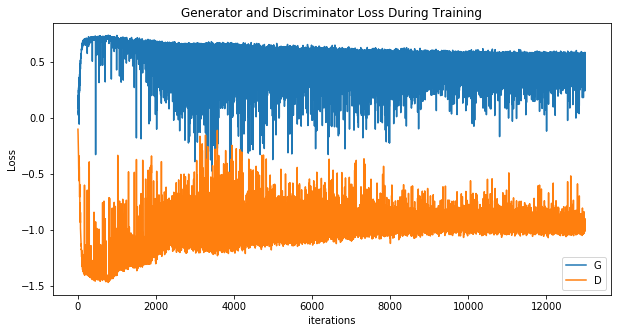

In [15]:
# Выводим на печать всяческие loss'ы
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

Animation size has reached 21112171 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


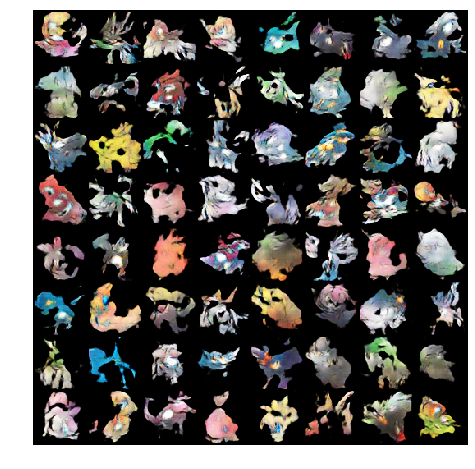

In [16]:
# Проигрываем результаты генерации для фиксированного шума
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

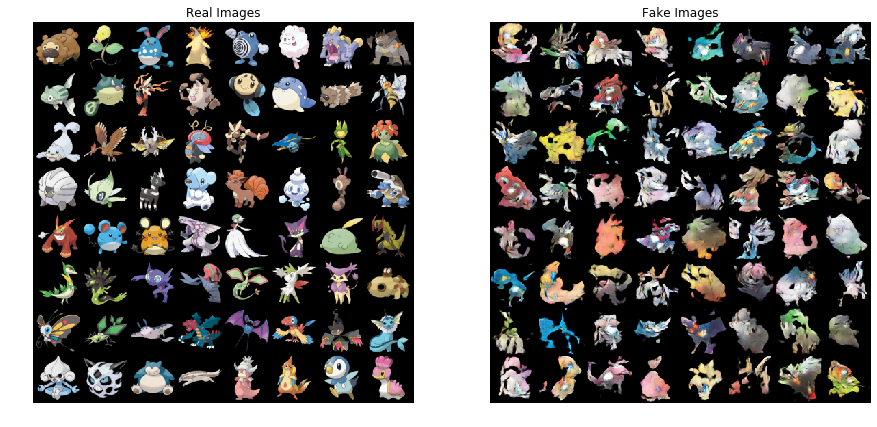

In [17]:
# Сравниваем настоящие данные и генерацию
real_batch = next(iter(dataloader))

# Рисуем трейнсет
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Рисуем фейки
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()